In [23]:
%matplotlib inline
import seaborn as sns
from IPython.display import SVG
import operator

import json,string,re,operator,sys,math, pandas as pd,vincent
from pprint import pprint
from collections import Counter
from nltk.corpus import stopwords
from nltk import bigrams,trigrams
from collections import defaultdict
import numpy as np
from matplotlib import pyplot as plt
# import matplotlib.pyplot as plt
import matplotlib as mpl

from os import path
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from datetime import datetime

from nltk.probability import FreqDist
from nltk.tokenize import word_tokenize
import plotly.express as px
import codecs

# functions Sections -
    ## some functions by Marco Bonzanini (https://marcobonzanini.com/2015/03/09/mining-twitter-data-with-python-part-2/)

In [20]:
emoticons_str = r"""
    (?:
        [:=;] # Eyes
        [oO\-]? # Nose (optional)
        [D\)\]\(\]/\\OpP] # Mouth
    )"""
 
regex_str = [
    emoticons_str,
    r'<[^>]+>', # HTML tags
    r'(?:@[\w_]+)', # @-mentions
    r"(?:\#+[\w_]+[\w\'_\-]*[\w_]+)", # hash-tags
    r'http[s]?://(?:[a-z]|[0-9]|[$-_@.&amp;+]|[!*\(\),]|(?:%[0-9a-f][0-9a-f]))+', # URLs
 
    r'(?:(?:\d+,?)+(?:\.?\d+)?)', # numbers
    r"(?:[a-z][a-z'\-_]+[a-z])", # words with - and '
    r'(?:[\w_]+)', # other words
    r'(?:\S)' # anything else
]
    
tokens_re = re.compile(r'('+'|'.join(regex_str)+')', re.VERBOSE | re.IGNORECASE)
emoticon_re = re.compile(r'^'+emoticons_str+'$', re.VERBOSE | re.IGNORECASE)
 
def tokenize(s):
    return tokens_re.findall(s)
 
def preprocess(s, lowercase=False):
    tokens = tokenize(s)
    if lowercase:
        tokens = [token if emoticon_re.search(token) else token.lower() for token in tokens]
    return tokens

def add_column_for_name(df, names_list, text_column):
    """
    Add column(s) that indicates whether name(s) is/are in text_column
    Args:
        df: pandas dataframe
        names_list: list of strings (names) 
        text_column: column containing text
    Returns:
        df with column of Booleans 
    """
    for name in names_list:
        df_data[name] = df_data['text'].apply(lambda tweet: word_in_text(name, tweet))
    return df

def remove_retweets(df, column, list_of_str):
    """
    Function to remove tweets that contain string in list_of_str
    """
    for string in list_of_str:
        df = df[df['text'].str.contains(string)==False]
    return df
    
def print_val_counts_for_True(df, list_of_cols):
    """
    Print number of Trues for columns in list_of_cols in dataframe df
    """
    for name in list_of_cols:
        try:
            print(name, df[name].value_counts()[True])
        except:
            continue

def word_in_text(word, text):
    """
    Function to make text lower case and return True if a term is present, False otherwise
    """
    word = word.lower()
    text = text.lower()
    match = re.search(word, text)
    if match:
        return True
    return False

def lower_text(list_text):
    """
    Make text lowercase
    """
    new_list_text = []
    for word in list_text:
        new_word = word.lower()
        new_list_text.append(new_word)
    return new_list_text

def extract_link(text):
    """
    Extracting links from tweets
    """
    regex = r'https?://[^\s<>"]+|www\.[^\s<>"]+'
    match = re.search(regex, text)
    if match:
        return match.group()
    return ''

# Functions for tokenizing and preprocessing

def tokenize(s):
    return tokens_re.findall(s)

def preprocess(s, lowercase = False):
    tokens = tokenize(s)
    if lowercase:
        tokens = [token if emoticon_re.search(token) else token.lower() for token in tokens]
    return tokens

def tweet_tokenize(text):
    """
    Tokenize text
    """
    tweet_tokens = preprocess(text, lowercase = False)
    return tweet_tokens

def itertools_flatten(list_of_list):
    """
    Flatten out list of lists
    """
    from itertools import chain
    return list(chain(*list_of_list))

def most_frequent(terms_all, names_list):
    """
    Returns most frequent terms, aside from stop words. terms_all is a list with all the terms
    """
    count_all = Counter()
    full_stop = stop + names_list
    interesting_terms = [term for term in terms_all if term not in full_stop]

    # Update the counter
    count_all.update(interesting_terms)
    return count_all.most_common(20)
    
def make_col_lowercase(df, list_of_cols):
    """
    Function to get lowercase of columns in list_of_cols
    Args:
        df: pandas dataframe
        list_of_cols: list of column names (string)
    """
    for string in list_of_cols:
        df['lower_'+ string] = df[string].apply(lambda tweet: lower_text(tweet))
    return df

def is_json(my_json):
    try:
        json.loads(my_json)
    except ValueError as e:
        return False
    return True

# view top 5 tweets and selected features then break

In [24]:
br = 0
with open('./dataset/stream_Anambra.json', 'r') as f:
    for line in f:
        if br == 5:
            break
        tweet = json.loads(line)
#        print(json.dumps(tweet, indent=4))                         # pretty-print
        print(tweet['id'],tweet['user']['name'],tweet['user']['location'],tweet['user']['created_at'],
              tweet['created_at'],' '.join(preprocess(tweet['text'])))
        br += 1

930056843525246976 Oluwatomiwa Lagos, Nigeria Tue Nov 23 15:56:42 +0000 2010 Sat Nov 18 09:19:00 +0000 2017 #AnambraDecides2017 Anambra will fare bether under OSELOKA but instead of APC . . . I would rather prefer we remain with OBIANO . . . the devil I know is bether than the angel with dubious character . Anambra will never toe the path of Imo state . TUFIAKWA .
931856843525555576 Oluwatomiwa Lagos, Nigeria Tue Nov 23 15:56:42 +0000 2010 Sat Nov 18 06:13:00 +0000 2017 At the visit of @MBuhari to Ebonyi , Elechi , former Governor of Ebonyi decamped to APC from PDP Also in Anambra State , the son of Odumegwu , the founder of APGA dumped APGA for APC Baba Buhari please visit all States
931856855525246976 Oluwatomiwa Lagos, Nigeria Tue Nov 23 15:56:42 +0000 2010 Sat Nov 18 07:15:00 +0000 2017 #AnambraDecides2017 Anambra people pls go out and vote for Obaze Oseloka PDP . If you refuse to vote the election will be manipulated against you . #PDPGSFFOROBAZE Vote and Stay to ensure your votes

# filter the selected tweet features and write csv file

In [25]:
# g = codecs.open('./dataset/filtered_attributes_stream_Anambra.csv', 'w',encoding='utf-8',errors='ignore')
# with codecs.open('./dataset/stream_Anambra.json','r',encoding='utf-8',errors='ignore') as f:
#     for line in f:
#         if is_json(line) == True:
#             tweet = json.loads(line,strict=False)
            
#         tweet_id = tweet.get('id','None')
#         tweet_date = tweet.get('created_at','None')
#         query_string = 'anambra'
#         tweet_user = tweet.get('user','None')
        
#         if tweet_user != None:
#             try:
#                 loc = tweet_user['location']
#                 user = tweet_user['name']
#             except:
#                 loc = None
#                 user = None
                
#             g.write('{0}\t{1}\t{2}\t{3}\t{4}\t{5}\n'.format(tweet_id,tweet_date,query_string,loc,user, 
#                                                         ' '.join(preprocess(tweet.get('text','None')))))
#         else:
            
#             loc = None
#             user = None
            
#             g.write('{0}\t{1}\t{2}\t{3}\t{4}\t{5}\n'.format(tweet_id,tweet_date,query_string,loc,user, 
#                                                         ' '.join(preprocess(tweet.get('text','None')))))
            
# g.close()


# convert twitter data to dataframe

In [27]:
cols = ['id','date','query_string','location','user','text']
df_data = pd.read_csv("./dataset/filtered_attributes_stream_Anambra.csv",header=None, names=cols,sep='\t')
df_data.head(20)

,id,date,query_string,location,user,text
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ..."
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...
5,931856843525888876,Sat Nov 18 11:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 APC and Apga agents seen l...
6,931856844445246976,Sat Nov 18 11:16:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,They have started sharing money to voters in A...
7,931859999525246976,Sat Nov 18 11:23:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"Anambra election : APC , APGA agents paying 2,..."
8,931856843525211116,Sat Nov 18 11:10:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,Vote and write your name in order to collect m...
9,931856843534436976,Sat Nov 18 09:20:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraElectionBoycott with #AnambraDecides20...


In [30]:
df_data['text'].describe() #percentile, mean and std of the numerical values of the Series or DataFrame

count                                                 33512
unique                                                10738
top       RT @Amaka_Ekwo : 18 NOV 2017 - #SitAtHome in A...
freq                                                   1117
Name: text, dtype: object

In [31]:
df_data['text'][3] #access tweet on position ['text'] column and row #03

"I'm rooting for you osita chidoka today as #AnambraDecides . You ran a superb , issues-based campaign and I wish you all the best today . Your success is Anambra's gain ."

# Adding columns that show whether the tweet contains a name of interest:

### add columns of Booleans that indicated whether a name was in the tweet or not.

In [32]:
names_list = ['obiano','willie','obiano willie','willie obiano','willieobiano','obianowillie',
              'obaze','oseloka','obaze oseloka','oseloka obaze','oselokaobaze','obazeoseloka',
              'nwoye','tony','nwoye tony','tony nwoye','tonynwoye','nwoyetony',
              'ezeemo','godwin','godwin ezeemo','ezeemo godwin','ezeemogodwin','godwinezeemo',
              'chidoka','osita','chidoka osita','osita chidoka','ositachidoka','chidokaosita',
              'apga','pdp','apc','ppa','udp']
add_column_for_name(df_data, names_list,'text')

,id,date,query_string,location,user,text,obiano,willie,obiano willie,willie obiano,...,osita,chidoka osita,osita chidoka,ositachidoka,chidokaosita,apga,pdp,apc,ppa,udp
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,True,False,False,False,...,False,False,False,False,False,False,False,True,False,False
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",False,False,False,False,...,False,False,False,False,False,True,True,True,False,False
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,True,False,True,False,False,False,False,False,False,False
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33507,932021321252220928,Sat Nov 18 23:02:53 +0000 2017,anambra,None,Gozie Chukwu,RT @gozie_chukwu : @mfpcrules @OrientalTimes @...,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
33508,932021326239485952,Sat Nov 18 23:02:54 +0000 2017,anambra,biafra land,Melody King,RT @mfpcrules : #Biafrans do not vote in Anamb...,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
33509,932021345700929536,Sat Nov 18 23:02:59 +0000 2017,anambra,None,Gozie Chukwu,RT @gozie_chukwu : @Amaka_Ekwo @UN @_AfricanUn...,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
33510,932021357809930242,Sat Nov 18 23:03:02 +0000 2017,anambra,None,Ifeanyi Chukwu,RT @Ebuka_Mbanefo : Anambra Election : IPOB th...,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


# filter for rows that satisfy given condition - E.g.
    ## tweets where any of these 'obiano','willie','obiano willie','willie obiano','willieobiano','obianowillie'  
    ## are mentioned will return true.
    

In [35]:
df_data['willie_obiano'] = df_data['obiano']|df_data['willie']|df_data['obiano willie']|df_data['willie obiano']|df_data['willieobiano']|df_data['obianowillie']
df_data['oseloka_obaze'] = df_data['obaze'] | df_data['oseloka'] | df_data['obaze oseloka'] | df_data['oseloka obaze'] | df_data['oselokaobaze'] | df_data['obazeoseloka']
df_data['nwoye_tony'] = df_data['nwoye'] | df_data['tony'] | df_data['nwoye tony'] | df_data['tony nwoye'] | df_data['tonynwoye'] | df_data['nwoyetony']
df_data['godwin_ezeemo'] = df_data['ezeemo'] | df_data['godwin'] | df_data['godwin ezeemo'] | df_data['ezeemo godwin'] | df_data['ezeemogodwin'] | df_data['godwinezeemo']
df_data['osita_chidoka'] = df_data['chidoka'] | df_data['osita'] | df_data['chidoka osita'] | df_data['osita chidoka'] | df_data['ositachidoka'] | df_data['chidokaosita']

df_data['willie_obiano_apga'] = df_data['obiano']|df_data['willie']|df_data['obiano willie']|df_data['willie obiano']|df_data['willieobiano']|df_data['obianowillie']|df_data['apga']
df_data['oseloka_obaze_pdp'] = df_data['obaze'] | df_data['oseloka'] | df_data['obaze oseloka'] | df_data['oseloka obaze'] | df_data['oselokaobaze'] | df_data['obazeoseloka']|df_data['pdp']
df_data['nwoye_tony_apc'] = df_data['nwoye'] | df_data['tony'] | df_data['nwoye tony'] | df_data['tony nwoye'] | df_data['tonynwoye'] | df_data['nwoyetony']|df_data['apc']
df_data['godwin_ezeemo_ppa'] = df_data['ezeemo'] | df_data['godwin'] | df_data['godwin ezeemo'] | df_data['ezeemo godwin'] | df_data['ezeemogodwin'] | df_data['godwinezeemo']|df_data['ppa']
df_data['osita_chidoka_udp'] = df_data['chidoka'] | df_data['osita'] | df_data['chidoka osita'] | df_data['osita chidoka'] | df_data['ositachidoka'] | df_data['chidokaosita']|df_data['udp']

In [36]:
df_data.head()

,id,date,query_string,location,user,text,obiano,willie,obiano willie,willie obiano,...,willie_obiano,oseloka_obaze,nwoye_tony,godwin_ezeemo,osita_chidoka,willie_obiano_apga,oseloka_obaze_pdp,nwoye_tony_apc,godwin_ezeemo_ppa,osita_chidoka_udp
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,True,False,False,False,...,True,True,False,False,False,True,True,True,False,False
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",False,False,False,False,...,False,False,False,False,False,True,True,True,False,False
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,False,False,False,...,False,True,False,False,False,False,True,False,False,False
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,False,False,False,False,True,False,False,False,False,True
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,False,False,False,...,False,False,False,False,False,False,True,False,False,False


# Count number of Trues for columns in list_of_cols

In [37]:
list_of_cols = ['obiano','willie','obiano willie','willie obiano','willieobiano','obianowillie',
              'obaze','oseloka','obaze oseloka','oseloka obaze','oselokaobaze','obazeoseloka',
              'nwoye','tony','nwoye tony','tony nwoye','tonynwoye','nwoyetony',
              'ezeemo','godwin','godwin ezeemo','ezeemo godwin','ezeemogodwin','godwinezeemo',
              'chidoka','osita','chidoka osita','osita chidoka','ositachidoka','chidokaosita', 
               'willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka',
               'apga','pdp','apc','ppa','udp','willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc',
                'godwin_ezeemo_ppa','osita_chidoka_udp']
print_val_counts_for_True(df_data, list_of_cols)


obiano 1037
willie 224
willie obiano 131
willieobiano 1
obaze 229
oseloka 136
obaze oseloka 11
oseloka obaze 79
nwoye 483
tony 363
tony nwoye 237
ezeemo 116
godwin 13
godwin ezeemo 11
chidoka 249
osita 123
osita chidoka 27
willie_obiano 1057
oseloka_obaze 251
nwoye_tony 602
godwin_ezeemo 118
osita_chidoka 278
apga 1733
pdp 1138
apc 1986
ppa 94
udp 2
willie_obiano_apga 2549
oseloka_obaze_pdp 1263
nwoye_tony_apc 2470
godwin_ezeemo_ppa 160
osita_chidoka_udp 280


In [39]:
df_data.shape

(33512, 51)

# Some cleanup: removing retweets:

In [40]:
# Return df with duplicates removed. By default this keeps the first occurrence only.
unique_tweets = df_data.drop_duplicates(inplace=False, subset='text')

len(unique_tweets)

10738

In [41]:
unique_tweets = unique_tweets.drop(['obiano','willie','obiano willie','willie obiano','willieobiano','obianowillie',
              'obaze','oseloka','obaze oseloka','oseloka obaze','oselokaobaze','obazeoseloka',
              'nwoye','tony','nwoye tony','tony nwoye','tonynwoye','nwoyetony',
              'ezeemo','godwin','godwin ezeemo','ezeemo godwin','ezeemogodwin','godwinezeemo',
              'chidoka','osita','chidoka osita','osita chidoka','ositachidoka','chidokaosita'], axis=1)

In [42]:
# Remove retweets
list_of_str = ['RT', 'rt', ' RT ']
originals = remove_retweets(unique_tweets, 'text', list_of_str)
originals = originals.reset_index(drop = True)

In [43]:
wov = []
for v in originals.willie_obiano:
    if v == True:
        wov.append(1)
    else: wov.append(0)

oov = []
for v in originals.oseloka_obaze:
    if v == True:
        oov.append(1)
    else: oov.append(0)

ntv = []
for v in originals.nwoye_tony:
    if v == True:
        ntv.append(1)
    else: ntv.append(0)

gev = []
for v in originals.godwin_ezeemo:
    if v == True:
        gev.append(1)
    else: gev.append(0)

ocv = []
for v in originals.osita_chidoka:
    if v == True:
        ocv.append(1)
    else: ocv.append(0)

In [44]:
originals['wov'] = wov
originals['oov'] = oov
originals['ntv'] = ntv
originals['gev'] = gev
originals['ocv'] = ocv

In [45]:
originals.head()

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,willie_obiano_apga,oseloka_obaze_pdp,nwoye_tony_apc,godwin_ezeemo_ppa,osita_chidoka_udp,wov,oov,ntv,gev,ocv
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,True,True,True,False,False,1,1,0,0,0
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,True,True,True,False,False,0,0,0,0,0
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,False,True,False,False,False,0,1,0,0,0
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,False,False,False,False,True,0,0,0,0,1
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,False,True,False,False,False,0,0,0,0,0


In [46]:
originals.shape

(7438, 26)

# some exploratory analysis

# Counting names:

In [47]:
# Count number of Trues for columns in list_of_cols
list_of_cols = ['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka',
               'apga','pdp','apc','ppa','udp','willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc',
                'godwin_ezeemo_ppa','osita_chidoka_udp']
print_val_counts_for_True(originals, list_of_cols)

willie_obiano 536
oseloka_obaze 149
nwoye_tony 235
godwin_ezeemo 77
osita_chidoka 119
apga 672
pdp 416
apc 399
ppa 39
udp 2
willie_obiano_apga 1084
oseloka_obaze_pdp 494
nwoye_tony_apc 582
godwin_ezeemo_ppa 92
osita_chidoka_udp 121


# Extract links:

##### Note: I added columns that indicated whether the tweet contained only one name and not the others (for example, just “obiano” and not “willie” or “obaeze” or “ezeemo”) as well as columns that indicated whether a name was present or not, regardless of whether other names were there.

In [48]:
originals['link'] = originals['text'].apply(extract_link)

In [49]:
# Getting value counts for names
list_of_cols = ['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka',
               'apga','pdp','apc','ppa','udp','willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc',
                'godwin_ezeemo_ppa','osita_chidoka_udp']
print_val_counts_for_True(originals, list_of_cols)

willie_obiano 536
oseloka_obaze 149
nwoye_tony 235
godwin_ezeemo 77
osita_chidoka 119
apga 672
pdp 416
apc 399
ppa 39
udp 2
willie_obiano_apga 1084
oseloka_obaze_pdp 494
nwoye_tony_apc 582
godwin_ezeemo_ppa 92
osita_chidoka_udp 121


# A plot for counts for names of interest:

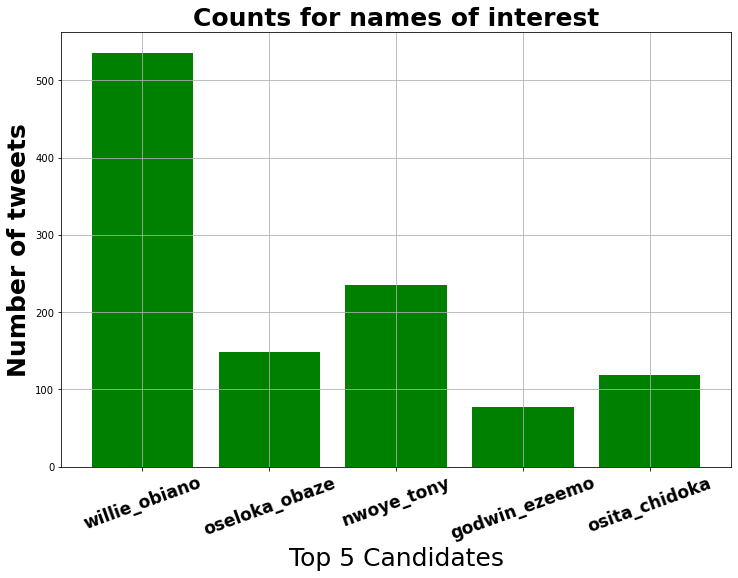

In [50]:
names = ['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka']
tweets_by_name = [originals['willie_obiano'].value_counts()[True], 
                  originals['oseloka_obaze'].value_counts()[True], 
                  originals['nwoye_tony'].value_counts()[True], 
                  originals['godwin_ezeemo'].value_counts()[True],
                  originals['osita_chidoka'].value_counts()[True]]
x_pos = list(range(len(names)))
width = 0.8
fig, ax = plt.subplots(figsize=(12, 8))
plt.bar(x_pos, tweets_by_name, width, alpha=1, color='g')
ax.set_ylabel('Number of tweets', fontsize=25, fontweight='bold')
ax.set_title('Counts for names of interest', fontsize=25, fontweight='bold')
ax.set_xticks([p + 0.0 * width for p in x_pos])
ax.set_xticklabels(names,fontsize=17,fontweight='bold',rotation=20)
ax.set_xlabel('Top 5 Candidates',fontsize=25)
plt.grid()
plt.savefig('./computed_images/tweet_by_name_1', format='png')

# A plot on the parties of interest

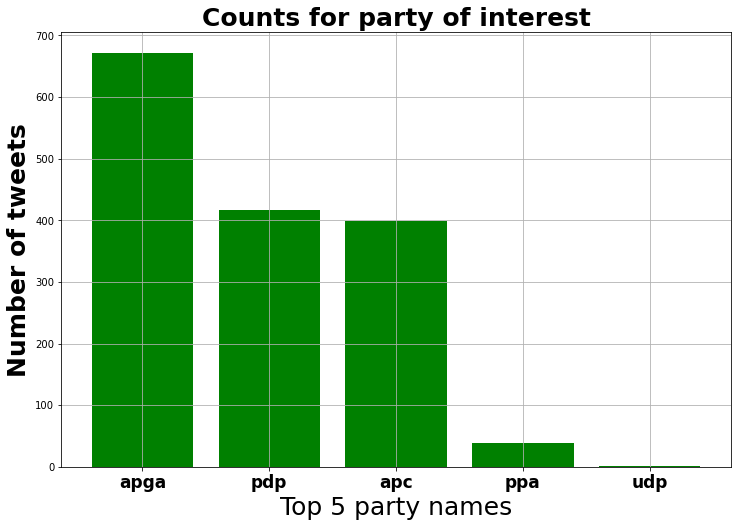

In [51]:
names = ['apga','pdp','apc','ppa','udp']
tweets_by_name = [originals['apga'].value_counts()[True], 
                  originals['pdp'].value_counts()[True], 
                  originals['apc'].value_counts()[True], 
                  originals['ppa'].value_counts()[True],
                  originals['udp'].value_counts()[True]]
x_pos = list(range(len(names)))
width = 0.8
fig, ax = plt.subplots(figsize=(12, 8))
plt.bar(x_pos, tweets_by_name, width, alpha=1, color='g')
ax.set_ylabel('Number of tweets', fontsize=25, fontweight='bold')
ax.set_title('Counts for party of interest', fontsize=25, fontweight='bold')
ax.set_xticks([p + 0.0 * width for p in x_pos])
ax.set_xticklabels(names,fontsize=17,fontweight='bold',rotation=0)
ax.set_xlabel('Top 5 party names',fontsize=25)
plt.grid()
plt.savefig('./computed_images/tweet_by_party_1', format='png')

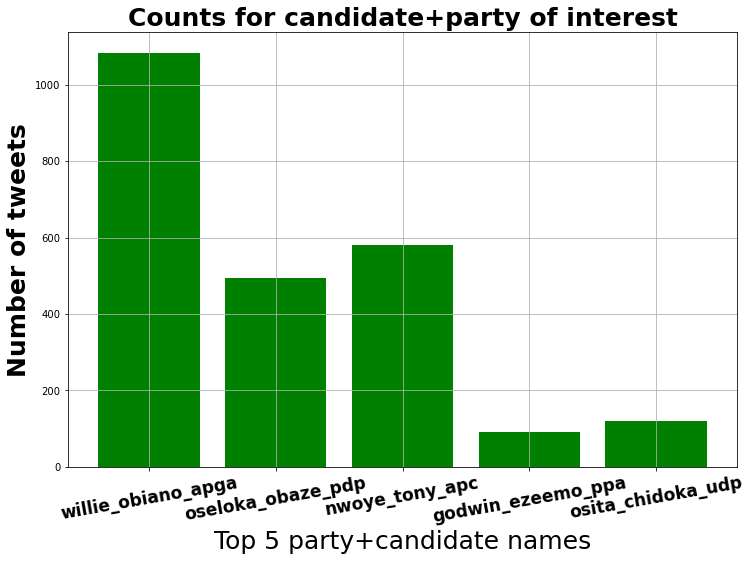

In [52]:
names = ['willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc','godwin_ezeemo_ppa','osita_chidoka_udp']
tweets_by_name = [originals['willie_obiano_apga'].value_counts()[True], 
                  originals['oseloka_obaze_pdp'].value_counts()[True], 
                  originals['nwoye_tony_apc'].value_counts()[True], 
                  originals['godwin_ezeemo_ppa'].value_counts()[True],
                  originals['osita_chidoka_udp'].value_counts()[True]]
x_pos = list(range(len(names)))
width = 0.8
fig, ax = plt.subplots(figsize=(12, 8))
plt.bar(x_pos, tweets_by_name, width, alpha=1, color='g')
ax.set_ylabel('Number of tweets', fontsize=25, fontweight='bold')
ax.set_title('Counts for candidate+party of interest', fontsize=25, fontweight='bold')
ax.set_xticks([p + 0.0 * width for p in x_pos])
ax.set_xticklabels(names,fontsize=17,fontweight='bold',rotation=10)
ax.set_xlabel('Top 5 party+candidate names', fontsize=25)
plt.grid()
plt.savefig('./computed_images/tweet_by_party_451', format='png')

# Tweets by locations

In [54]:
# names = list(originals['location'][:10])
# tweets_by_loc_counts = originals['location'].value_counts() #get the counts for the lang column
# x_pos = list(range(len(names)))
# width = 0.8
# fig, ax = plt.subplots(figsize=(15, 10))
# plt.bar(x_pos, tweets_by_loc_counts[:10], width, alpha=1, color='g')
# ax.set_ylabel('Number of tweets', fontsize=15)
# ax.set_title('Counts for names of interest', fontsize=15, fontweight='bold')
# ax.set_xticks([p + 0.4 * width for p in x_pos])
# ax.set_xticklabels(names)
# plt.grid()
# plt.savefig('./computed_images/tweet_by_loc_1', format='png')

## Adding columns for tokens for cal Most frequent words associated with candidates

In [28]:
# Add column of tokenized tweets
originals['tweet_tokens'] = originals['text'].apply(lambda tweet: tweet_tokenize(tweet))


In [29]:
originals['tweet_tokens'].head()

0    [#AnambraDecides2017, Anambra, will, fare, bet...
1    [At, the, visit, of, @MBuhari, to, Ebonyi, ,, ...
2    [#AnambraDecides2017, Anambra, people, pls, go...
3    [I'm, rooting, for, you, osita, chidoka, today...
4    [#AnambraDecides2017, Today, is, Anambra, Gube...
Name: tweet_tokens, dtype: object

# only contestants names

In [30]:
# Adding a column for the tokens and also selecting for just the English ones
originals['just_obiano_tokens'] = np.where((originals['willie_obiano'] ==True),originals['tweet_tokens'], '')
originals['just_obaze_tokens'] = np.where((originals['oseloka_obaze'] ==True), originals['tweet_tokens'], '')
originals['just_nwoye_tokens'] = np.where((originals['nwoye_tony'] ==True), originals['tweet_tokens'], '')
originals['just_ezeemo_tokens'] = np.where((originals['godwin_ezeemo'] ==True), originals['tweet_tokens'], '')
originals['just_chidoka_tokens'] = np.where((originals['osita_chidoka'] ==True), originals['tweet_tokens'], '')

In [31]:
text_obiano = " ".join(" ".join(t) for t in originals.just_obiano_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_obiano)))

text_obaze = " ".join(" ".join(t) for t in originals.just_obaze_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_obaze)))

text_nwoye = " ".join(" ".join(t) for t in originals.just_nwoye_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_nwoye)))

text_ezeemo = " ".join(" ".join(t) for t in originals.just_ezeemo_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_ezeemo)))

text_chidioka = " ".join(" ".join(t) for t in originals.just_chidoka_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_chidioka)))

There are 69012 words in the combination of all tweets.
There are 25102 words in the combination of all tweets.
There are 35885 words in the combination of all tweets.
There are 16239 words in the combination of all tweets.
There are 21428 words in the combination of all tweets.


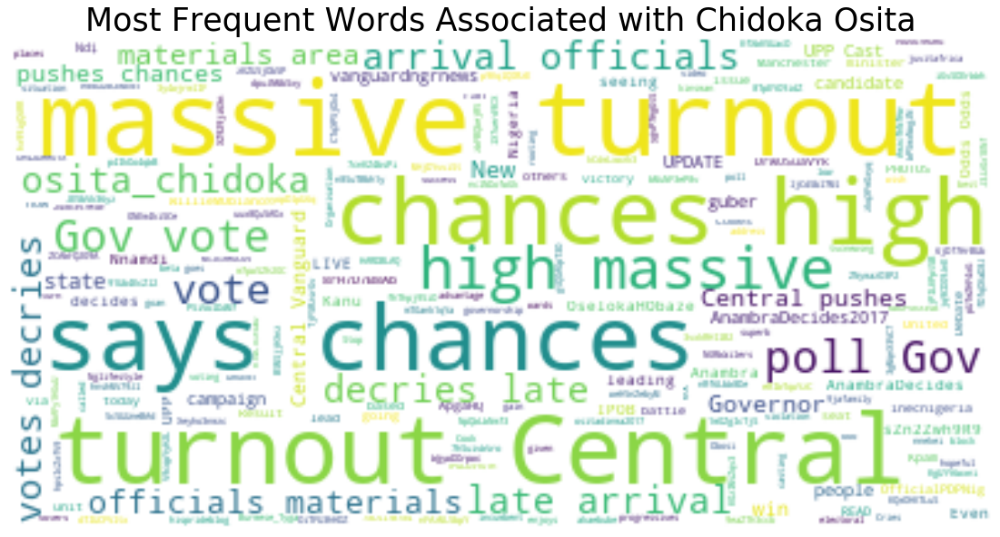

In [32]:
stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text_chidioka)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# contestants names plus party name

In [33]:
# Adding a column for the tokens and also selecting for just the English ones
originals['obiano_apga_tokens'] = np.where((originals['willie_obiano_apga'] ==True),originals['tweet_tokens'], '')
originals['obaze_pdp_tokens'] = np.where((originals['oseloka_obaze_pdp'] ==True), originals['tweet_tokens'], '')
originals['nwoye_apc_tokens'] = np.where((originals['nwoye_tony_apc'] ==True), originals['tweet_tokens'], '')
originals['ezeemo_ppa_tokens'] = np.where((originals['godwin_ezeemo_ppa'] ==True), originals['tweet_tokens'], '')
originals['chidoka_udp_tokens'] = np.where((originals['osita_chidoka_udp'] ==True), originals['tweet_tokens'], '')

In [34]:
text_obiano_apga = " ".join(" ".join(t) for t in originals.obiano_apga_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_obiano_apga)))

text_obaze_pdp = " ".join(" ".join(t) for t in originals.obaze_pdp_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_obaze_pdp)))

text_nwoye_apc = " ".join(" ".join(t) for t in originals.nwoye_apc_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_nwoye_apc)))

text_ezeemo_ppa = " ".join(" ".join(t) for t in originals.ezeemo_ppa_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_ezeemo_ppa)))

text_chidoka_udp = " ".join(" ".join(t) for t in originals.chidoka_udp_tokens)
print ("There are {} words in the combination of all tweets.".format(len(text_chidoka_udp)))

There are 129440 words in the combination of all tweets.
There are 64203 words in the combination of all tweets.
There are 75799 words in the combination of all tweets.
There are 18146 words in the combination of all tweets.
There are 21658 words in the combination of all tweets.


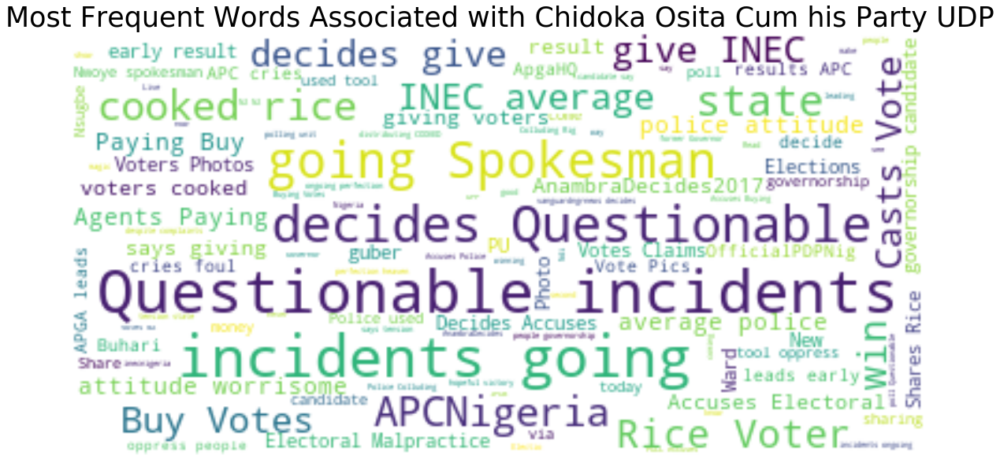

In [35]:
stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text_nwoye_apc)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Part 2- Sentiment Analysis of Tweets

In [1]:
%matplotlib inline 
import chart_studio.plotly as py
import plotly.tools as tls
#from ggplot import *

import nltk
from nltk import word_tokenize
from sklearn.model_selection import train_test_split
from nltk.classify.scikitlearn import SklearnClassifier
from sklearn.naive_bayes import MultinomialNB, BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
import sys
# sys.path.append('../MLRecipes')
#import ml_helper as mlhelp
import pickle
import random
from textblob import TextBlob

from nltk.corpus import sentiwordnet as swn
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet as wn
from nltk import sent_tokenize, word_tokenize, pos_tag

from nltk.sentiment.vader import SentimentIntensityAnalyzer

# TextBlob

In [37]:
def find_pol(text):  
    return TextBlob(text).sentiment.polarity

def clean_tweet2(tweet):
    '''
    Utility function to clean the text in a tweet by removing 
    links and special characters using regex.
    '''
    return ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)", " ", tweet).split())

def analize_sentiment(tweet):
    '''
    Utility function to classify the polarity of a tweet
    using textblob.
    '''
    analysis = TextBlob(clean_tweet(tweet))
    if analysis.sentiment.polarity > 0:
        return 1
    elif analysis.sentiment.polarity == 0:
        return 0
    else:
        return -1

In [38]:
def find_subj(text):
    return TextBlob(text).sentiment.subjectivity

In [39]:
#del originals['Sentiment_polarity']
#del originals['Sentiment_subjectivity']

In [40]:
originals['Sentiment_Polarity'] = originals['text'].apply(find_pol)

In [41]:
originals['Sentiment_Subjectivity'] = originals['text'].apply(find_subj)

In [42]:
senti_vals = []
subj_vals = []
for text in originals.text:
    if TextBlob(text).sentiment.polarity > 0:
        senti_vals.append(2)
    elif TextBlob(text).sentiment.polarity < 0:
        senti_vals.append(1)
    else:
        senti_vals.append(0)
    
    if TextBlob(text).sentiment.subjectivity > 0:
        subj_vals.append(2)
    else:
        subj_vals.append(0)

In [43]:
originals['Sentiment_Polarity_Vals'] = senti_vals

In [44]:
originals['Sentiment_Subjectivity_Vals'] = subj_vals

# sentiwordnet as swn

In [45]:
lemmatizer = WordNetLemmatizer()
 
def penn_to_wn(tag):
    """
    Convert between the PennTreebank tags to simple Wordnet tags
    """
    if tag.startswith('J'):
        return wn.ADJ
    elif tag.startswith('N'):
        return wn.NOUN
    elif tag.startswith('R'):
        return wn.ADV
    elif tag.startswith('V'):
        return wn.VERB
    return None
 
def clean_text(text):
    text = text.replace("<br />", " ")
#     text = text.decode("utf-8")
 
    return text
 
def swn_polarity(text):
    """
    Return a sentiment polarity: 0 = negative, 1 = positive
    """
 
    sentiment = 0.0
    tokens_count = 0
 
    text = clean_text(text)
 
 
    raw_sentences = sent_tokenize(text)
    for raw_sentence in raw_sentences:
        tagged_sentence = pos_tag(word_tokenize(raw_sentence))
        
#         print(tagged_sentence)
        
        for word, tag in tagged_sentence:
            wn_tag = penn_to_wn(tag)
            if wn_tag not in (wn.NOUN, wn.ADJ, wn.ADV):
                continue
 
            lemma = lemmatizer.lemmatize(word, pos=wn_tag)
            if not lemma:
                continue
 
            synsets = wn.synsets(lemma, pos=wn_tag)
            if not synsets:
                continue
 
            # Take the first sense, the most common
            synset = synsets[0]
            swn_synset = swn.senti_synset(synset.name())
 
            sentiment += swn_synset.pos_score() - swn_synset.neg_score()
            tokens_count += 1
        
#         return sentiment
 
    # judgment call ? Default to positive or negative
    if not tokens_count:
        return 0,sentiment
 
    # sum greater than 0 => positive sentiment
    if sentiment > 0:
        return 2,sentiment
    
    if sentiment == 0:
        return 0,sentiment
 
    # negative sentiment
    return 1,sentiment

In [46]:
print(swn_polarity('#WeJustHeard Anambra election : Drama as corps members demand feeding allowance before work'))

(0, 0.0)


In [47]:
# Since we're shuffling, you'll get diffrent results
senti_vals_wordnet = []
tweetlist = originals['text']
for tweet in tweetlist:
    sc = swn_polarity(tweet)
    
    senti_vals_wordnet.append(sc)

In [48]:
sc,pol = zip(*senti_vals_wordnet)

In [49]:
len(sc)

7438

In [50]:
originals['sc_sentiwordnet'] = sc
originals['pol_sentiwordnet'] = pol

In [51]:
originals.head()

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,obaze_pdp_tokens,nwoye_apc_tokens,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,"[#AnambraDecides2017, Anambra, will, fare, bet...","[#AnambraDecides2017, Anambra, will, fare, bet...",,,0.000000,0.000000,0,0,1,-1.000
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,"[At, the, visit, of, @MBuhari, to, Ebonyi, ,, ...","[At, the, visit, of, @MBuhari, to, Ebonyi, ,, ...",,,0.000000,0.000000,0,0,1,-0.250
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,"[#AnambraDecides2017, Anambra, people, pls, go...",,,,0.000000,0.000000,0,0,2,0.375
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,,,,"[I'm, rooting, for, you, osita, chidoka, today...",0.766667,0.433333,2,2,2,1.125
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,"[#AnambraDecides2017, Today, is, Anambra, Gube...",,,,0.187500,0.437500,2,2,2,0.375


In [53]:
get_vader_score('Anambra guber poll records impressive turnout https://t.co/ZZnfe2Kd0R')

(2, 0.5106)

In [54]:
senti_vals_vader = []
for tweet in tweetlist:
    sc = get_vader_score(tweet)
    
    senti_vals_vader.append(sc)

In [55]:
vsc,vpol = zip(*senti_vals_vader)

In [56]:
originals['sc_sentivader'] = vsc
originals['pol_sentivader'] = vpol

In [57]:
originals.head()

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,,,0.000000,0.000000,0,0,1,-1.000,1,-0.8847
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,,,0.000000,0.000000,0,0,1,-0.250,1,-0.1027
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,,,0.000000,0.000000,0,0,2,0.375,1,-0.2263
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,,"[I'm, rooting, for, you, osita, chidoka, today...",0.766667,0.433333,2,2,2,1.125,2,0.9590
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,,,0.187500,0.437500,2,2,2,0.375,2,0.3400


In [58]:
tblob_neu = (originals[originals['Sentiment_Polarity_Vals'] == 0].shape[0]/originals.shape[0])*100
tblob_neg = (originals[originals['Sentiment_Polarity_Vals'] == 1].shape[0]/originals.shape[0])*100
tblob_pos = (originals[originals['Sentiment_Polarity_Vals'] == 2].shape[0]/originals.shape[0])*100

print('tblob neu: ', originals[originals['Sentiment_Polarity_Vals'] == 0].shape[0],tblob_neu)
print('tblob neg: ', originals[originals['Sentiment_Polarity_Vals'] == 1].shape[0],tblob_neg)
print('tblob pos: ', originals[originals['Sentiment_Polarity_Vals'] == 2].shape[0],tblob_pos)

tblob neu:  3977 53.46867437483195
tblob neg:  1012 13.605808012906696
tblob pos:  2449 32.92551761226136


In [59]:
sentiwordnet_neu = (originals[originals['sc_sentiwordnet'] == 0].shape[0]/originals.shape[0])*100
sentiwordnet_neg = (originals[originals['sc_sentiwordnet'] == 1].shape[0]/originals.shape[0])*100
sentiwordnet_pos = (originals[originals['sc_sentiwordnet'] == 2].shape[0]/originals.shape[0])*100

print('sentiwordnet neu: ', originals[originals['sc_sentiwordnet'] == 0].shape[0],sentiwordnet_neu)
print('sentiwordnet neg: ', originals[originals['sc_sentiwordnet'] == 1].shape[0],sentiwordnet_neg)
print('sentiwordnet pos: ', originals[originals['sc_sentiwordnet'] == 2].shape[0],sentiwordnet_pos)

sentiwordnet neu:  3085 41.476203280451735
sentiwordnet neg:  1431 19.23904275342834
sentiwordnet pos:  2922 39.28475396611992


In [60]:
sentivader_neu = (originals[originals['sc_sentivader'] == 0].shape[0]/originals.shape[0])*100
sentivader_neg = (originals[originals['sc_sentivader'] == 1].shape[0]/originals.shape[0])*100
sentivader_pos = (originals[originals['sc_sentivader'] == 2].shape[0]/originals.shape[0])*100

print('sentivader neu: ', originals[originals['sc_sentivader'] == 0].shape[0],sentivader_neu)
print('sentivader neg: ', originals[originals['sc_sentivader'] == 1].shape[0],sentivader_neg)
print('sentivader pos: ', originals[originals['sc_sentivader'] == 2].shape[0],sentivader_pos)

sentivader neu:  2834 38.101640225867165
sentivader neg:  2256 30.330734068297932
sentivader pos:  2348 31.5676257058349


Text(0.5, 1.0, 'Positive and Negative Tweets on the Candidates')

<BarContainer object of 3 artists>

<BarContainer object of 3 artists>

[Text(0, 0, 'Positive'), Text(0, 0, 'Negative'), Text(0, 0, 'Neutral')]

Text(0.5, 0, 'Sentiments labels')

Text(0, 0.5, 'No of tweets with sentiments')

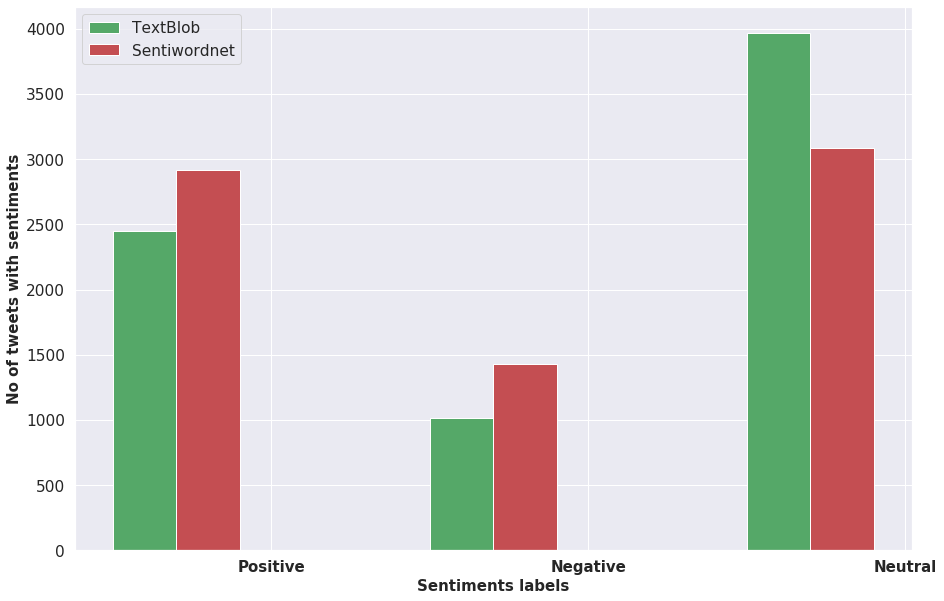

In [297]:
x=['Positive','Negative','Neutral']
ind=np.arange(len(x))
tb = [2447,1012,3971]
sw = [2916,1429,3085]
# vd = [2346,2252,2832]

fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Positive and Negative Tweets on the Candidates", fontsize=12, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.4, tb, width=.2, color='g', align='center', label='TextBlob')
ax.bar(ind-.2, sw, width=.2, color='r', align='center', label='Sentiwordnet')
# ax.bar(ind, vd, width=.2, color='m', align='center', label='Vader')

# ax.set_xticks([p + 0.0 * width for p in ind])
ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=15,fontweight='bold',rotation=0)
ax.set_xlabel('Sentiments labels', fontsize=15, fontweight='bold')
ax.set_ylabel('No of tweets with sentiments', fontsize=15, fontweight='bold')
ax.legend(loc='best')

In [62]:
# from senti_classifier import senti_classifier
# sentences = ['The movie was the worst movie', 'It was the worst acting by the actors']
# pos_score, neg_score = senti_classifier.polarity_scores(sentences)
# print(pos_score, neg_score)

In [63]:
# from watson_developer_cloud import NaturalLanguageUnderstandingV1
# from watson_developer_cloud.natural_language_understanding_v1 \ import Features, EntitiesOptions, KeywordsOptions, SentimentOptions, CategoriesOptionsnatural_language_understanding = NaturalLanguageUnderstandingV1(                                         
#     version='2018-11-16',
#     iam_apikey='{API key}’, # Use your API key here
#     url='{url}’ # paste the url here
#     )
# def Sentiment_score(input_text): 
#     # Input text can be sentence, paragraph or document
#     response = natural_language_understanding.analyze (
#     text = input_text,
#     features = Features(sentiment=SentimentOptions())).get_result()
#     # From the response extract score which is between -1 to 1
#     res = response.get('sentiment').get('document').get('score')
#     return res

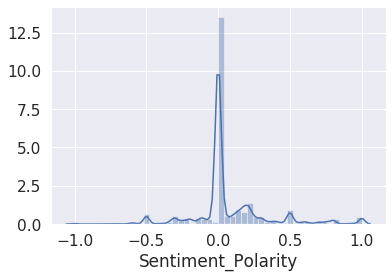

In [299]:
sns.distplot(originals['Sentiment_Polarity'])

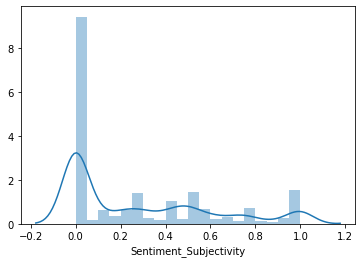

In [65]:
sns.distplot(originals['Sentiment_Subjectivity'])

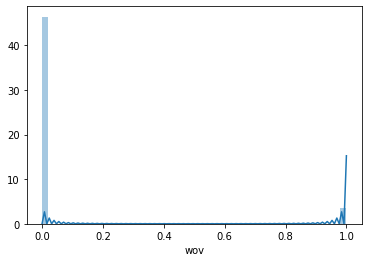

In [66]:
sns.distplot(originals['wov'])

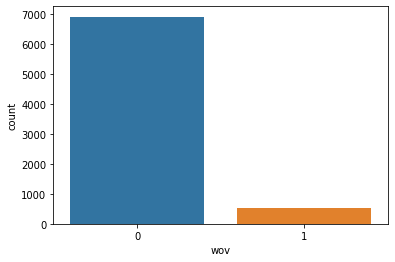

In [67]:
sns.countplot(x='wov', data=originals)

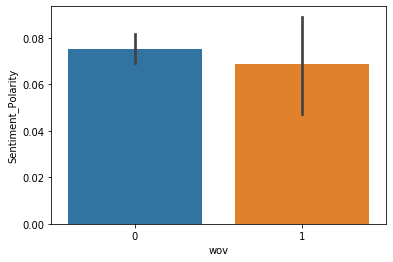

In [68]:
sns.barplot(x='wov', y='Sentiment_Polarity', data=originals)  

# about negatives

In [69]:
most_negative = originals[originals.Sentiment_Polarity == -1].text.head()
all_most_negative = originals[originals.Sentiment_Polarity == -1].text

In [70]:
most_negative

164     BIAFRA : ANAMBRA ELECTION UPDATE : OGBARU APC ...
173     BIAFRA : ANAMBRA ELECTION UPDATE : OGBARU APC ...
839     #ipob this #ipob that , why is no news media c...
1466    @ipobworldnews : BIAFRA : ANAMBRA ELECTION UPD...
1840    @Canicols Bloody liar 🤥 ! Election 🗳 is going ...
Name: text, dtype: object

In [71]:
len(all_most_negative)

11

In [72]:
originals['text'][831]

'Funny things r unfolding . . . https://t.co/zBvmTt89K7'

In [73]:
originals['Sentiment_Polarity'][831]

0.25

In [74]:
negatives = originals[originals.Sentiment_Polarity < 0].text.head()
all_negatives = originals[originals.Sentiment_Polarity < 0].text

In [75]:
negatives

18    Apc is allegedly sharing food and money 💰 to v...
23    Anambra Election : Corp members fail to work w...
33    UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE...
52    Video update of #AnambraElectionBoycott As Ana...
53    Yup . Thank God for little mercies . https://t...
Name: text, dtype: object

In [76]:
len(all_negatives)

1012

In [77]:
originals['text'][14]

'Anambra election litmus test for INEC , APC says PDP https://t.co/d7MdyHMO1k #AnambraDecides2017 #RHHC #SaturdayMorningCruise #ARSTOT Libya'

In [78]:
originals['Sentiment_Polarity'][10]

0.0

# about positives

In [79]:
most_positive = originals[originals.Sentiment_Polarity == 1].text.head()
all_most_positive = originals[originals.Sentiment_Polarity == 1].text

In [80]:
most_positive

365    Anambra guber poll records impressive turnout ...
590    Anambra : Impressive turnout of voters https:/...
682    Anambra guber poll records impressive turnout ...
698    Anambra guber poll records impressive turnout ...
712    Anambra guber poll records impressive turnout ...
Name: text, dtype: object

In [81]:
len(all_most_positive)

142

In [82]:
all_most_positive

365     Anambra guber poll records impressive turnout ...
590     Anambra : Impressive turnout of voters https:/...
682     Anambra guber poll records impressive turnout ...
698     Anambra guber poll records impressive turnout ...
712     Anambra guber poll records impressive turnout ...
                              ...                        
6489    I am proud of the Anambra people ! My prayer i...
6526    God bless these senior citizens for still beli...
6686                        LOL ! https://t.co/VQgOKofiaE
7053    When a nauseating PMB went to Anambra to campa...
7329    Anambra guber poll records impressive turnout ...
Name: text, Length: 142, dtype: object

In [83]:
# all_most_positive[7321]

In [84]:
originals['text'][359]

'ANAMBRA ELECETION UPDATE : Low Turn Out As Accreditation Of Voters Resumes In Ekwusigo LG https://t.co/BiLxwHwzwi https://t.co/zyikSREys2'

In [85]:
originals['Sentiment_Polarity'][359]

0.0

In [86]:
positives = originals[originals.Sentiment_Polarity > 0].text.head()
all_positives = originals[originals.Sentiment_Polarity > 0].text

In [87]:
positives

3     I'm rooting for you osita chidoka today as #An...
4     #AnambraDecides2017 Today is Anambra Gubernato...
9     Osumoghu Ihiala , Anambra , BIAFRA . Biafrans ...
12    @Breakingpost_ng How many re they there ? How ...
13    #hisprideblog Large Turnout as Anambra Voters ...
Name: text, dtype: object

In [88]:
len(all_positives)

2449

In [89]:
originals['text'][1]

'At the visit of @MBuhari to Ebonyi , Elechi , former Governor of Ebonyi decamped to APC from PDP Also in Anambra State , the son of Odumegwu , the founder of APGA dumped APGA for APC Baba Buhari please visit all States'

In [90]:
originals['Sentiment_Polarity'][1]

0.0

# all neutrals

In [91]:
neutrals = originals[originals.Sentiment_Polarity == 0].text.head() 
all_neutrals = originals[originals.Sentiment_Polarity == 0].text

In [92]:
neutrals

0    #AnambraDecides2017 Anambra will fare bether u...
1    At the visit of @MBuhari to Ebonyi , Elechi , ...
2    #AnambraDecides2017 Anambra people pls go out ...
5    #AnambraDecides2017 APC and Apga agents seen l...
6    Anambra election : APC , APGA agents paying 2,...
Name: text, dtype: object

In [93]:
len(all_neutrals)

3977

In [94]:
originals['text'][0]

'#AnambraDecides2017 Anambra will fare bether under OSELOKA but instead of APC . . . I would rather prefer we remain with OBIANO . . . the devil I know is bether than the angel with dubious character . Anambra will never toe the path of Imo state . TUFIAKWA .'

In [95]:
originals['Sentiment_Polarity'][0]

0.0

# about subjectivity

In [96]:
subjectives = originals[originals.Sentiment_Subjectivity > 0].text.head()
all_subjectives = originals[originals.Sentiment_Subjectivity > 0].text 

In [97]:
subjectives

3     I'm rooting for you osita chidoka today as #An...
4     #AnambraDecides2017 Today is Anambra Gubernato...
8     this thing they say they are doing in Anambra ...
9     Osumoghu Ihiala , Anambra , BIAFRA . Biafrans ...
12    @Breakingpost_ng How many re they there ? How ...
Name: text, dtype: object

In [98]:
len(all_subjectives)

3934

In [99]:
originals['text'][1]

'At the visit of @MBuhari to Ebonyi , Elechi , former Governor of Ebonyi decamped to APC from PDP Also in Anambra State , the son of Odumegwu , the founder of APGA dumped APGA for APC Baba Buhari please visit all States'

In [100]:
originals['Sentiment_Subjectivity'][0]

0.0

In [101]:
non_subjectives = originals[originals.Sentiment_Subjectivity == 0].text.head()  
all_non_subjectives = originals[originals.Sentiment_Subjectivity == 0].text 

In [102]:
non_subjectives

0    #AnambraDecides2017 Anambra will fare bether u...
1    At the visit of @MBuhari to Ebonyi , Elechi , ...
2    #AnambraDecides2017 Anambra people pls go out ...
5    #AnambraDecides2017 APC and Apga agents seen l...
6    Anambra election : APC , APGA agents paying 2,...
Name: text, dtype: object

In [103]:
len(all_non_subjectives)

3504

In [104]:
originals['text'][2]

'#AnambraDecides2017 Anambra people pls go out and vote for Obaze Oseloka PDP . If you refuse to vote the election will be manipulated against you . #PDPGSFFOROBAZE Vote and Stay to ensure your votes count'

In [105]:
originals['Sentiment_Subjectivity'][2]

0.0

# Counts for names of interest in the positve tweets

In [106]:
pos_df = originals[originals.Sentiment_Polarity_Vals == 2]
pos_df.head(10)

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,,"[I'm, rooting, for, you, osita, chidoka, today...",0.766667,0.433333,2,2,2,1.125,2,0.9590
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,,,0.187500,0.437500,2,2,2,0.375,2,0.3400
9,931856900764897280,Sat Nov 18 12:09:32 +0000 2017,anambra,Biafra,Biafra My Home,"Osumoghu Ihiala , Anambra , BIAFRA . Biafrans ...",False,False,False,False,...,,,0.400000,0.800000,2,2,1,-0.250,1,-0.4577
12,931856960269537280,Sat Nov 18 12:09:47 +0000 2017,anambra,None,Chinedu Onyeka,@Breakingpost_ng How many re they there ? How ...,False,False,False,False,...,,,0.416667,0.400000,2,2,2,0.625,1,-0.3060
13,931856960978325504,Sat Nov 18 12:09:47 +0000 2017,anambra,Nigeria,Hisprideblog,#hisprideblog Large Turnout as Anambra Voters ...,False,False,False,False,...,,,0.214286,0.428571,2,2,0,0.000,1,-0.4215
17,931857130348535808,Sat Nov 18 12:10:27 +0000 2017,anambra,None,Uwem Inyang,Good luck to Anambra peeps . May the best man ...,False,False,False,False,...,,,0.500000,0.479167,2,2,2,1.125,2,0.9686
38,931857343658319872,Sat Nov 18 12:11:18 +0000 2017,anambra,Owerri(FUTO),Chukwuemeka Igbokwe,Large Turnout as Anambra Voters Defy IPOB Thre...,False,False,False,False,...,,,0.214286,0.428571,2,2,2,0.125,1,-0.4215
43,931857536923394049,Sat Nov 18 12:12:04 +0000 2017,anambra,"Lagos,Nigeria 🇳🇬",Nikki Patricia,@julietkego @obyezeks I'm proud of Anambra rig...,False,False,False,False,...,,,0.466071,0.678571,2,2,2,0.625,2,0.8832
44,931857580175093760,Sat Nov 18 12:12:14 +0000 2017,anambra,"Ibadan, Nigeria",Nwachukwu Egbunike,Who is Ojukwu's son ? Even Emeka Odimegwu Ojuk...,False,False,False,False,...,,,0.800000,0.400000,2,2,1,-0.500,1,-0.4717
54,931857908027002881,Sat Nov 18 12:13:33 +0000 2017,anambra,emmanuelokogba@vanguardngr.com,Okogba Emmanuel,Anambra Election : Deputy Gov Nkem Okeke votes...,False,False,False,False,...,,,0.500000,0.500000,2,2,2,0.250,0,0.0000


# Counts for names of interest in the negatives tweets

In [107]:
neg_df = originals[originals.Sentiment_Polarity_Vals == 1]
neg_df.head(10)

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
18,931857140326846464,Sat Nov 18 12:10:29 +0000 2017,anambra,None,Obinna,Apc is allegedly sharing food and money 💰 to v...,False,False,True,False,...,,,-0.200000,0.322222,1,2,2,0.625,1,-0.1027
23,931857260753702912,Sat Nov 18 12:10:58 +0000 2017,anambra,Nigeria,9jaherald,Anambra Election : Corp members fail to work w...,False,False,False,False,...,,,-0.500000,0.300000,1,2,0,0.000,1,-0.5423
33,931857325371068416,Sat Nov 18 12:11:14 +0000 2017,anambra,None,Chilobe,UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE...,True,False,False,False,...,,,-0.150000,0.250000,1,2,2,0.125,1,-0.8833
52,931857829715173376,Sat Nov 18 12:13:14 +0000 2017,anambra,UAE,prince iyke prince,Video update of #AnambraElectionBoycott As Ana...,False,False,False,False,...,,,-0.155556,0.288889,1,2,1,-0.625,1,-0.4939
53,931857863722618880,Sat Nov 18 12:13:22 +0000 2017,anambra,None,"It is I, LeClerc",Yup . Thank God for little mercies . https://t...,False,False,False,False,...,,,-0.187500,0.500000,1,2,1,-0.375,2,0.5574
68,931858160972840960,Sat Nov 18 12:14:33 +0000 2017,anambra,"Lagos, Nigeria",Smash9ja_Ents,Anambra Election : Youths Use Voter ’ s Card t...,False,False,False,False,...,,,-0.600000,1.000000,1,2,1,-0.125,0,0.0000
75,931858296851529733,Sat Nov 18 12:15:05 +0000 2017,anambra,"Abuja, Nigeria",Markson,Niger Bridge Blocked Due To Anambra Election (...,False,False,False,False,...,,,-0.125000,0.375000,1,2,2,0.375,1,-0.2732
82,931858473628913665,Sat Nov 18 12:15:47 +0000 2017,anambra,None,Abdul-Salam Tukur,Bett y @inecnigeria ? Haba mana . . . Seriousl...,False,False,False,False,...,,,-0.333333,0.666667,1,2,2,0.250,2,0.3818
83,931858520823169025,Sat Nov 18 12:15:59 +0000 2017,anambra,Lagos,Chinex Obue,"When will this nonsense stop , how long are we...",False,False,False,False,...,,,-0.050000,0.400000,1,2,2,0.375,1,-0.4263
87,931858694836547584,Sat Nov 18 12:16:40 +0000 2017,anambra,World-Wide,BlogMallNigeria.Com,10 Things To Know About Anambra Election - The...,False,False,False,False,...,,,-0.178571,0.285714,1,2,0,0.000,0,0.0000


# Counts for names of interest in the neutral tweets

In [108]:
neu_df = originals[originals.Sentiment_Polarity_Vals == 0]
neu_df.head(10)

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,,,0.0,0.0,0,0,1,-1.000,1,-0.8847
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,,,0.0,0.0,0,0,1,-0.250,1,-0.1027
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,,,0.0,0.0,0,0,2,0.375,1,-0.2263
5,931856843525888876,Sat Nov 18 11:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 APC and Apga agents seen l...,True,False,True,False,...,,,0.0,0.0,0,0,2,0.750,1,-0.8316
6,931859999525246976,Sat Nov 18 11:23:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"Anambra election : APC , APGA agents paying 2,...",True,True,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000
7,931856843525211116,Sat Nov 18 11:10:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,Vote and write your name in order to collect m...,True,False,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000
8,931856843525246976,Sat Nov 18 12:09:19 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,this thing they say they are doing in Anambra ...,False,False,False,False,...,,,0.0,0.5,0,2,1,-0.875,2,0.4215
10,931856909191262208,Sat Nov 18 12:09:34 +0000 2017,anambra,Lagos,AKEWULA BELLO,Unlike GEJ era https://t.co/zgU4Id9WH9,False,False,False,False,...,,,0.0,0.0,0,0,0,0.000,0,0.0000
11,931856949154545664,Sat Nov 18 12:09:44 +0000 2017,anambra,None,GurusVevo,Anambra Election : “ Vote & amp ; Die ” Charms...,False,False,False,False,...,,,0.0,0.0,0,0,2,0.625,1,-0.2500
14,931857069434601472,Sat Nov 18 12:10:13 +0000 2017,anambra,Universe,Oscrape,"Anambra election litmus test for INEC , APC sa...",False,True,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000


# Multi plot of Positive and Positve Polarity of name of interest

Text(0.5, 1.0, 'Positive and Negative Tweets on the Candidates')

<BarContainer object of 5 artists>

<BarContainer object of 5 artists>

<BarContainer object of 5 artists>

[Text(0, 0, 'willie_obiano'),
 Text(0, 0, 'oseloka_obaze'),
 Text(0, 0, 'nwoye_tony'),
 Text(0, 0, 'godwin_ezeemo'),
 Text(0, 0, 'osita_chidoka')]

Text(0, 0.5, 'Number of Tweets')

Text(0.5, 0, 'Top 5 Candidates')

<Figure size 432x288 with 0 Axes>

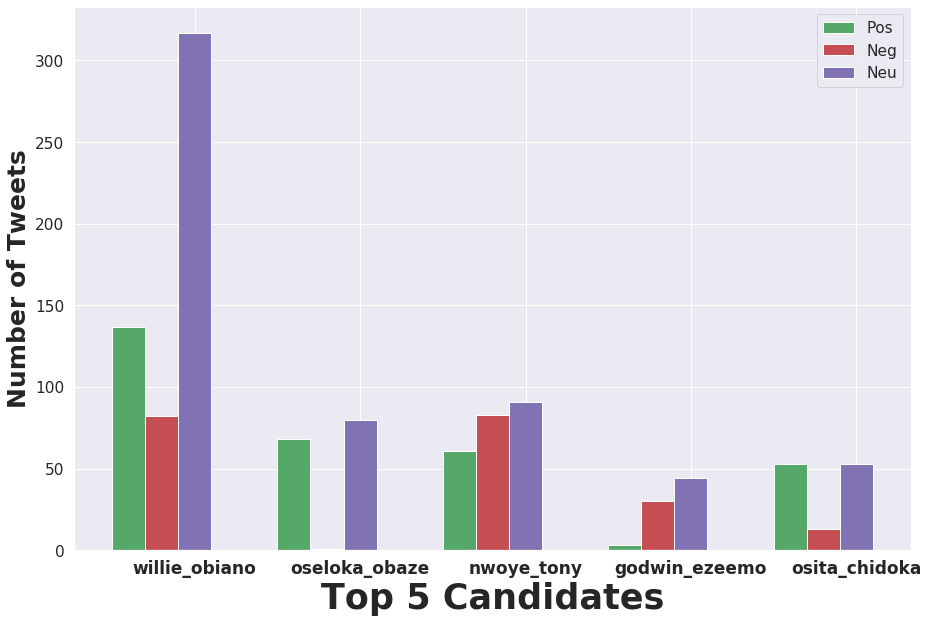

In [300]:
multiple_bars=plt.figure()
tweets_by_name_pos = [pos_df['willie_obiano'].value_counts()[True],
                  pos_df['oseloka_obaze'].value_counts()[True],
                  pos_df['nwoye_tony'].value_counts()[True],
                  pos_df['godwin_ezeemo'].value_counts()[True],
                  pos_df['osita_chidoka'].value_counts()[True]]

tweets_by_name_neg = [neg_df['willie_obiano'].value_counts()[True],
                  neg_df['oseloka_obaze'].value_counts()[True],
                  neg_df['nwoye_tony'].value_counts()[True],
                  neg_df['godwin_ezeemo'].value_counts()[True],
                  neg_df['osita_chidoka'].value_counts()[True]]

tweets_by_name_neu = [neu_df['willie_obiano'].value_counts()[True],
                  neu_df['oseloka_obaze'].value_counts()[True],
                  neu_df['nwoye_tony'].value_counts()[True],
                  neu_df['godwin_ezeemo'].value_counts()[True],
                  neu_df['osita_chidoka'].value_counts()[True]]

x=['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka']
ind=np.arange(len(x))
pos = tweets_by_name_pos
neg = tweets_by_name_neg
neu = tweets_by_name_neu

fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Positive and Negative Tweets on the Candidates", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.4, pos, width=.2, color='g', align='center', label='Pos')
ax.bar(ind-.2, neg, width=.2, color='r', align='center', label='Neg')
ax.bar(ind, neu, width=.2, color='m', align='center', label='Neu')

# ax.set_xticks([p + 0.0 * width for p in ind])
ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=17,fontweight='bold',rotation=0)
ax.set_ylabel('Number of Tweets', fontsize=25, fontweight='bold')
ax.set_xlabel('Top 5 Candidates', fontsize=35, fontweight='bold')
ax.legend(loc='best')

<Figure size 432x288 with 0 Axes>

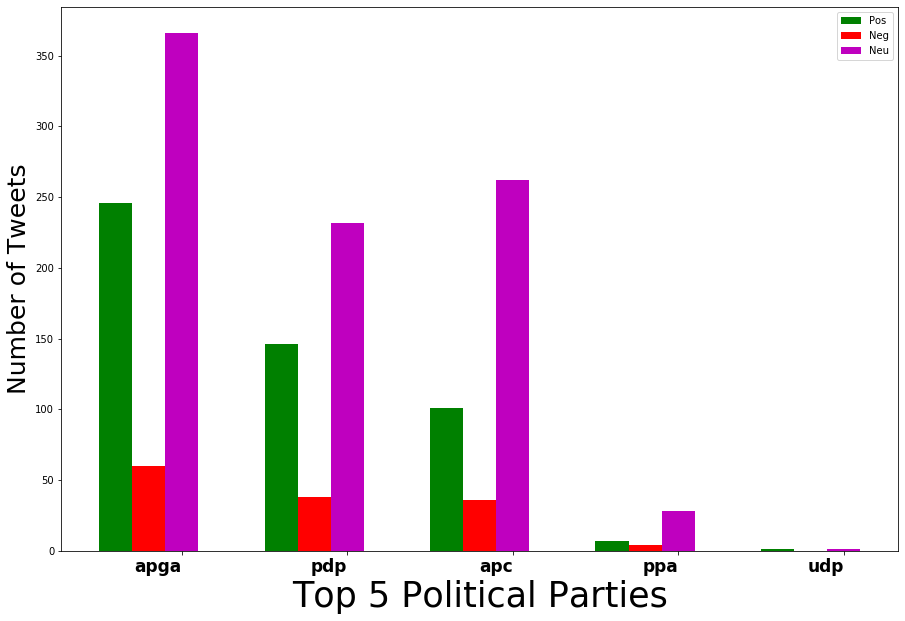

In [110]:
multiple_bars=plt.figure()

tweets_by_name_pos = [pos_df['apga'].value_counts()[True], 
                  pos_df['pdp'].value_counts()[True], 
                  pos_df['apc'].value_counts()[True], 
                  pos_df['ppa'].value_counts()[True],
                  pos_df['udp'].value_counts()[True]]

tweets_by_name_neg = [neg_df['apga'].value_counts()[True], 
                  neg_df['pdp'].value_counts()[True], 
                  neg_df['apc'].value_counts()[True], 
                  neg_df['ppa'].value_counts()[True],
                  0]

tweets_by_name_neu = [neu_df['apga'].value_counts()[True], 
                  neu_df['pdp'].value_counts()[True], 
                  neu_df['apc'].value_counts()[True], 
                  neu_df['ppa'].value_counts()[True],
                  neu_df['udp'].value_counts()[True]]

x = ['apga','pdp','apc','ppa','udp']
ind = np.arange(len(x))
pos = tweets_by_name_pos
neg = tweets_by_name_neg
neu = tweets_by_name_neu

fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Positive, Neutral and Negative Tweets on the Political Parties", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.4, pos, width=.2, color='g', align='center', label='Pos')
ax.bar(ind-.2, neg, width=.2, color='r', align='center', label='Neg')
ax.bar(ind, neu, width=.2, color='m', align='center', label='Neu')

ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=17,fontweight='bold',rotation=0,ha='right')
ax.set_ylabel('Number of Tweets', fontsize=25)
ax.set_xlabel('Top 5 Political Parties', fontsize=35)
ax.legend(loc='best')

<Figure size 432x288 with 0 Axes>

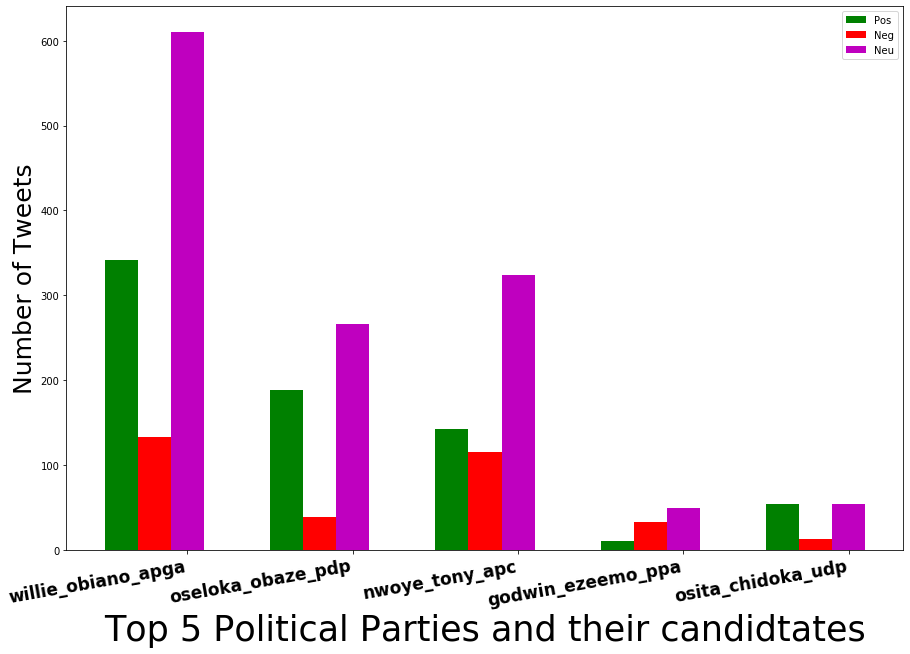

In [111]:
multiple_bars=plt.figure()

tweets_by_name_pos = [pos_df['willie_obiano_apga'].value_counts()[True], 
                  pos_df['oseloka_obaze_pdp'].value_counts()[True], 
                  pos_df['nwoye_tony_apc'].value_counts()[True], 
                  pos_df['godwin_ezeemo_ppa'].value_counts()[True],
                  pos_df['osita_chidoka_udp'].value_counts()[True]]

tweets_by_name_neg = [neg_df['willie_obiano_apga'].value_counts()[True], 
                  neg_df['oseloka_obaze_pdp'].value_counts()[True], 
                  neg_df['nwoye_tony_apc'].value_counts()[True], 
                  neg_df['godwin_ezeemo_ppa'].value_counts()[True],
                  neg_df['osita_chidoka_udp'].value_counts()[True]]

tweets_by_name_neu = [neu_df['willie_obiano_apga'].value_counts()[True], 
                  neu_df['oseloka_obaze_pdp'].value_counts()[True], 
                  neu_df['nwoye_tony_apc'].value_counts()[True], 
                  neu_df['godwin_ezeemo_ppa'].value_counts()[True],
                  neu_df['osita_chidoka_udp'].value_counts()[True]]

x = ['willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc','godwin_ezeemo_ppa','osita_chidoka_udp']
ind = np.arange(len(x))
pos = tweets_by_name_pos
neg = tweets_by_name_neg
neu = tweets_by_name_neu

width = 0.8
fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Positive and Negative Tweets on the Political Parties and their candidates", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.4, pos, width=.2, color='g', align='center', label='Pos')
ax.bar(ind-.2, neg, width=.2, color='r', align='center', label='Neg')
ax.bar(ind, neu, width=.2, color='m', align='center', label='Neu')

ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=17,fontweight='bold',rotation=10,ha='right')
ax.set_ylabel('Number of Tweets', fontsize=25)
ax.set_xlabel('Top 5 Political Parties and their candidtates', fontsize=35)
ax.legend(loc='best')

# Counts for names of interest in the subjectivity tweets

In [112]:
subj_df = originals[originals.Sentiment_Subjectivity_Vals == 2]
subj_df.head(10)

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,,"[I'm, rooting, for, you, osita, chidoka, today...",0.766667,0.433333,2,2,2,1.125,2,0.9590
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,,,0.187500,0.437500,2,2,2,0.375,2,0.3400
8,931856843525246976,Sat Nov 18 12:09:19 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,this thing they say they are doing in Anambra ...,False,False,False,False,...,,,0.000000,0.500000,0,2,1,-0.875,2,0.4215
9,931856900764897280,Sat Nov 18 12:09:32 +0000 2017,anambra,Biafra,Biafra My Home,"Osumoghu Ihiala , Anambra , BIAFRA . Biafrans ...",False,False,False,False,...,,,0.400000,0.800000,2,2,1,-0.250,1,-0.4577
12,931856960269537280,Sat Nov 18 12:09:47 +0000 2017,anambra,None,Chinedu Onyeka,@Breakingpost_ng How many re they there ? How ...,False,False,False,False,...,,,0.416667,0.400000,2,2,2,0.625,1,-0.3060
13,931856960978325504,Sat Nov 18 12:09:47 +0000 2017,anambra,Nigeria,Hisprideblog,#hisprideblog Large Turnout as Anambra Voters ...,False,False,False,False,...,,,0.214286,0.428571,2,2,0,0.000,1,-0.4215
16,931857127441870849,Sat Nov 18 12:10:26 +0000 2017,anambra,On Twitter.,der Großvater,"Hydrocephalus . . likely . "" @nairaland : 7 - ...",False,False,False,False,...,,,0.000000,1.000000,0,2,1,-0.750,1,-0.4588
17,931857130348535808,Sat Nov 18 12:10:27 +0000 2017,anambra,None,Uwem Inyang,Good luck to Anambra peeps . May the best man ...,False,False,False,False,...,,,0.500000,0.479167,2,2,2,1.125,2,0.9686
18,931857140326846464,Sat Nov 18 12:10:29 +0000 2017,anambra,None,Obinna,Apc is allegedly sharing food and money 💰 to v...,False,False,True,False,...,,,-0.200000,0.322222,1,2,2,0.625,1,-0.1027
19,931857146102403073,Sat Nov 18 12:10:31 +0000 2017,anambra,In Your Daddy's Heart,YOUR DADDY's MAIN CHIC,Political tradefare https://t.co/0ORGRFBiDS,False,False,False,False,...,,,0.000000,0.100000,0,2,0,0.000,0,0.0000


# Counts for names of interest in the non subjectivity tweets

In [113]:
non_subj_df = originals[originals.Sentiment_Subjectivity_Vals == 0]
non_subj_df.head(10)

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,ezeemo_ppa_tokens,chidoka_udp_tokens,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,,,0.0,0.0,0,0,1,-1.000,1,-0.8847
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,,,0.0,0.0,0,0,1,-0.250,1,-0.1027
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,,,0.0,0.0,0,0,2,0.375,1,-0.2263
5,931856843525888876,Sat Nov 18 11:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 APC and Apga agents seen l...,True,False,True,False,...,,,0.0,0.0,0,0,2,0.750,1,-0.8316
6,931859999525246976,Sat Nov 18 11:23:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"Anambra election : APC , APGA agents paying 2,...",True,True,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000
7,931856843525211116,Sat Nov 18 11:10:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,Vote and write your name in order to collect m...,True,False,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000
10,931856909191262208,Sat Nov 18 12:09:34 +0000 2017,anambra,Lagos,AKEWULA BELLO,Unlike GEJ era https://t.co/zgU4Id9WH9,False,False,False,False,...,,,0.0,0.0,0,0,0,0.000,0,0.0000
11,931856949154545664,Sat Nov 18 12:09:44 +0000 2017,anambra,None,GurusVevo,Anambra Election : “ Vote & amp ; Die ” Charms...,False,False,False,False,...,,,0.0,0.0,0,0,2,0.625,1,-0.2500
14,931857069434601472,Sat Nov 18 12:10:13 +0000 2017,anambra,Universe,Oscrape,"Anambra election litmus test for INEC , APC sa...",False,True,True,False,...,,,0.0,0.0,0,0,2,0.125,0,0.0000
15,931857072077066241,Sat Nov 18 12:10:13 +0000 2017,anambra,"Abakaliki, Nigeria",Classiqmedia.com,@YulEdochie Please go out and vote your choice...,False,False,False,False,...,,,0.0,0.0,0,0,2,0.500,2,0.7430


In [114]:
for index, tweets in originals[originals['Sentiment_Subjectivity_Vals'] == 2].iterrows():
    print("  " +str(tweets[39]) + "  " + tweets[5])

  0.43333333333333335  I'm rooting for you osita chidoka today as #AnambraDecides . You ran a superb , issues-based campaign and I wish you all the best today . Your success is Anambra's gain .
  0.4375  #AnambraDecides2017 Today is Anambra Gubernatorial Election , one of the most anticipated elections in Nigeria and we call on @inecnigeria the @PoliceNG and other security agencies in the state to remain neutral . We urge Ndi Anambra to come out and vote . PDP . . . power to the people
  0.5  this thing they say they are doing in Anambra shey its Election they called it too ? the open sharing of rice the m … https://t.co/CgRV9ARd5T
  0.8  Osumoghu Ihiala , Anambra , BIAFRA . Biafrans didn't come out to vote . We are Biafrans and not Nigerians ! Free BIAFRA https://t.co/0TCaeP2nwB
  0.39999999999999997  @Breakingpost_ng How many re they there ? How many people re they giving the money ? Anambra people really boycotted the election !
  0.42857142857142855  #hisprideblog Large Turnout as 

  1.0  Anambra election : Impressive turnout of voters https://t.co/5jMvbSIJGG
  0.19166666666666665  While the whole world turn out every second , an invention we spend our last money on , the best coming from us is " J … https://t.co/POyqRtlzvx
  0.35  Lol change location to the opposite building . Everything still intact . https://t.co/vzXhu83Rzy
  0.5  Nawa ooo Recession also reach polling units in Anambra . . . . . Corpers waiting for voters while voters enjoy … https://t.co/OnjHDByFbB
  1.0  [ News Update ] Anambra election : Impressive turnout of voters https://t.co/Ku7u6occV7 | Visit https://t.co/dk4EIKeKKo for Safety Equipments
  0.2  [ News Update ] Anambra Election : IPOB thanks electorates for ‘ boycotting ’ governorship poll https://t.co/SaEkIRaAy1 … https://t.co/6LZypqAVUp
  1.0  Anambra guber poll records impressive turnout https://t.co/mpICOUi0fv
  0.125  @vanguardngrnews In the same paper https://t.co/A5TaHT5NKn
  1.0  Anambra election : Impressive turnout of voters ht

  0.3  REVEALED : Vote And Get A Plate Food , Money Sharing , Card Readers Failure , Electoral Irregularities , Among Others , T … https://t.co/u9dF869oBu
  0.3  NigeriaNewsdesk : Anambra guber : UPP , APGA laud INEC for early deployment of election materials … https://t.co/ZbLJHUgkOc
  0.5  Anambra governorship election 2017, Checkout unofficial results - More Trending Stories on https://t.co/lpaMGwB5ed
  1.0  Anambra decides : Questionable incidents going on in Anambra election – Nwoye ’ s Spokesman https://t.co/MKOwr2LyqR
  0.8333333333333334  Anambra 2017 : I'm Confident of a Landslide Victory - Obiano Says as He Votes https://t.co/uE4ZYb389k
  0.6  Anambra decides : Electoral materials arrive Ezeemo ’ s ward five hours late https://t.co/YhRiRmqiZz
  0.412962962962963  Thanks for all biafrans to make it happen Anambra Election is totally shut down biafra God blss you all this is tot … https://t.co/Pf7jiaiN1g
  0.75  Anambra Deicides : Chidoka impressed with peaceful exercise at his

  0.2  The results trickling in from Anambra align with my prediction . I'd thought APGA will win PDP will come second APC … https://t.co/tgmZzAMLDo
  0.06666666666666667  Anambra Election : Security Personnel Stranded At Nzam Since Last Night ( Photos ) https://t.co/dqm9GJnPTQ
  0.5  INEC Blames Corps Members For Delays In Anambra Election . . . . Click to read more https://t.co/Civm4kbxxC https://t.co/LEV1xM0gLo
  0.2  thanks to #biafrans for 89 % boycotting of anambra governorship election . . . may #chukwu okike abiama's name be praised .
  0.4  Anambra election : I will win , says Obiano https://t.co/Ya4ofryiRc
  0.42500000000000004  @NigeriaNewsdesk @YNaija Obiano has a GOOD chance to win the Anambra governorship election . A good number of people voted for him . He may smile
  0.13333333333333333  APGA will win , PDP will be second and APC third . You can take this to the Bank ! ! https://t.co/d3NOmRBIUA
  0.26666666666666666  If APC could win today's election in Anambra , then 

  0.375  The incumbent may have won , but Anambra State retrogressed greatly since the ex-governor Mr . Peter Obi left . The ne … https://t.co/BjCEvLuuWa
  0.21666666666666667  Political twitter go and rest . Anambra politics is beyond you all . It's not arm chair work , you must be on ground , hear and see first hand
  0.25  Looooooool . . . Nedu better make you go back to #Anambra decides . . . https://t.co/XHOkrRKgwa
  0.6428571428571428  Anambra election : Impressive turnout , tight security https://t.co/fMhBdQ1gBu https://t.co/cl0ADMHCcE
  0.6428571428571428  Anambra election : Impressive turnout , tight security https://t.co/OqLECH34gA via @thenewsnigeria #AnambraDecides2017
  0.625  ANAMBRA ELECTION LIVE RESULT DMGS Onitsha , Ward 3 total results , from the 3 polling Units APGA - 254, PDP - 102, A … https://t.co/NJCo5nE6Mx
  0.1  Gubernatorial elections are technical elections . Ndi Anambra , stay awake and see the organic emergence of APC victory
  0.15  Anambra Polls : Apga In

  0.5  Wonder why people are asking for results from Anambra when the winner is fucking obvious
  0.15000000000000002  Anambra election : Bianca Ojukwu celebrates victory in ward as APGA wins big ( See Result ) https://t.co/FeI8Le2er4
  0.5  Counting ongoing in most areas in Anambra governorship poll https://t.co/QUcSYcQQt5
  0.7083333333333334  Anambra Election : I ran hard , I'm confident of winning – Oseloka Obaze https://t.co/xVH2FeWPGU https://t.co/zkTuzWuwVN
  0.7083333333333334  Anambra Election : I ran hard , I'm confident of winning – Oseloka Obaze https://t.co/wyWCaLq5Rw https://t.co/mnCTGXlDAs
  0.7083333333333334  Anambra Election : I ran hard , I'm confident of winning – Oseloka Obaze https://t.co/u8WuCDbi6v https://t.co/C66eFusKjC
  1.0  BREAKING : Massive Jubilation ! ! ! Winner Of Anambra State Governorship Election Revealed , After Collation Of Polling … https://t.co/N5INy8NY7Q
  1.0  BREAKING : Massive Jubilation ! ! ! Winner Of Anambra State Governorship Election Rev

  0.1962962962962963  Anambra Election : Yul Edochie Denies Stepping Down , Threatens Legal Action https://t.co/Gfit8mOiAT https://t.co/EjGeVNl7L9
  0.2  Trouble maker of Africa . Don't let Lady professor to catch you . https://t.co/XmAqx6IQBE
  0.05  Anambra election : Gunmen appear at polling unit , voting material missing in Nnewi https://t.co/djEZyGtlaA https://t.co/9ldcRFEJo1
  1.0  Anambra election : INEC says it remains vigilant until final result is announced https://t.co/MBmFJGLxxT https://t.co/OEHmFL0Fef
  0.1962962962962963  Anambra Election : Yul Edochie Denies Stepping Down , Threatens Legal Action https://t.co/M5OG1bN6Ak Yungtosa
  0.8500000000000001  Anambra election was Free and it wasn't Fair @Omojuwa @adeyanjudeji @cchukudebelu
  0.5  Anambra Poll : Speaker Commends Peaceful Conduct https://t.co/zrAIz7L7cN https://t.co/7VPfiGmHKy
  0.7222222222222223  CLASSIC : See Inside The Elegant And Exquisite Palace Of A King In Anambra State ( Photos ) https://t.co/Kggg2pY0Z3 #B

Text(0.5, 1.0, 'Subjectivity and Non_Subjectivity Tweets on the candidates')

<BarContainer object of 5 artists>

<BarContainer object of 5 artists>

[Text(0, 0, 'willie_obiano'),
 Text(0, 0, 'oseloka_obaze'),
 Text(0, 0, 'nwoye_tony'),
 Text(0, 0, 'godwin_ezeemo'),
 Text(0, 0, 'osita_chidoka')]

Text(0, 0.5, 'Number of Tweets')

Text(0.5, 0, 'Top 5 candidtates')

<Figure size 432x288 with 0 Axes>

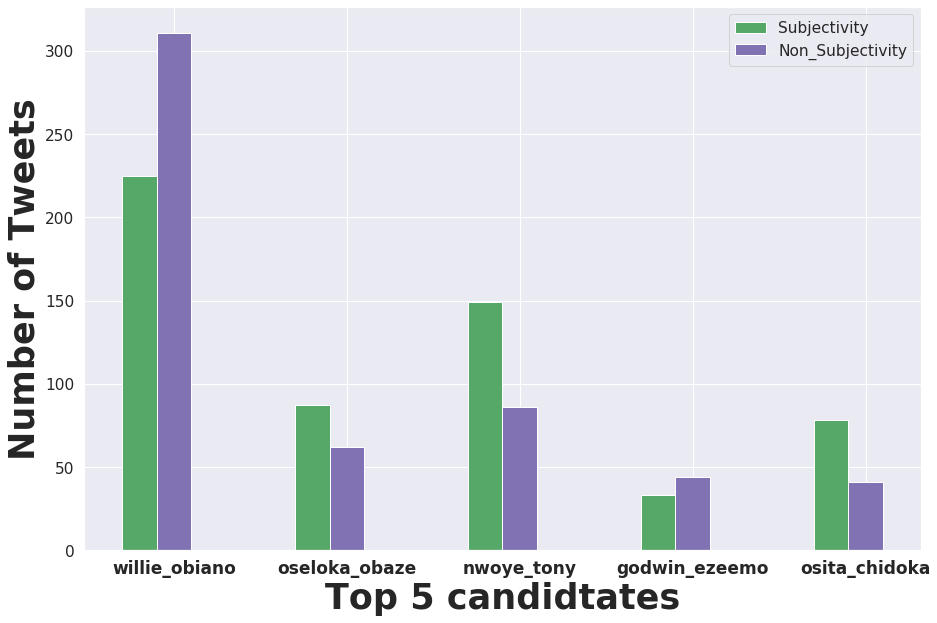

In [301]:
multiple_bars=plt.figure()

tweets_by_name_subj = [subj_df['willie_obiano'].value_counts()[True], 
                  subj_df['oseloka_obaze'].value_counts()[True], 
                  subj_df['nwoye_tony'].value_counts()[True], 
                  subj_df['godwin_ezeemo'].value_counts()[True],
                  subj_df['osita_chidoka'].value_counts()[True]]

tweets_by_name_non_subj = [non_subj_df['willie_obiano'].value_counts()[True],
                  non_subj_df['oseloka_obaze'].value_counts()[True], 
                  non_subj_df['nwoye_tony'].value_counts()[True], 
                  non_subj_df['godwin_ezeemo'].value_counts()[True],
                  non_subj_df['osita_chidoka'].value_counts()[True]]

x=['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka']
ind=np.arange(len(x))
subj = tweets_by_name_subj
non_subj = tweets_by_name_non_subj

width = 0.8
fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Subjectivity and Non_Subjectivity Tweets on the candidates", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.2, subj, width=.2, color='g', align='center', label='Subjectivity')
ax.bar(ind, non_subj, width=.2, color='m', align='center', label='Non_Subjectivity')

ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=17,fontweight='bold')
ax.set_ylabel('Number of Tweets',fontsize=35,fontweight='bold')
ax.set_xlabel('Top 5 candidtates',fontsize=35,fontweight='bold')
ax.legend(loc='best')

In [116]:
# for index, tweets in tweets_by_name_non_subj[tweets_by_name_non_subj['Sentiment_Polarity_Vals'] == 2].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

Text(0.5, 1.0, 'Subjectivity and Non_Subjectivity Tweets on the Political Parties')

<BarContainer object of 5 artists>

<BarContainer object of 5 artists>

[Text(0, 0, 'apga'),
 Text(0, 0, 'pdp'),
 Text(0, 0, 'apc'),
 Text(0, 0, 'ppa'),
 Text(0, 0, 'udp')]

Text(0, 0.5, 'Number of Tweets')

Text(0.5, 0, 'Top 5 Political Parties')

<Figure size 432x288 with 0 Axes>

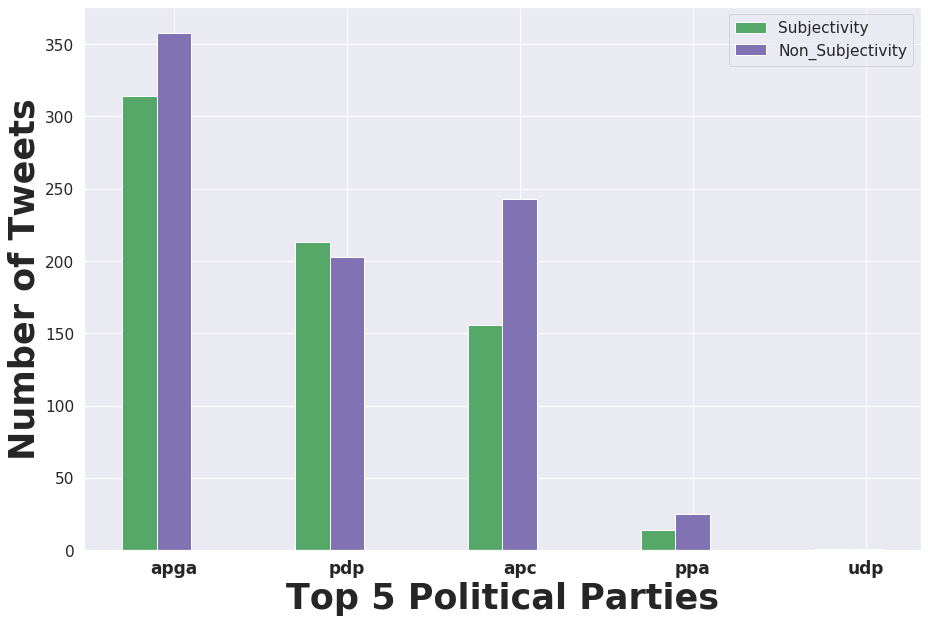

In [302]:
multiple_bars=plt.figure()

tweets_by_name_subj = [subj_df['apga'].value_counts()[True], 
                  subj_df['pdp'].value_counts()[True], 
                  subj_df['apc'].value_counts()[True], 
                  subj_df['ppa'].value_counts()[True],
                  subj_df['udp'].value_counts()[True]]

tweets_by_name_non_subj = [non_subj_df['apga'].value_counts()[True], 
                  non_subj_df['pdp'].value_counts()[True], 
                  non_subj_df['apc'].value_counts()[True], 
                  non_subj_df['ppa'].value_counts()[True],
                  non_subj_df['udp'].value_counts()[True]]

x=['apga','pdp','apc','ppa','udp']
ind=np.arange(len(x))
subj = tweets_by_name_subj
non_subj = tweets_by_name_non_subj

width = 0.8
fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Subjectivity and Non_Subjectivity Tweets on the Political Parties", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.2, subj, width=.2, color='g', align='center', label='Subjectivity')
ax.bar(ind, non_subj, width=.2, color='m', align='center', label='Non_Subjectivity')

ax.set_xticks(ind)
ax.set_xticklabels(x,fontsize=17,fontweight='bold')
ax.set_ylabel('Number of Tweets',fontsize=35,fontweight='bold')
ax.set_xlabel('Top 5 Political Parties',fontsize=35,fontweight='bold')
ax.legend(loc='best')

<Figure size 432x288 with 0 Axes>

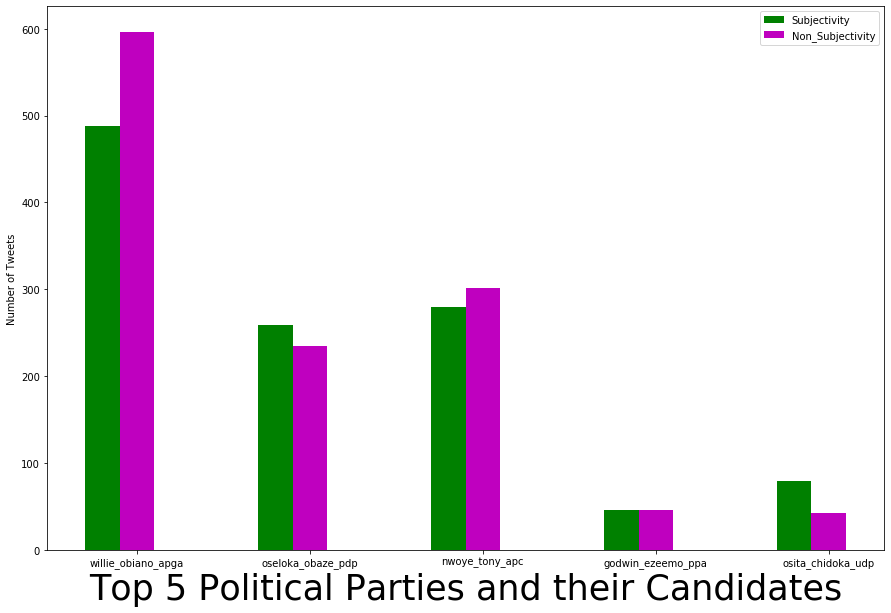

In [118]:
multiple_bars=plt.figure()

tweets_by_name_subj = [subj_df['willie_obiano_apga'].value_counts()[True], 
                  subj_df['oseloka_obaze_pdp'].value_counts()[True], 
                  subj_df['nwoye_tony_apc'].value_counts()[True], 
                  subj_df['godwin_ezeemo_ppa'].value_counts()[True],
                  subj_df['osita_chidoka_udp'].value_counts()[True]]

tweets_by_name_non_subj = [non_subj_df['willie_obiano_apga'].value_counts()[True], 
                  non_subj_df['oseloka_obaze_pdp'].value_counts()[True], 
                  non_subj_df['nwoye_tony_apc'].value_counts()[True], 
                  non_subj_df['godwin_ezeemo_ppa'].value_counts()[True],
                  non_subj_df['osita_chidoka_udp'].value_counts()[True]]

x=['willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc','godwin_ezeemo_ppa','osita_chidoka_udp']
ind=np.arange(len(x))
subj = tweets_by_name_subj
non_subj = tweets_by_name_non_subj

width = 0.8
fig, ax = plt.subplots(figsize=(15, 10))
ax.set_title("Subjectivity and Non_Subjectivity Tweets on the Political Parties and their Candidates", fontsize=15, fontweight='bold')
ax=plt.subplot(111)
ax.bar(ind-.2, subj, width=.2, color='g', align='center', label='Subjectivity')
ax.bar(ind, non_subj, width=.2, color='m', align='center', label='Non_Subjectivity')

ax.set_xticks(ind)
ax.set_xticklabels(x)
ax.set_ylabel('Number of Tweets')
ax.set_xlabel('Top 5 Political Parties and their Candidates',fontsize=35)
ax.legend(loc='best')

# Average senti polarity for each party and contestants

In [119]:
#['willie_obiano','oseloka_obaze','nwoye_tony','godwin_ezeemo','osita_chidoka']

contestants_val = []
partynames_vals = []
for i in range(0,len(originals.willie_obiano)):
    if originals.willie_obiano[i] == True:
        contestants_val.append(1)
    elif originals.oseloka_obaze[i] == True:
        contestants_val.append(2)
    elif originals.nwoye_tony[i] == True:
        contestants_val.append(3)
    elif originals.godwin_ezeemo[i] == True:
        contestants_val.append(4)
    elif originals.osita_chidoka[i] == True:
        contestants_val.append(5)
    else:
        contestants_val.append(0)
    
    if originals.apga[i] == True:
        partynames_vals.append(1)
    elif originals.pdp[i] == True:
        partynames_vals.append(2)
    elif originals.apc[i] == True:
        partynames_vals.append(3)
    elif originals.ppa[i] == True:
        partynames_vals.append(4)
    elif originals.udp[i] == True:
        partynames_vals.append(5)
    else:
        partynames_vals.append(0)

In [120]:
originals['contestants_val'] = contestants_val
originals['partynames_vals'] = partynames_vals
originals.head()

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0.000000,0.000000,0,0,1,-1.000,1,-0.8847,1,3
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0.000000,0.000000,0,0,1,-0.250,1,-0.1027,0,1
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,0.000000,0.000000,0,0,2,0.375,1,-0.2263,2,2
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,0.766667,0.433333,2,2,2,1.125,2,0.9590,5,0
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,0.187500,0.437500,2,2,2,0.375,2,0.3400,0,2


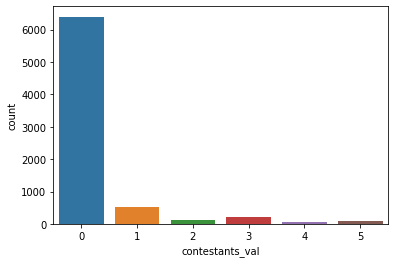

In [121]:
sns.countplot(x='contestants_val', data=originals)

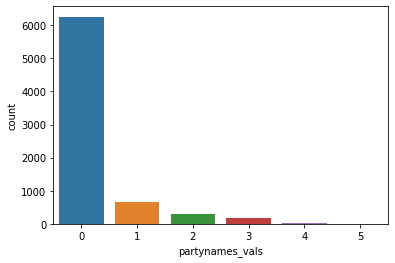

In [122]:
sns.countplot(x='partynames_vals', data=originals)

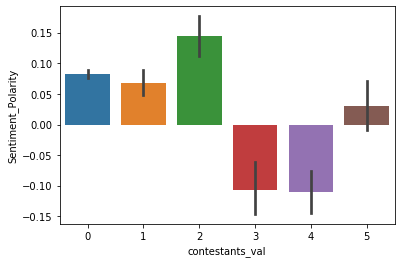

In [123]:
sns.barplot(x='contestants_val', y='Sentiment_Polarity', data=originals)

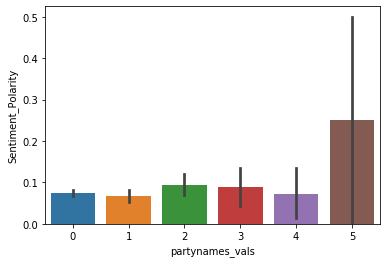

In [124]:
sns.barplot(x='partynames_vals', y='Sentiment_Polarity', data=originals)

# Average senti polarity for parties + contestants

In [125]:
#['willie_obiano_apga','oseloka_obaze_pdp','nwoye_tony_apc','godwin_ezeemo_ppa','osita_chidoka_udp']
partynames_contestants_vals = []
pnames = []
for i in range(0,len(originals.willie_obiano_apga)):
    if originals.willie_obiano_apga[i] == True:
        partynames_contestants_vals.append(1)
        pnames.append('apga')
    elif originals.oseloka_obaze_pdp[i] == True:
        partynames_contestants_vals.append(2)
        pnames.append('pdp')
    elif originals.nwoye_tony_apc[i] == True:
        partynames_contestants_vals.append(3)
        pnames.append('apc')
    elif originals.godwin_ezeemo_ppa[i] == True:
        partynames_contestants_vals.append(4)
        pnames.append('ppa')
    elif originals.osita_chidoka_udp[i] == True:
        partynames_contestants_vals.append(5)
        pnames.append('udp')
    else:
        partynames_contestants_vals.append(0)
        pnames.append('non')

In [126]:
originals['partynames_contestants_vals'] = partynames_contestants_vals
originals['pnames'] = pnames
originals.head()

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0,0,1,-1.000,1,-0.8847,1,3,1,apga
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0,0,1,-0.250,1,-0.1027,0,1,1,apga
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,0,0,2,0.375,1,-0.2263,2,2,2,pdp
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,2,2,2,1.125,2,0.9590,5,0,5,udp
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,2,2,2,0.375,2,0.3400,0,2,2,pdp


In [127]:
c0=0
for v in originals.partynames_contestants_vals:
    if v == 2:
        c0+=2
print(c0)

c1=0
for v in originals.contestants_val:
    if v == 2:
        c1+=2
print(c1)

660
268


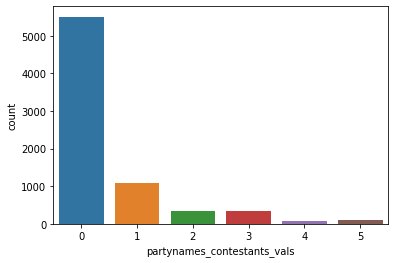

In [128]:
sns.countplot(x='partynames_contestants_vals', data=originals)

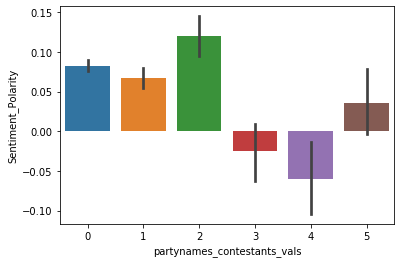

In [129]:
sns.barplot(x='partynames_contestants_vals', y='Sentiment_Polarity', data=originals)

# date time range example

In [130]:
df = pd.DataFrame({'full_date': pd.date_range('2016-1-1 10:00:00.123', periods=10, freq='1H')})

In [131]:
df

,full_date
0,2016-01-01 10:00:00.123
1,2016-01-01 11:00:00.123
2,2016-01-01 12:00:00.123
3,2016-01-01 13:00:00.123
4,2016-01-01 14:00:00.123
5,2016-01-01 15:00:00.123
6,2016-01-01 16:00:00.123
7,2016-01-01 17:00:00.123
8,2016-01-01 18:00:00.123
9,2016-01-01 19:00:00.123


In [132]:
df['date'] = df['full_date'].dt.date

In [133]:
df['time'] = df['full_date'].dt.time

# Time series sentiment analysis

In [134]:
# reloads libraries when their hash changes
%load_ext autoreload
%autoreload 2

import logging
logging.basicConfig(level="WARN")

import itertools as it

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Our libraries
from tweet_parser.tweet import Tweet
from searchtweets import ResultStream, gen_rule_payload

from IPython.display import HTML
from IPython.core.interactiveshell import InteractiveShell

# load the methods from our auxillary file
from timeseries_utils import (get_frequent_terms,
                               plot_ts,
                               summarize_tweet_text,
                               make_normalplot,
                               pop_star_rules,
                               spotify_popular_artists_rule,
                               spotify_charts_rule)

# the following makes working in a notebook a bit easier
# as you don't have to have new cells for all output
InteractiveShell.ast_node_interactivity = "all"

# allows for inline plotting
%matplotlib inline

# pretty plots
plt.style.use("bmh")

# better sizing for the notebook
plt.rcParams['figure.figsize'] = (10, 5)

### willie_obiano 535 oseloka_obaze 147 nwoye_tony 235 godwin_ezeemo 77 osita_chidoka 118 apga 668 pdp 412 apc 394 ppa 39 udp 2 willie_obiano_apga 1079 oseloka_obaze_pdp 489 nwoye_tony_apc 577 godwin_ezeemo_ppa 92 osita_chidoka_udp 120

In [135]:
data_for_time_series = originals.copy()
data_for_time_series

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0,0,1,-1.000,1,-0.8847,1,3,1,apga
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0,0,1,-0.250,1,-0.1027,0,1,1,apga
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,0,0,2,0.375,1,-0.2263,2,2,2,pdp
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,2,2,2,1.125,2,0.9590,5,0,5,udp
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,2,2,2,0.375,2,0.3400,0,2,2,pdp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7433,932021133653827584,Sat Nov 18 23:02:09 +0000 2017,anambra,USA,Maria Eke,Anambra election : IPOB says low turnout sign ...,False,False,False,False,...,0,2,1,-0.250,1,-0.5267,0,0,0,non
7434,932021150519087105,Sat Nov 18 23:02:13 +0000 2017,anambra,Garden of Eden,Dozay,Lol . . . charity begins at home https://t.co/...,False,False,False,False,...,2,2,2,0.500,2,0.6808,0,0,0,non
7435,932021173474471937,Sat Nov 18 23:02:18 +0000 2017,anambra,"Lagos, Nigeria",247CODED.COM.NG,Anambra Election : “ Vote & amp ; Die ” Charms...,False,False,False,False,...,0,0,2,0.625,1,-0.2500,0,0,0,non
7436,932021225609625601,Sat Nov 18 23:02:30 +0000 2017,anambra,WAR STREET,KINGG♔,Awka https://t.co/qronzgnV1H,False,False,False,False,...,0,0,0,0.000,0,0.0000,0,0,0,non


In [136]:
data_for_time_series = data_for_time_series.loc[data_for_time_series['date'] != 'None']

In [137]:
data_for_time_series = data_for_time_series.copy()
data_for_time_series

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0,0,1,-1.000,1,-0.8847,1,3,1,apga
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0,0,1,-0.250,1,-0.1027,0,1,1,apga
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,0,0,2,0.375,1,-0.2263,2,2,2,pdp
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,2,2,2,1.125,2,0.9590,5,0,5,udp
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,2,2,2,0.375,2,0.3400,0,2,2,pdp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7433,932021133653827584,Sat Nov 18 23:02:09 +0000 2017,anambra,USA,Maria Eke,Anambra election : IPOB says low turnout sign ...,False,False,False,False,...,0,2,1,-0.250,1,-0.5267,0,0,0,non
7434,932021150519087105,Sat Nov 18 23:02:13 +0000 2017,anambra,Garden of Eden,Dozay,Lol . . . charity begins at home https://t.co/...,False,False,False,False,...,2,2,2,0.500,2,0.6808,0,0,0,non
7435,932021173474471937,Sat Nov 18 23:02:18 +0000 2017,anambra,"Lagos, Nigeria",247CODED.COM.NG,Anambra Election : “ Vote & amp ; Die ” Charms...,False,False,False,False,...,0,0,2,0.625,1,-0.2500,0,0,0,non
7436,932021225609625601,Sat Nov 18 23:02:30 +0000 2017,anambra,WAR STREET,KINGG♔,Awka https://t.co/qronzgnV1H,False,False,False,False,...,0,0,0,0.000,0,0.0000,0,0,0,non


In [138]:
data_for_time_series['created_at'] = [d.split()[5]+'-'+'11'+'-'+d.split()[2]+' '+d.split()[3] for d in data_for_time_series.date]

In [139]:
data_for_time_series

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0,1,-1.000,1,-0.8847,1,3,1,apga,2017-11-18 09:19:00
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0,1,-0.250,1,-0.1027,0,1,1,apga,2017-11-18 06:13:00
2,931856855525246976,Sat Nov 18 07:15:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra people pls go out ...,False,True,False,False,...,0,2,0.375,1,-0.2263,2,2,2,pdp,2017-11-18 07:15:00
3,931856855555246976,Sat Nov 18 10:17:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,I'm rooting for you osita chidoka today as #An...,False,False,False,False,...,2,2,1.125,2,0.9590,5,0,5,udp,2017-11-18 10:17:00
4,931856843525556976,Sat Nov 18 10:44:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Today is Anambra Gubernato...,False,True,False,False,...,2,2,0.375,2,0.3400,0,2,2,pdp,2017-11-18 10:44:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7433,932021133653827584,Sat Nov 18 23:02:09 +0000 2017,anambra,USA,Maria Eke,Anambra election : IPOB says low turnout sign ...,False,False,False,False,...,2,1,-0.250,1,-0.5267,0,0,0,non,2017-11-18 23:02:09
7434,932021150519087105,Sat Nov 18 23:02:13 +0000 2017,anambra,Garden of Eden,Dozay,Lol . . . charity begins at home https://t.co/...,False,False,False,False,...,2,2,0.500,2,0.6808,0,0,0,non,2017-11-18 23:02:13
7435,932021173474471937,Sat Nov 18 23:02:18 +0000 2017,anambra,"Lagos, Nigeria",247CODED.COM.NG,Anambra Election : “ Vote & amp ; Die ” Charms...,False,False,False,False,...,0,2,0.625,1,-0.2500,0,0,0,non,2017-11-18 23:02:18
7436,932021225609625601,Sat Nov 18 23:02:30 +0000 2017,anambra,WAR STREET,KINGG♔,Awka https://t.co/qronzgnV1H,False,False,False,False,...,0,0,0.000,0,0.0000,0,0,0,non,2017-11-18 23:02:30


In [140]:
candidates_parties=['willie','obiano','oseloka','obaze','nwoye','tony','godwin','ezeemo', 'osita','chidoka', 'apga','pdp','apc', 'ppa','udp']

# willie obiano wo

In [141]:
time_series_data_wo = data_for_time_series.loc[data_for_time_series['willie_obiano'] == True]
time_series_data_wo = time_series_data_wo.copy()

In [142]:
time_series_data_wo.shape

(536, 51)

In [143]:
candidates_parties_wo=['oseloka','obaze','nwoye','tony','godwin','ezeemo','osita','chidoka','apga','pdp','apc','ppa','udp']

In [144]:
pre = set()
for tweet in time_series_data_wo['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_wo:
            pre.add(tweet)

In [145]:
for tweet in time_series_data_wo['text']:
    if not tweet in pre:
        print(tweet)

Anambra Election : Obiano ‘ breaches ’ electoral law , addresses voters at polling centre : . . . https://t.co/nFoEjUP7VJ
Anambra guber : I ’ ll win with a landslide victory – Governor Obiano - . . . https://t.co/N4tgcXRDiU
Anambra Election : Obiano ‘ breaches ’ electoral law , addresses voters at polling centre : https://t.co/EXBvvf7jbQ
. @ApgaHQ candidate and gov Obiano cast his votes at his polling unit around 1.00 pm . He is confident of remaining in … https://t.co/SG1Wxiy46c
. ApgaHQ candidate and gov Obiano cast his votes at his polling unit around 1.00 pm . He is confident of remaining in … https://t.co/ZcKc6UeHwL
[ IN THE NEWS ] Anambra election : Obiano urges voters come out , vote ; decries INEC ’ s late arrival in Ihiala https://t.co/dFs0RFw6JY
Anambra Election : Obiano complains about failing card readers after voting-https :/ / t . co / esorQjaFlp https://t.co/gOGABrsWX5
Photos : Obiano thrills electorates with dancing steps - https://t.co/Z4wv5PvRq7 Willie Obiano Of Anamb

In [146]:
time_series_data_wo_only = time_series_data_wo[time_series_data_wo.text.isin(pre)==False].dropna()

In [147]:
i = 0
for text in time_series_data_wo_only['text']:
    if text != ' ':
        print(i, text)
        
        i += 1

0 Anambra Election : Obiano ‘ breaches ’ electoral law , addresses voters at polling centre : . . . https://t.co/nFoEjUP7VJ
1 Anambra guber : I ’ ll win with a landslide victory – Governor Obiano - . . . https://t.co/N4tgcXRDiU
2 Anambra Election : Obiano ‘ breaches ’ electoral law , addresses voters at polling centre : https://t.co/EXBvvf7jbQ
3 . @ApgaHQ candidate and gov Obiano cast his votes at his polling unit around 1.00 pm . He is confident of remaining in … https://t.co/SG1Wxiy46c
4 . ApgaHQ candidate and gov Obiano cast his votes at his polling unit around 1.00 pm . He is confident of remaining in … https://t.co/ZcKc6UeHwL
5 [ IN THE NEWS ] Anambra election : Obiano urges voters come out , vote ; decries INEC ’ s late arrival in Ihiala https://t.co/dFs0RFw6JY
6 Anambra Election : Obiano complains about failing card readers after voting-https :/ / t . co / esorQjaFlp https://t.co/gOGABrsWX5
7 Photos : Obiano thrills electorates with dancing steps - https://t.co/Z4wv5PvRq7 Willie

In [148]:
# UTC for date time at default
time_series_data_wo['created_at'] = pd.to_datetime(time_series_data_wo['created_at'])
# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_wo[time_series_data_wo['Sentiment_Polarity_Vals'] == 2].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

In [149]:
# UTC for date time at default
time_series_data_wo_only['created_at'] = pd.to_datetime(time_series_data_wo_only['created_at'])
# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_wo_only[time_series_data_wo_only['Sentiment_Polarity_Vals'] == 2].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

In [150]:
# Clean and transform data to enable time series
result = time_series_data_wo.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

In [151]:
# Clean and transform data to enable time series
result2 = time_series_data_wo_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

In [152]:
result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

In [153]:
result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

In [154]:
TRACK_WORDS = ['willie_obiano']
TABLE_NAME = "willie_obiano"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'willie_obiano' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

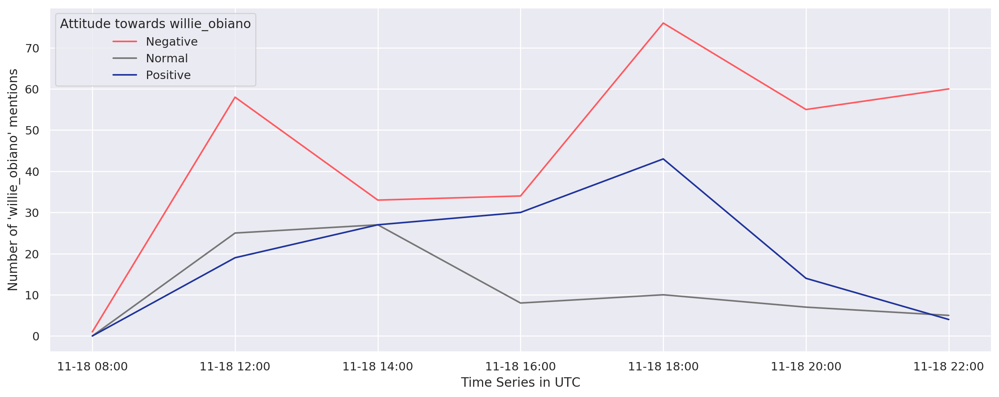

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'willie_obiano' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

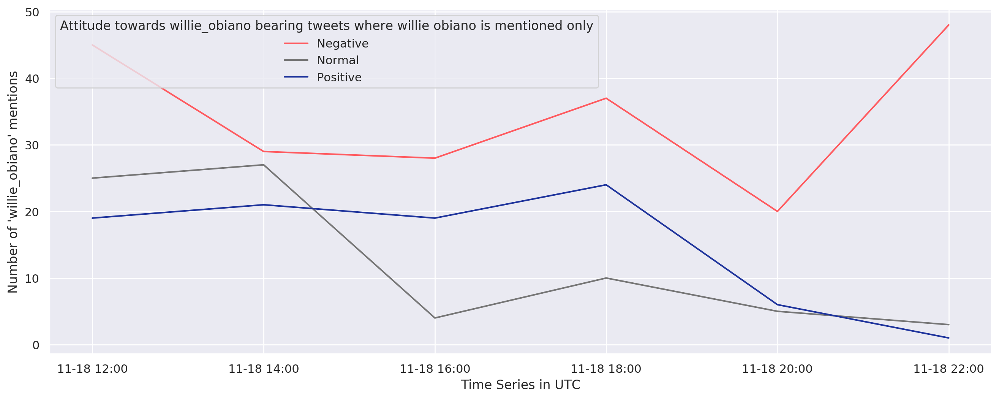

In [155]:
# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards willie_obiano', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()



# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards willie_obiano bearing tweets where willie obiano is mentioned only', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

In [156]:
toks = time_series_data_wo_only['tweet_tokens']
wotoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(wotoks)))

There are 42665 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

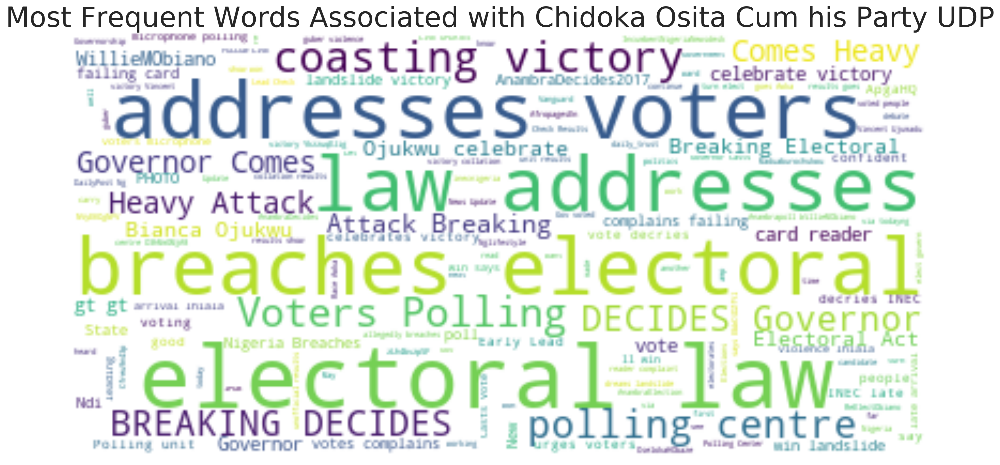

In [157]:
stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(wotoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# 06am to 13 breakfast

In [158]:
list_of_pola_plots = set()
list_of_subj_plots = set()
def ave(v):
    sumsc = sum(v)
    no_of_tweets = len(v)
    avesc = (sumsc/no_of_tweets)*100
    return avesc,sumsc,no_of_tweets

In [159]:
start_date = pd.to_datetime('2017-11-18 06:00:00')
end_date = pd.to_datetime('2017-11-18 13:00:00')
df_wo_06_13 = time_series_data_wo_only.loc[(time_series_data_wo_only['created_at'] > start_date) & (time_series_data_wo_only['created_at'] < end_date)]

In [160]:
df_wo_06_13

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
61,931858046267076608,Sat Nov 18 12:14:05 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:14:05
73,931858293571629057,Sat Nov 18 12:15:04 +0000 2017,anambra,"Aba, Nigeria",Puo Reports,Anambra guber : I ’ ll win with a landslide vi...,False,False,False,False,...,2,2,0.500,2,0.5859,1,0,1,apga,2017-11-18 12:15:04
81,931858440779124737,Sat Nov 18 12:15:40 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:15:40
105,931859323076120581,Sat Nov 18 12:19:10 +0000 2017,anambra,"Lagos, Nigeria",NAIJ.com,. @ApgaHQ candidate and gov Obiano cast his vo...,True,False,False,False,...,2,2,0.500,2,0.4939,1,1,1,apga,2017-11-18 12:19:10
128,931859871250690051,Sat Nov 18 12:21:21 +0000 2017,anambra,Nigeria,Dhiqrullah,. ApgaHQ candidate and gov Obiano cast his vot...,True,False,False,False,...,2,2,0.500,2,0.4939,1,1,1,apga,2017-11-18 12:21:21
178,931860404367749120,Sat Nov 18 12:23:28 +0000 2017,anambra,Africa.,Glitz&Glamour Online,[ IN THE NEWS ] Anambra election : Obiano urge...,False,False,False,False,...,2,2,0.125,0,0.0000,1,0,1,apga,2017-11-18 12:23:28
354,931861136919670784,Sat Nov 18 12:26:22 +0000 2017,anambra,Africa,ceoafrica,Anambra Election : Obiano complains about fail...,False,False,False,False,...,2,0,0.000,1,-0.8074,1,0,1,apga,2017-11-18 12:26:22
360,931861382336827393,Sat Nov 18 12:27:21 +0000 2017,anambra,#AYTA2017,#AYTA2017Season9,Photos : Obiano thrills electorates with danci...,False,False,False,False,...,0,0,0.000,2,0.3612,1,0,1,apga,2017-11-18 12:27:21
361,931861434140590080,Sat Nov 18 12:27:33 +0000 2017,anambra,None,Afropages,DailyPost Ng - Anambra Election : Obiano votes...,False,False,False,False,...,0,2,0.125,1,-0.7096,1,0,1,apga,2017-11-18 12:27:33
362,931861442025984000,Sat Nov 18 12:27:35 +0000 2017,anambra,None,Afropages,Premium Times - Anambra Election : Obiano ‘ br...,False,False,False,False,...,0,2,0.500,0,0.0000,1,0,1,apga,2017-11-18 12:27:35


In [161]:
wo_pol = ave(df_wo_06_13['Sentiment_Polarity'])

In [162]:
list_of_pola_plots.add( (wo_pol[0],'wopol','breakfast') )
print(list_of_pola_plots,wo_pol[1],wo_pol[2])

{(11.323529411764707, 'wopol', 'breakfast')} 3.8500000000000005 34


In [163]:
wo_subj = ave(df_wo_06_13['Sentiment_Subjectivity'])

In [164]:
list_of_subj_plots.add( (wo_subj[0],'wosubj','breakfast') )
print(list_of_subj_plots,wo_subj[1],wo_subj[2])

{(31.993464052287578, 'wosubj', 'breakfast')} 10.877777777777776 34


# 13 to 19 lunch/tea

In [165]:
start_date = pd.to_datetime('2017-11-18 13:00:00')
end_date = pd.to_datetime('2017-11-18 19:00:00')
df_wo_13_19 = time_series_data_wo_only.loc[(time_series_data_wo_only['created_at'] > start_date) & (time_series_data_wo_only['created_at'] < end_date)]
df_wo_13_19

wo_pol = ave(df_wo_13_19['Sentiment_Polarity'])
list_of_pola_plots.add( (wo_pol[0],'wopol','lunch_tea') )
print(list_of_pola_plots,wo_pol[1],wo_pol[2])

wo_subj = ave(df_wo_13_19['Sentiment_Subjectivity'])
list_of_subj_plots.add( (wo_subj[0],'wosub','lunch_tea') )
print(list_of_subj_plots,wo_subj[1],wo_subj[2])

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
1031,931870693318447104,Sat Nov 18 13:04:21 +0000 2017,anambra,None,Tertulia Digital,https://t.co/k4h2jPz0jZ https://t.co/OgeRSTqWP...,False,False,False,False,...,0,2,0.125,1,-0.7096,1,0,1,apga,2017-11-18 13:04:21
1215,931871581986545665,Sat Nov 18 13:07:53 +0000 2017,anambra,"Abuja, Nigeria",Daily Trust,PHOTOS : #Anambrapoll : @WillieMObiano votes a...,True,False,False,False,...,2,1,-0.125,1,-0.2960,1,1,1,apga,2017-11-18 13:07:53
1229,931872036548378627,Sat Nov 18 13:09:41 +0000 2017,anambra,Federal Height Court,King K™,"@Chinedum_ @Ruud_bishop Obiano , governor of A...",False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 13:09:41
1240,931872179888820224,Sat Nov 18 13:10:15 +0000 2017,anambra,Universe,Oscrape,Anambra Decides 2017 - Gov Obiano Has Voted . ...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 13:10:15
1272,931872715933351936,Sat Nov 18 13:12:23 +0000 2017,anambra,Kano Nigeria,Bee Bello,daily_trust : PHOTOS : #Anambrapoll : WillieMO...,True,False,False,False,...,2,1,-0.125,1,-0.2960,1,1,1,apga,2017-11-18 13:12:23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5292,931955328496820224,Sat Nov 18 18:40:39 +0000 2017,anambra,Abuja,George Chimzi,Anambra people have done very well by re elect...,False,False,False,False,...,2,2,0.750,2,0.3384,1,0,1,apga,2017-11-18 18:40:39
5389,931957602870857729,Sat Nov 18 18:49:42 +0000 2017,anambra,#VoteOHO #Anambra1st,Republican. #VoteOHO,I do not like Willie's performance and I wish ...,False,False,False,False,...,2,2,0.750,2,0.8017,1,0,1,apga,2017-11-18 18:49:42
5410,931958190928998404,Sat Nov 18 18:52:02 +0000 2017,anambra,"Abuja, Nigeria",Ik,Unofficial results from Anambra shows that Wil...,False,False,False,False,...,0,1,-0.750,0,0.0000,1,0,1,apga,2017-11-18 18:52:02
5497,931959701100642304,Sat Nov 18 18:58:02 +0000 2017,anambra,Abuja,ScannewsNGR,Anambra election : Obiano casts vote at Otuoch...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 18:58:02


{(11.323529411764707, 'wopol', 'breakfast'), (9.23323948595688, 'wopol', 'lunch_tea')} 19.11280573593074 207
{(28.44287247910436, 'wosub', 'lunch_tea'), (31.993464052287578, 'wosubj', 'breakfast')} 58.87674603174602 207


# super 19 to 24

In [166]:
start_date = pd.to_datetime('2017-11-18 19:00:00')
end_date = pd.to_datetime('2017-11-18 23:59:59')
df_wo_19_00 = time_series_data_wo_only.loc[(time_series_data_wo_only['created_at'] > start_date) & (time_series_data_wo_only['created_at'] < end_date)]
df_wo_19_00

wo_pol = ave(df_wo_19_00['Sentiment_Polarity'])
list_of_pola_plots.add( (wo_pol[0],'wopol','supper') )
print(list_of_pola_plots,wo_pol[1],wo_pol[2])

wo_subj = ave(df_wo_19_00['Sentiment_Subjectivity'])
list_of_subj_plots.add( (wo_subj[0],'wosub','supper') )
print(list_of_subj_plots,wo_subj[1],wo_subj[2])

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
5521,931960327016730625,Sat Nov 18 19:00:31 +0000 2017,anambra,Africa,Adebayo Salami,"From every indication , Gov Willie Obiano is o...",False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 19:00:31
5523,931960370679504897,Sat Nov 18 19:00:42 +0000 2017,anambra,Africa,ceoafrica,"Anambra poll : I will win by a landslide , say...",False,False,False,False,...,2,0,0.000,2,0.3400,1,0,1,apga,2017-11-18 19:00:42
5527,931960558290657280,Sat Nov 18 19:01:26 +0000 2017,anambra,"Lagos, Nigeria",Naija NewsPapers,[ News Update ] Anambra Election : Bianca Ojuk...,False,False,False,False,...,0,2,0.625,2,0.7579,1,0,1,apga,2017-11-18 19:01:26
5543,931960886125789184,Sat Nov 18 19:02:44 +0000 2017,anambra,Abuja,ikenna victor,Anambra Guber poll records good turn out of Vo...,False,False,False,False,...,2,2,0.750,2,0.4404,1,0,1,apga,2017-11-18 19:02:44
5573,931961616006107136,Sat Nov 18 19:05:38 +0000 2017,anambra,None,LADY EVA,Willie will work again in Anambra 😛,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 19:05:38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7401,932019602741014528,Sat Nov 18 22:56:04 +0000 2017,anambra,Nigeria,Daily Nigeria News,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 22:56:04
7419,932020357589975040,Sat Nov 18 22:59:04 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7420,932020359397761024,Sat Nov 18 22:59:04 +0000 2017,anambra,LAGOS,TONI KAN,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7421,932020477958111232,Sat Nov 18 22:59:32 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:32


{(11.323529411764707, 'wopol', 'breakfast'), (9.23323948595688, 'wopol', 'lunch_tea'), (3.4420486920486937, 'wopol', 'supper')} 4.474663299663302 130
{(28.44287247910436, 'wosub', 'lunch_tea'), (12.488215488215488, 'wosub', 'supper'), (31.993464052287578, 'wosubj', 'breakfast')} 16.234680134680133 130


In [167]:
list_of_pola_plots

{(3.4420486920486937, 'wopol', 'supper'),
 (9.23323948595688, 'wopol', 'lunch_tea'),
 (11.323529411764707, 'wopol', 'breakfast')}

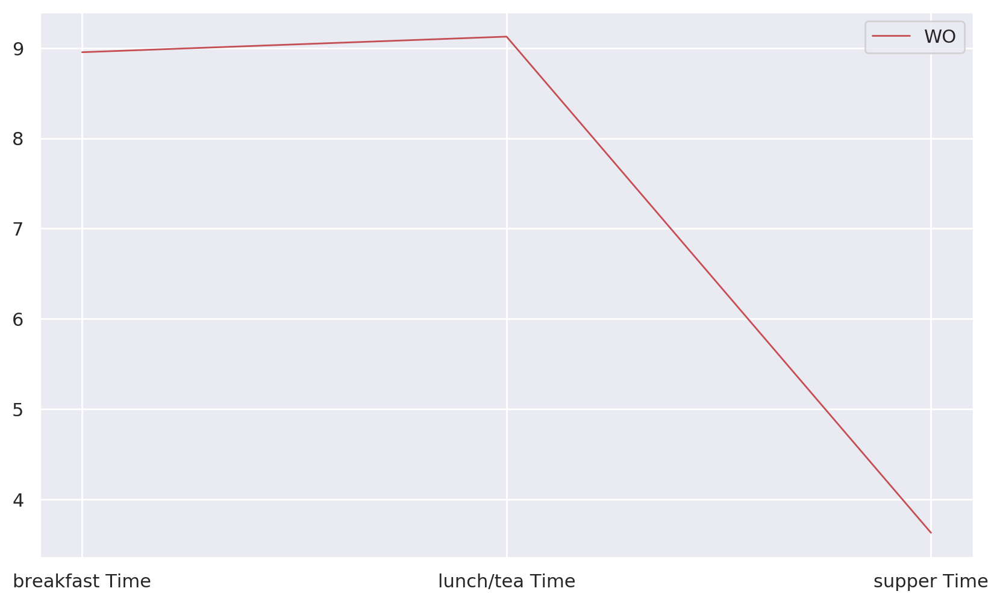

In [168]:
#Plot a line graph
d = [8.953488372093025, 9.12623614565104,3.6311302618617036]
x = ['breakfast Time','lunch/tea Time','supper Time']
# Define plot space
fig, ax = plt.subplots(figsize=(10, 6))

# Define x and y axes
ax.plot(x, d,'-r', label='WO')
leg = ax.legend();

# APGA

In [169]:
time_series_data_apga = data_for_time_series.loc[data_for_time_series['apga'] == True]
time_series_data_apga = time_series_data_apga.copy()

In [170]:
candidates_parties_apga=['willie','obiano','oseloka','obaze','nwoye','tony','godwin','ezeemo', 'osita','chidoka','pdp','apc', 'ppa','udp']

In [171]:
pre = set()
for tweet in time_series_data_apga['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_apga:
            pre.add(tweet)

In [172]:
for tweet in time_series_data_apga['text']:
    if not tweet in pre:
        print(tweet)

UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE , RECORDS LOW TURN OUT The home of the APGA candidate for the Anambra … https://t.co/7Kg0hHple6
Anambra Election : Deputy Gov Nkem Okeke votes @rave917fm @ApgaHQ #AnambraDecides2017
@OfficialPDPNig @ApgaHQ @inecnigeria @PoliceNG @WillieMObiano will win by landslide . Anambra is @ApgaHQ #AnambraDecides2017
S . O to the Anambra corpers that'll make the usual APGA soft 50 k today .
anambra At 1.18 pm , APGA agent sharing gala and malt at pu020 / pu021 . Community primary school 1 / 2 Abatete .
Just in . . . . Deputy Governor of Anambra State Dr Nkem Okeke just exercised his civic right ( By Voting APGA ) at . . . https://t.co/RkyA0GvXY9
PHOTOS : #Anambrapoll : @WillieMObiano votes after card reader's complaint https://t.co/zS8BVRoSuz @ApgaHQ @inec https://t.co/lCEeabgiq4
Anambra Poll : Election observers , APGA , UPP commend timely distribution of materials READ MORE https://t.co/2XU38oaBDw
daily_trust : PHOTOS : #Anambrapoll : WillieMObiano 

In [173]:
time_series_data_apga_only = time_series_data_apga[time_series_data_apga.text.isin(pre)==False].dropna()
time_series_data_apga_only

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
33,931857325371068416,Sat Nov 18 12:11:14 +0000 2017,anambra,None,Chilobe,UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE...,True,False,False,False,...,2,2,0.125,1,-0.8833,0,1,1,apga,2017-11-18 12:11:14
350,931861047996223488,Sat Nov 18 12:26:01 +0000 2017,anambra,Lagos,Youngest Egalitarian,Anambra Election : Deputy Gov Nkem Okeke votes...,True,False,False,False,...,0,0,0.000,0,0.0000,0,1,1,apga,2017-11-18 12:26:01
382,931861935720681472,Sat Nov 18 12:29:33 +0000 2017,anambra,Around the world,Joy Zee Emedo,@OfficialPDPNig @ApgaHQ @inecnigeria @PoliceNG...,True,True,False,False,...,2,0,0.000,2,0.5859,1,1,1,apga,2017-11-18 12:29:33
634,931863941852155904,Sat Nov 18 12:37:31 +0000 2017,anambra,None,-,S . O to the Anambra corpers that'll make the ...,True,False,False,False,...,2,0,0.000,0,0.0000,0,1,1,apga,2017-11-18 12:37:31
774,931866394790191104,Sat Nov 18 12:47:16 +0000 2017,anambra,"Lagos, ok am @yah back",CBN Gov Akinsola Ak,"anambra At 1.18 pm , APGA agent sharing gala a...",True,False,False,False,...,2,2,0.875,2,0.4215,0,1,1,apga,2017-11-18 12:47:16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7309,932014376168624130,Sat Nov 18 22:35:17 +0000 2017,anambra,"Enugu, Nigeria",Thor,@OfficialPDPNig @ApgaHQ @inecnigeria @PoliceNG...,True,True,False,False,...,2,2,1.125,0,0.0000,0,1,1,apga,2017-11-18 22:35:17
7338,932016103370514432,Sat Nov 18 22:42:09 +0000 2017,anambra,"Ikeja, Nigeria",Onwa Nnewi,@perfectskones No Baba we no need that kind ch...,True,False,False,False,...,2,2,0.750,2,0.7096,0,1,1,apga,2017-11-18 22:42:09
7372,932017494386147328,Sat Nov 18 22:47:41 +0000 2017,anambra,None,Nigerian Expression,Anambra guber poll : APGA decries malfunctioni...,True,False,False,False,...,0,0,0.000,0,0.0000,0,1,1,apga,2017-11-18 22:47:41
7388,932018856209432576,Sat Nov 18 22:53:06 +0000 2017,anambra,"Lagos, Nigeria",Conceived,Anambra election : Bianca Ojukwu celebrates AP...,True,False,False,False,...,0,2,0.375,2,0.5719,0,1,1,apga,2017-11-18 22:53:06


In [174]:
# UTC for date time at default
time_series_data_apga['created_at'] = pd.to_datetime(time_series_data_apga['created_at'])
# print("APGA Negative Tweets Monitor: ")
# for index, tweets in time_series_data_apga[time_series_data_apga['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

In [175]:
# UTC for date time at default
time_series_data_apga_only['created_at'] = pd.to_datetime(time_series_data_apga_only['created_at'])
print("APGA Negative Tweets Monitor: ")
for index, tweets in time_series_data_apga_only[time_series_data_apga_only['Sentiment_Polarity_Vals'] == 1].iterrows():
    print("  " +str(tweets[46]) + "  " + tweets[5])

APGA Negative Tweets Monitor: 
  0  UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE , RECORDS LOW TURN OUT The home of the APGA candidate for the Anambra … https://t.co/7Kg0hHple6
  0  S . O to the Anambra corpers that'll make the usual APGA soft 50 k today .
  1  PHOTOS : #Anambrapoll : @WillieMObiano votes after card reader's complaint https://t.co/zS8BVRoSuz @ApgaHQ @inec https://t.co/lCEeabgiq4
  1  daily_trust : PHOTOS : #Anambrapoll : WillieMObiano votes after card reader's complaint https://t.co/rA15Pod271 ApgaH … https://t.co/UDIWZ2UjQn
  0  @OfficialPDPNig @ApgaHQ @inecnigeria @PoliceNG Give it up guys . You have been roundly thrashed . Results are trickli … https://t.co/5C5sgeP9sA
  1  Anambra Election : L 😂 L ! I'm Just Crying Joyfully . #AnambraIsAPGA #ObianoLeads https://t.co/iySxDP7qZE
  0  Anambra Poll : Police Apprehend APGA Agent Over Alleged Monetary Inducement https://t.co/1ETxzcsay1
  0  Anambra election : APGA decries allegedly malfunctioning card readers https://t.

In [176]:
# Clean and transform data to enable time series
result = time_series_data_apga.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

In [177]:
# Clean and transform data to enable time series
result2 = time_series_data_apga_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

In [178]:
TRACK_WORDS = ['APGA']
TABLE_NAME = "APGA"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'APGA' mentions"), Text(0.5, 0, 'Time Series in UTC')]

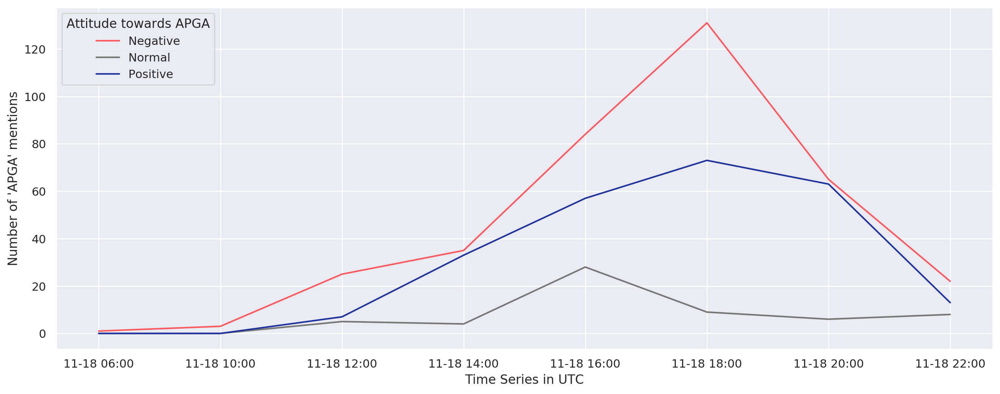

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'APGA' mentions"), Text(0.5, 0, 'Time Series in UTC')]

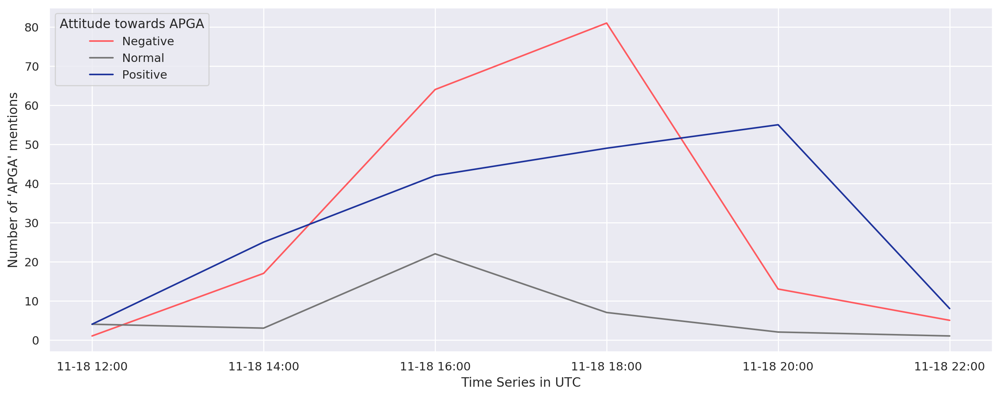

In [179]:
# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards APGA', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()


# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards APGA', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

In [180]:
toks = time_series_data_apga_only['tweet_tokens']
apgatoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(apgatoks)))

There are 43123 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

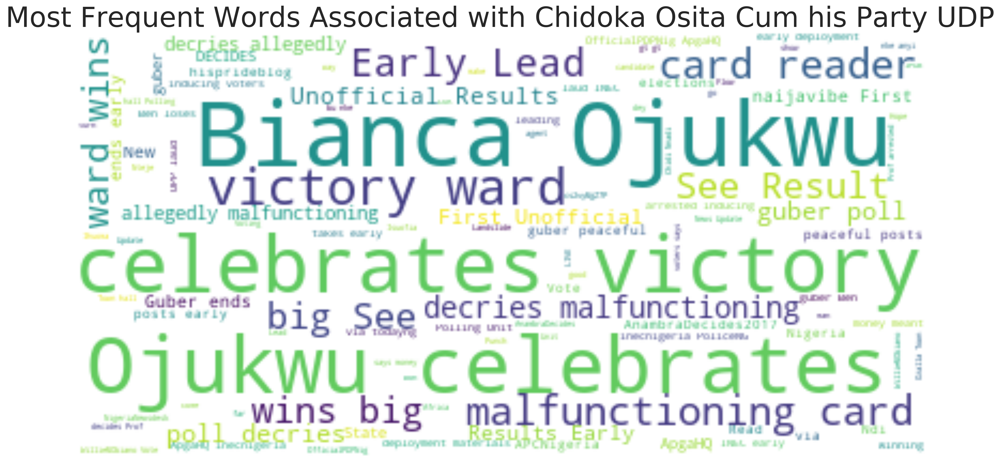

In [181]:

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(apgatoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [182]:
# start_date = pd.to_datetime('2017-11-18 06:00:00')
# end_date = pd.to_datetime('2017-11-18 13:00:00')
# df_apga_06_13 = time_series_data_apga_only.loc[(time_series_data_apga_only['created_at'] > start_date) & (time_series_data_apga_only['created_at'] < end_date)]
# df_apga_06_13

# apga_pol = ave(df_apga_06_13['Sentiment_Polarity'])
# list_of_pola_plots.add( (apga_pol[0],'wo','breakfast') )
# list_of_pola_plots

# willie obiano apga

In [183]:
time_series_data_wo_apga = data_for_time_series.loc[data_for_time_series['willie_obiano_apga'] == True]
time_series_data_wo_apga = time_series_data_wo_apga.copy()
time_series_data_wo_apga

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
0,930056843525246976,Sat Nov 18 09:19:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 Anambra will fare bether u...,False,False,True,False,...,0,1,-1.000,1,-0.8847,1,3,1,apga,2017-11-18 09:19:00
1,931856843525555576,Sat Nov 18 06:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"At the visit of @MBuhari to Ebonyi , Elechi , ...",True,True,True,False,...,0,1,-0.250,1,-0.1027,0,1,1,apga,2017-11-18 06:13:00
5,931856843525888876,Sat Nov 18 11:13:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,#AnambraDecides2017 APC and Apga agents seen l...,True,False,True,False,...,0,2,0.750,1,-0.8316,0,1,1,apga,2017-11-18 11:13:00
6,931859999525246976,Sat Nov 18 11:23:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,"Anambra election : APC , APGA agents paying 2,...",True,True,True,False,...,0,2,0.125,0,0.0000,0,1,1,apga,2017-11-18 11:23:00
7,931856843525211116,Sat Nov 18 11:10:00 +0000 2017,anambra,"Lagos, Nigeria",Oluwatomiwa,Vote and write your name in order to collect m...,True,False,True,False,...,0,2,0.125,0,0.0000,0,1,1,apga,2017-11-18 11:10:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7419,932020357589975040,Sat Nov 18 22:59:04 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7420,932020359397761024,Sat Nov 18 22:59:04 +0000 2017,anambra,LAGOS,TONI KAN,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7421,932020477958111232,Sat Nov 18 22:59:32 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:32
7422,932020477983379460,Sat Nov 18 22:59:32 +0000 2017,anambra,Nigeria,Woye,@emmaikumeh I am happy APGA won . What we gain...,True,False,True,False,...,2,2,0.875,2,0.9062,0,1,1,apga,2017-11-18 22:59:32


In [184]:
candidates_parties_apga_wo=['oseloka','obaze','nwoye','tony','godwin','ezeemo', 'osita','chidoka','pdp','apc', 'ppa','udp']

In [185]:
pre = set()
for tweet in time_series_data_wo_apga['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_apga_wo:
            pre.add(tweet)

In [186]:
time_series_data_apga_wo_only = time_series_data_wo_apga[time_series_data_wo_apga.text.isin(pre)==False].dropna()
time_series_data_apga_wo_only

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
33,931857325371068416,Sat Nov 18 12:11:14 +0000 2017,anambra,None,Chilobe,UPDATE : OTUOCHA FORCED AND THREATENED TO VOTE...,True,False,False,False,...,2,2,0.125,1,-0.8833,0,1,1,apga,2017-11-18 12:11:14
61,931858046267076608,Sat Nov 18 12:14:05 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:14:05
73,931858293571629057,Sat Nov 18 12:15:04 +0000 2017,anambra,"Aba, Nigeria",Puo Reports,Anambra guber : I ’ ll win with a landslide vi...,False,False,False,False,...,2,2,0.500,2,0.5859,1,0,1,apga,2017-11-18 12:15:04
81,931858440779124737,Sat Nov 18 12:15:40 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:15:40
93,931858848830447616,Sat Nov 18 12:17:17 +0000 2017,anambra,"Abuja,nigeria",#History,Gov Obiano ( APGA ) has violated electoral law...,True,False,False,False,...,0,0,0.000,1,-0.5267,1,1,1,apga,2017-11-18 12:17:17
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7418,932020339428810753,Sat Nov 18 22:58:59 +0000 2017,anambra,"Lagos, Nigeria",Gidilag,#anambradecides2017 Polling Unit Results Show ...,True,False,False,False,...,0,0,0.000,2,0.5719,1,1,1,apga,2017-11-18 22:58:59
7419,932020357589975040,Sat Nov 18 22:59:04 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7420,932020359397761024,Sat Nov 18 22:59:04 +0000 2017,anambra,LAGOS,TONI KAN,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7421,932020477958111232,Sat Nov 18 22:59:32 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:32


In [187]:
# UTC for date time at default
time_series_data_wo_apga['created_at'] = pd.to_datetime(time_series_data_wo_apga['created_at'])
# print("APGA Negative Tweets Monitor: ")
# for index, tweets in time_series_data_wo_apga[time_series_data_wo_apga['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

In [188]:
# UTC for date time at default
time_series_data_apga_wo_only['created_at'] = pd.to_datetime(time_series_data_apga_wo_only['created_at'])
# print("APGA Negative Tweets Monitor: ")
# for index, tweets in time_series_data_wo_apga[time_series_data_wo_apga['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'willie_obiano_apga' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

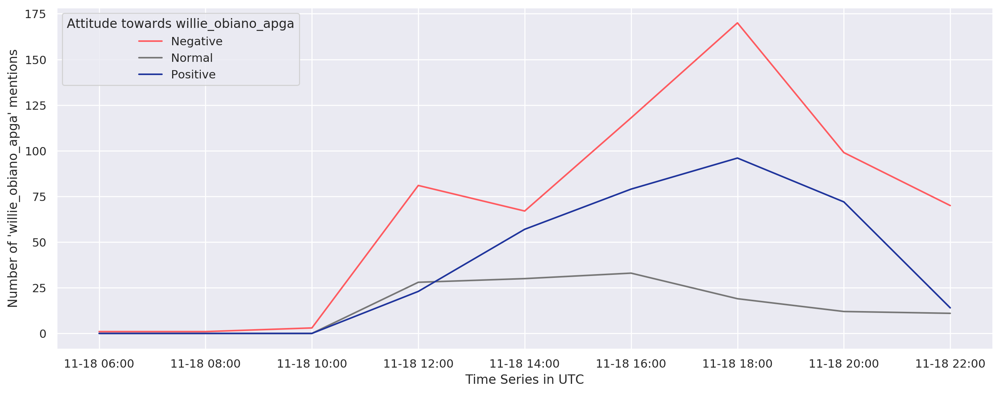

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'willie_obiano_apga' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

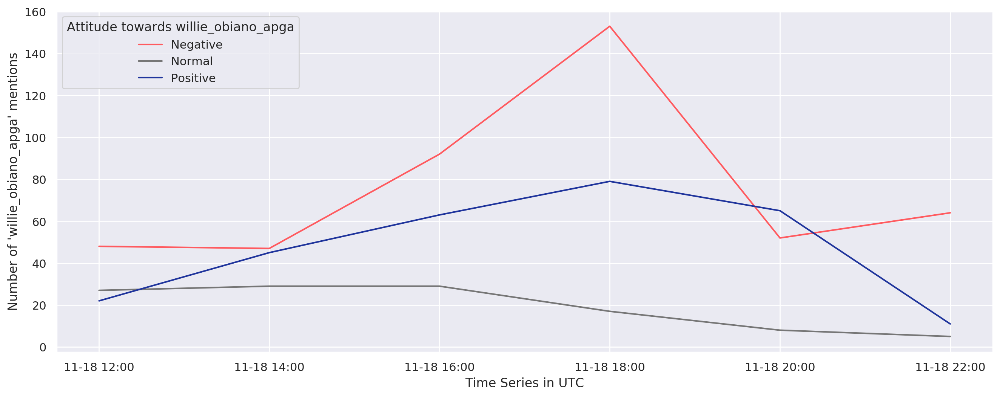

In [189]:
# Clean and transform data to enable time series
result = time_series_data_wo_apga.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()
result2 = time_series_data_apga_wo_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))
result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['willie_obiano_apga']
TABLE_NAME = "willie_obiano_apga"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards willie_obiano_apga', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards willie_obiano_apga', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 95722 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

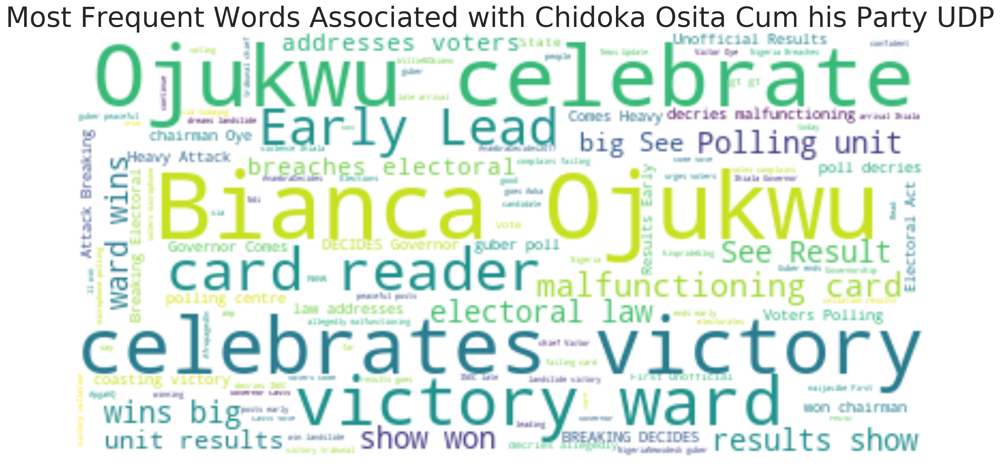

In [190]:
toks = time_series_data_apga_wo_only['tweet_tokens']
apgawotoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(apgawotoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(apgawotoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# oseloka_obaze

Negative Tweets Monitor: 
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters … https://t.co/ElXyKN9yvO
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters for boycotting the electi … https://t.co/SpEYqxTqlR
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters for boycotting the electi … https://t.co/DbbE1Dbaqe
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters for boycotting the electi … https://t.co/1crIKjp95I
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters for boycotting the electi … https://t.co/bk4s1xsw6q
  2  Anambra election : PDP ’ s Oseloka Obaze decries low turnout of voters as IPOB thanks voters for boycotting the electi … https://t.co/XWXNzOJWmU
  2  FYI : Anambra guber : Obaze pleads with voters to vote for him peacefully https://t.co/ej4OxynA

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'oseloka_obaze' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

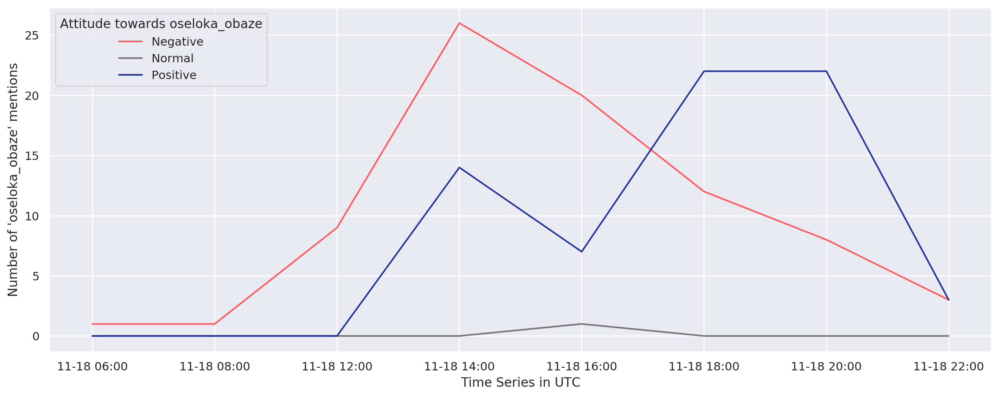

In [191]:
time_series_data_oseloka_obaze = data_for_time_series.loc[data_for_time_series['oseloka_obaze'] == True]
time_series_data_oseloka_obaze = time_series_data_oseloka_obaze.copy()

# UTC for date time at default
time_series_data_oseloka_obaze['created_at'] = pd.to_datetime(time_series_data_oseloka_obaze['created_at'])

print("Negative Tweets Monitor: ")
for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 2].iterrows():
    print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_oseloka_obaze.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['oseloka_obaze']
TABLE_NAME = "oseloka_obaze"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards oseloka_obaze', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'oseloka_obaze' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

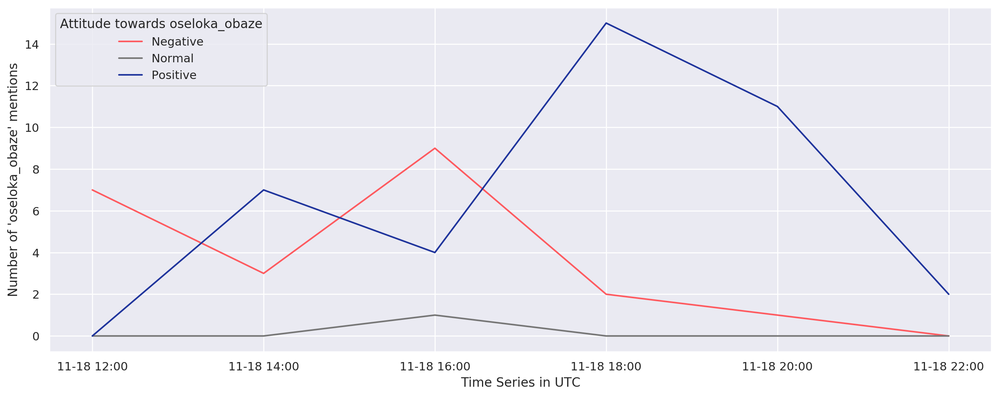

In [192]:
candidates_parties_obaze=['willie','obiano','nwoye','tony','godwin','ezeemo', 'osita','chidoka', 'apga','pdp','apc', 'ppa','udp']
pre = set()
for tweet in time_series_data_oseloka_obaze['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_obaze:
            pre.add(tweet)

time_series_data_obaze_only = time_series_data_oseloka_obaze[time_series_data_oseloka_obaze.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_obaze_only['created_at'] = pd.to_datetime(time_series_data_obaze_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_obaze_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['oseloka_obaze']
TABLE_NAME = "oseloka_obaze"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards oseloka_obaze', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 7213 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

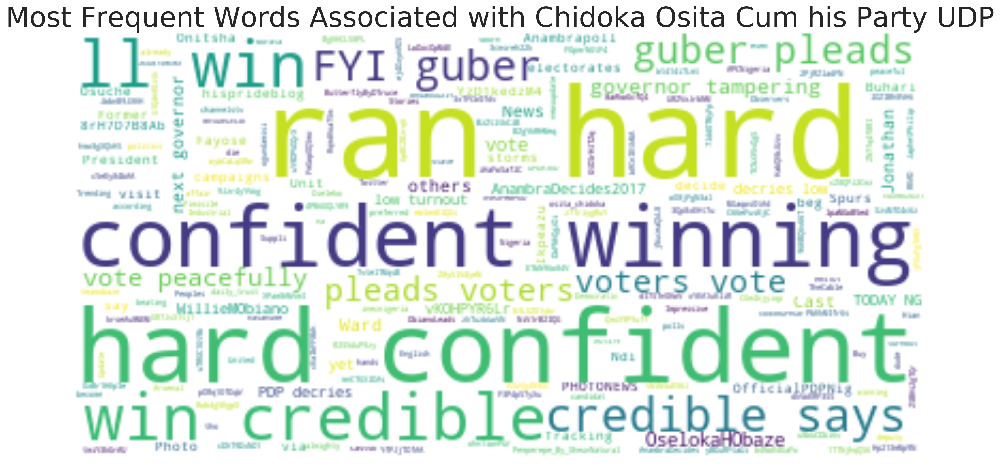

In [193]:
toks = time_series_data_obaze_only['tweet_tokens']
obazetoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(obazetoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(obazetoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# pdp

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'pdp' mentions"), Text(0.5, 0, 'Time Series in UTC')]

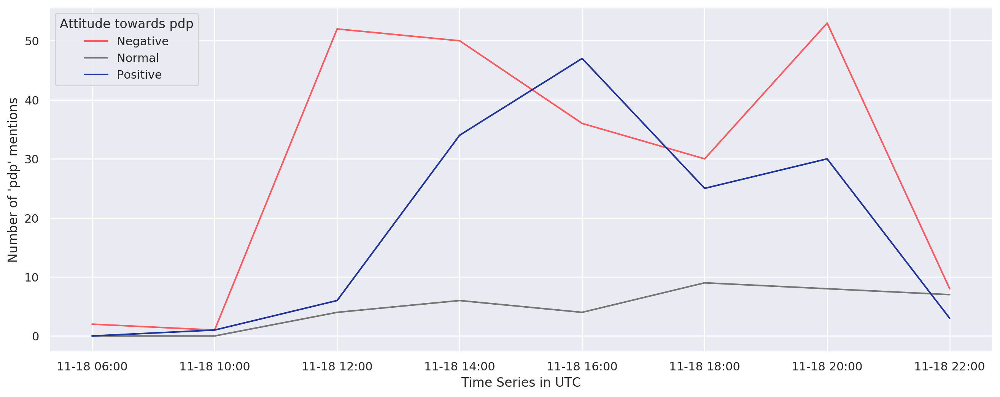

In [194]:
time_series_data_pdp = data_for_time_series.loc[data_for_time_series['pdp'] == True]
time_series_data_pdp = time_series_data_pdp.copy()

# UTC for date time at default
time_series_data_pdp['created_at'] = pd.to_datetime(time_series_data_pdp['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_pdp[time_series_data_pdp['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_pdp.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['pdp']
TABLE_NAME = "pdp"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards pdp', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'pdp' mentions"), Text(0.5, 0, 'Time Series in UTC')]

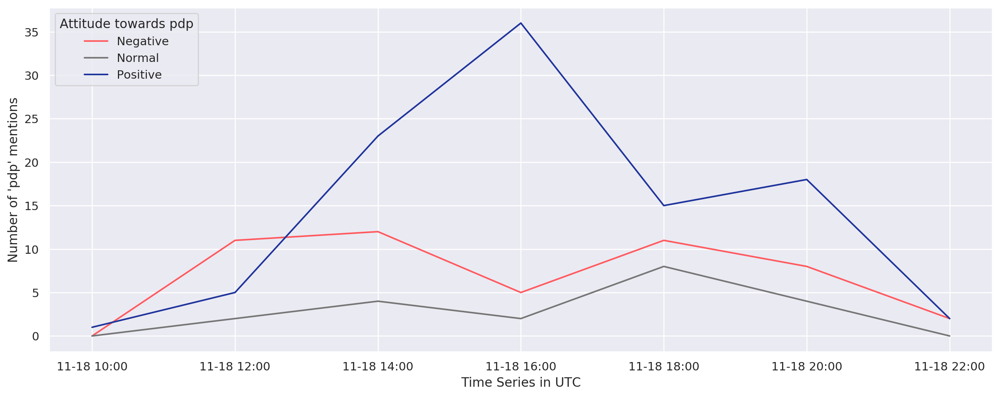

In [195]:
candidates_parties_pdp=['oseloka','obaze','willie','obiano','nwoye','tony','godwin','ezeemo', 'osita','chidoka', 'apga','apc', 'ppa','udp']

pre = set()
for tweet in time_series_data_pdp['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_pdp:
            pre.add(tweet)

time_series_data_pdp_only = time_series_data_pdp[time_series_data_pdp.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_pdp_only['created_at'] = pd.to_datetime(time_series_data_pdp_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_pdp_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['pdp']
TABLE_NAME = "pdp"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards pdp', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 18676 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

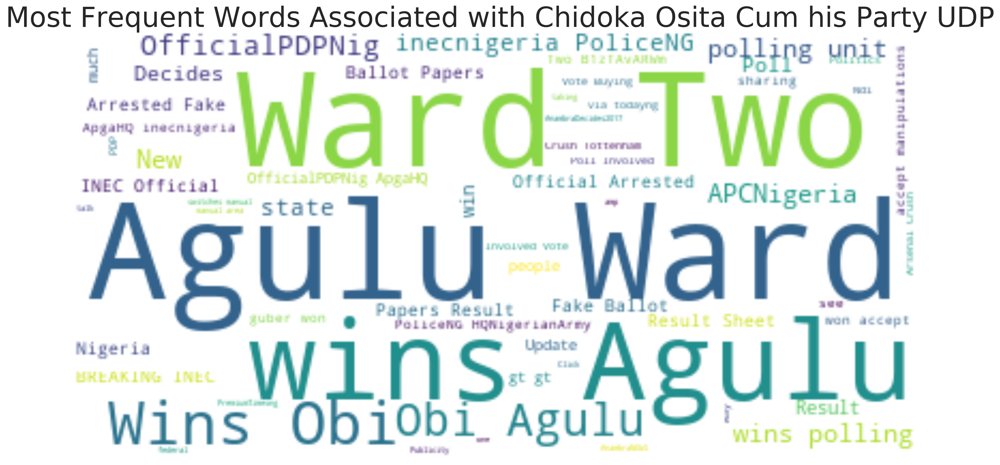

In [196]:
toks = time_series_data_pdp_only['tweet_tokens']
pdptoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(pdptoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(pdptoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# oseloka_obaze_pdp

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'oseloka_obaze_pdp' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

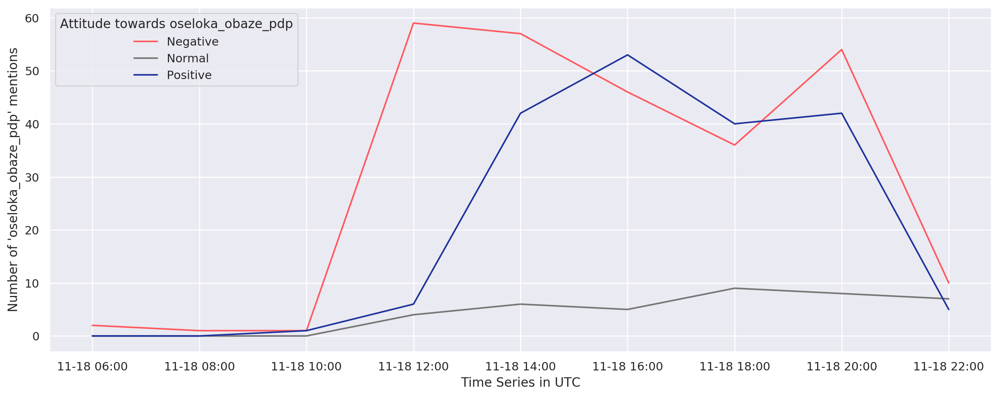

In [197]:
time_series_data_oseloka_obaze_pdp = data_for_time_series.loc[data_for_time_series['oseloka_obaze_pdp'] == True]
time_series_data_oseloka_obaze_pdp = time_series_data_oseloka_obaze_pdp.copy()

# UTC for date time at default
time_series_data_oseloka_obaze_pdp['created_at'] = pd.to_datetime(time_series_data_oseloka_obaze_pdp['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze_pdp[time_series_data_oseloka_obaze_pdp['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_oseloka_obaze_pdp.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['oseloka_obaze_pdp']
TABLE_NAME = "oseloka_obaze_pdp"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards oseloka_obaze_pdp', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'obaze pdp' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

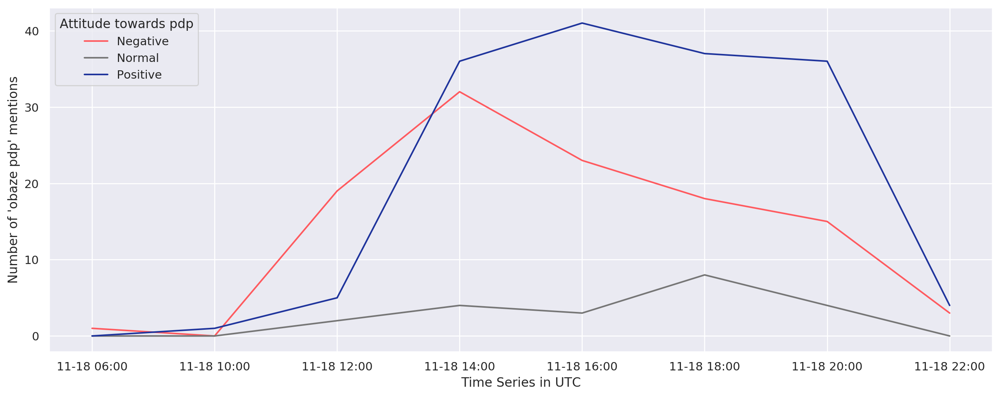

In [198]:
candidates_parties_pdp_obaze=['willie','obiano','nwoye','tony','godwin','ezeemo', 'osita','chidoka', 'apga','apc', 'ppa','udp']

pre = set()
for tweet in time_series_data_oseloka_obaze_pdp['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_pdp_obaze:
            pre.add(tweet)

time_series_data_pdp_obaze_only = time_series_data_oseloka_obaze_pdp[time_series_data_oseloka_obaze_pdp.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_pdp_obaze_only['created_at'] = pd.to_datetime(time_series_data_pdp_obaze_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_pdp_obaze_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['obaze pdp']
TABLE_NAME = "obaze pdp"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards pdp', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

In [199]:
for index, tweets in data_for_time_series[data_for_time_series['Sentiment_Polarity_Vals'] == 2].iterrows():
    print("  " +str(tweets[46]) + "  " + tweets[5])

  5  I'm rooting for you osita chidoka today as #AnambraDecides . You ran a superb , issues-based campaign and I wish you all the best today . Your success is Anambra's gain .
  0  #AnambraDecides2017 Today is Anambra Gubernatorial Election , one of the most anticipated elections in Nigeria and we call on @inecnigeria the @PoliceNG and other security agencies in the state to remain neutral . We urge Ndi Anambra to come out and vote . PDP . . . power to the people
  0  Osumoghu Ihiala , Anambra , BIAFRA . Biafrans didn't come out to vote . We are Biafrans and not Nigerians ! Free BIAFRA https://t.co/0TCaeP2nwB
  0  @Breakingpost_ng How many re they there ? How many people re they giving the money ? Anambra people really boycotted the election !
  0  #hisprideblog Large Turnout as Anambra Voters Defy IPOB Threats : By David-Chyddy Eleke in … https://t.co/AlMy4B2w2S
  0  Good luck to Anambra peeps . May the best man win . In other news , hope Chelsea wins at West Brom . And I miss my Mum 

  0  You have taken me home ! ! ! Thanks https://t.co/ThqUZNBQrT
  1  Anambra election : I ’ ll win with a landslide victory – Governor Obiano https://t.co/bJ3YJPtkeG
  5  Anambra election : Chidoka says his chances high with massive turnout in Anambra Central https://t.co/jq9CD09JnE https://t.co/3gMqnX3VC7
  0  Anambra guber poll records impressive turnout — Nigeria — The Guardian Nigeria Newspaper – Nigeria and World News https://t.co/d760SwlBU3
  5  Anambra election : Chidoka says his chances high with massive turnout in Anambra Central https://t.co/TjF5RzsrGv https://t.co/zWFBQbejR5
  0   @Amaka_Ekwo : Anambra Election : IPOB thanks electorates for ‘ boycotting ’ governorship poll - Daily Post Nigeria https://t.co/4BbQJ7Pamw 
  0  Anambra 2017 : Large Turnout of Voters Recorded at Polling Centres https://t.co/Czleq7mlt3 https://t.co/HjY4AXMsur
  0  Anambra 2017 : Large Turnout of Voters Recorded at Polling Centres https://t.co/9Adyx60HYx https://t.co/LC6feYabcr
  0  Anambra 2017 : 

  1  Anambra election : I will win , says Obiano https://t.co/Hx2f0JFQSW
  0  Dear Lord , all I want is that the next Governor of Anambra look into the issue of high dropout rate of boys from sec sch #AnambraDecides2017
  0  Anambra Election : Yul Edochie Denies Stepping Down , Threatens Legal Action ( Pic ) https://t.co/tM1xLOi4VO
  0  Lol . @akaebube , you always excite ! https://t.co/WpsN52rhD6
  2  Obaze : I will be Anambra governor if there ’ s no tampering … I ran hard to win | TheCable https://t.co/YzD1kedzM4 … https://t.co/0xBr1HKpIe
  1  Anambra Election : Obiano Breaches Electoral Law , Addresses Voters In Polling Center READ MORE : … https://t.co/jE5oro8BNB
  0  * Live Updates : Anambra election ( Punch ) * Election : Anambra witnesses water-tight security ( Guardian ) : SABINEWS … https://t.co/hpm1LnckrH
  0  Dear Lord , open the eyes of the next Governor of Anambra to know that every child has the right to access excellent #edu #AnambraDecides2017
  0  First of , why do he

  0  Anambra Guber : PDP Wins in Peter Obi's Agulu Ward Two https://t.co/JyL2jK8Ihp https://t.co/DJwu4U3B1y
  1  Anambra Guber poll records good turn out of Voter as results trickle in @WillieMObiano @NGRPresident @MBuhari … https://t.co/CJ7j4zmE1a
  0  @julietkego You easily showed welcome to Anambra but find it difficult to show were people are voting . . .
  1  Anambra election : APGA's Obiano leads in early ' results ' as APC's Nwoye cries foul : Ballot counting has begun in … … https://t.co/utsM53vHke
  1  Anambra election : APGA's Obiano leads in early ' results ' as APC's Nwoye cries foul https://t.co/4LGsk5ofBf https://t.co/zQwcDHTS93
  1  Anambra election : APGA's Obiano leads in early ' results ' as APC's Nwoye cries foul https://t.co/OWlkdU2mIR https://t.co/4gvWu3ENr9
  1  Anambra election : APGA's Obiano leads in early ' results ' as APC's Nwoye cries foul https://t.co/mrQmfe30GN https://t.co/1obffXb6TB
  1  Anambra election : APGA's Obiano leads in early ' results ' as APC

  0  I missed most of the Anambra Election coverage why ? I had a deadline for a software to finish off . @BWemimoTVC @EstherTVCnews @tvcnewsng
  0  Politics : Counting ongoing in most areas in Anambra poll https://t.co/V0UbmOps8l
  0  Anambra Election : Yul Edochie Denies Stepping Down , Threatens Legal Action https://t.co/CeyCG1XwGb
  2  Anambra : I ’ ll win if election is credible , says Obaze https://t.co/cKaIbFF8bh
  0  Anambra poll : Speaker commends peaceful conduct https://t.co/xduuPjF2nM
  0  CLASSIC : See Inside The Elegant And Exquisite Palace Of A King In Anambra State ( Photos ) https://t.co/SKJP2sIbRV #BongoByEbiscoSugar
  0  Anambra Poll : Speaker Commends Peaceful Conduct https://t.co/zrAIz7L7cN https://t.co/BvJXkzI317
  3  When a nauseating PMB went to Anambra to campaign for Nwoye , was he going there to show the very intelligent . . . https://t.co/LsCV5YFhcp
  0  Anambra Election : Yul Edochie Denies Stepping Down , Threatens Legal Action https://t.co/uqA6Vv0nDC
  0 

There are 33037 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

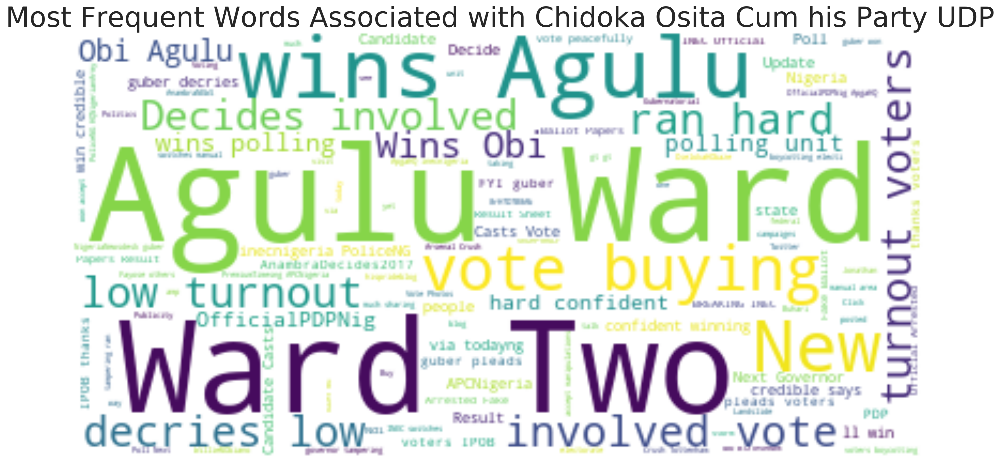

In [200]:
toks = time_series_data_pdp_obaze_only['tweet_tokens']
obazepdptoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(obazepdptoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(obazepdptoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# nwoye_tony

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'nwoye_tony' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

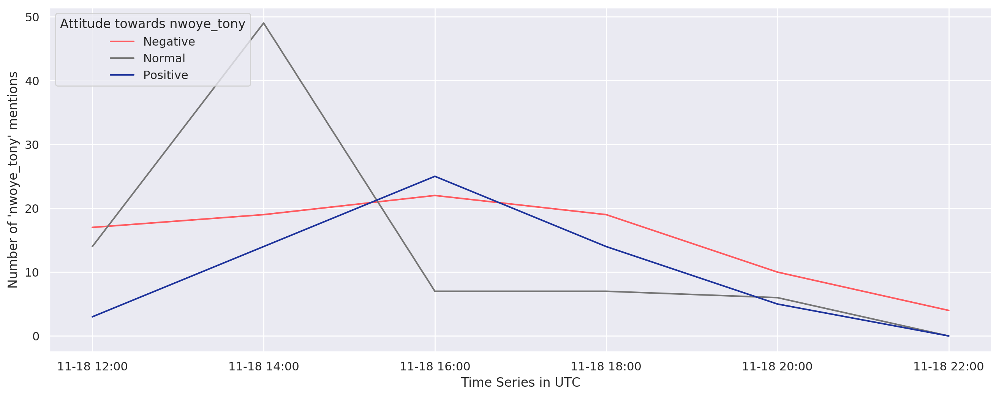

In [201]:
time_series_data_nwoye_tony = data_for_time_series.loc[data_for_time_series['nwoye_tony'] == True]
time_series_data_nwoye_tony = time_series_data_nwoye_tony.copy()

# UTC for date time at default
time_series_data_nwoye_tony['created_at'] = pd.to_datetime(time_series_data_nwoye_tony['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_nwoye_tony[time_series_data_nwoye_tony['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_nwoye_tony.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['nwoye_tony']
TABLE_NAME = "nwoye_tony"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards nwoye_tony', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'tony' mentions"), Text(0.5, 0, 'Time Series in UTC')]

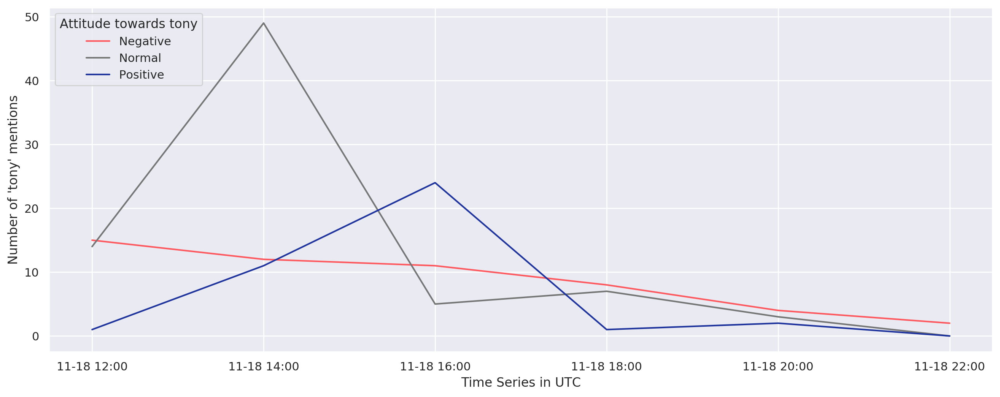

In [202]:
candidates_parties_tony=['willie','obiano','oseloka','obaze','godwin','ezeemo', 'osita','chidoka', 'apga','apc', 'pdp','ppa','udp']

pre = set()
for tweet in time_series_data_nwoye_tony['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_tony:
            pre.add(tweet)

time_series_data_tony_only = time_series_data_nwoye_tony[time_series_data_nwoye_tony.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_tony_only['created_at'] = pd.to_datetime(time_series_data_tony_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_tony_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['tony']
TABLE_NAME = "tony"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards tony', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 20843 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

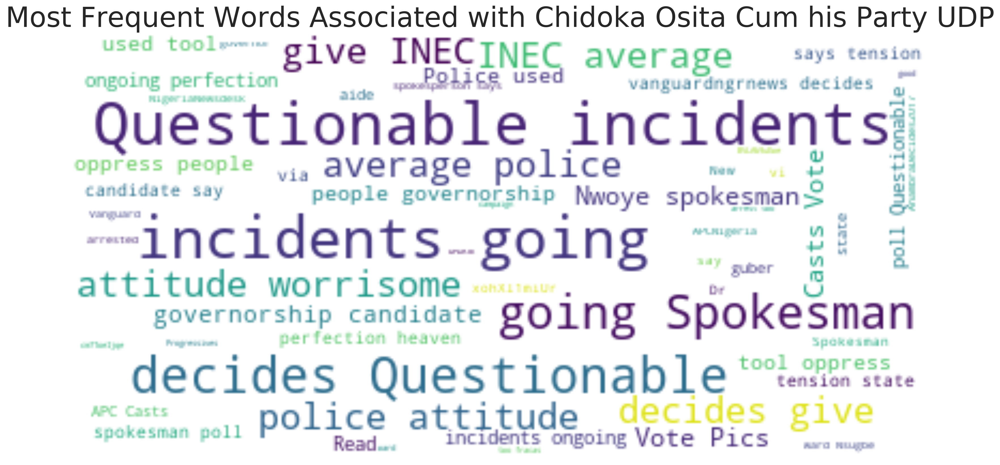

In [203]:
toks = time_series_data_tony_only['tweet_tokens']
tonytoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(tonytoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(tonytoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# apc

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'apc' mentions"), Text(0.5, 0, 'Time Series in UTC')]

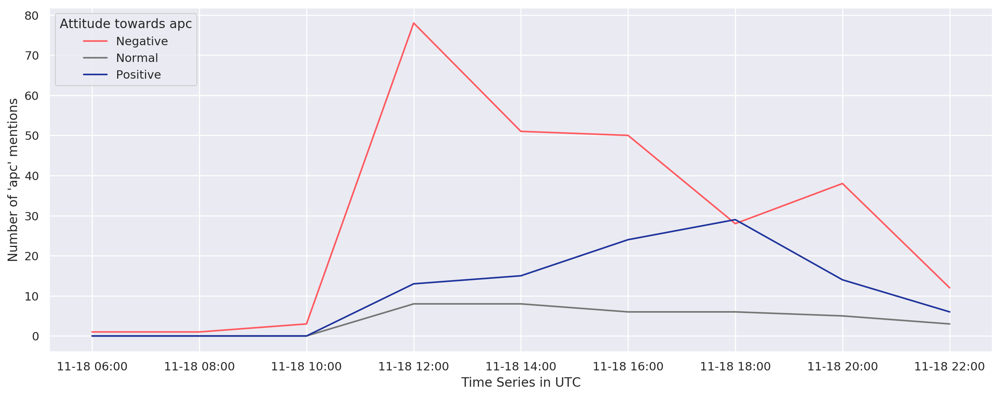

In [204]:
time_series_data_apc = data_for_time_series.loc[data_for_time_series['apc'] == True]
time_series_data_apc = time_series_data_apc.copy()

# UTC for date time at default
time_series_data_apc['created_at'] = pd.to_datetime(time_series_data_apc['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_apc[time_series_data_apc['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_apc.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))


TRACK_WORDS = ['apc']
TABLE_NAME = "apc"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards apc', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'apc' mentions"), Text(0.5, 0, 'Time Series in UTC')]

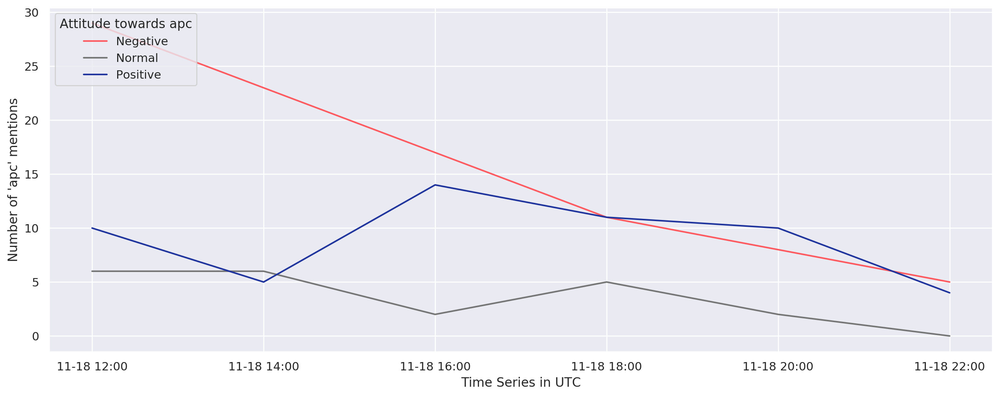

In [205]:
candidates_parties_apc=['willie','obiano','oseloka','obaze','nwoye','tony','godwin','ezeemo', 'osita',
                        'chidoka', 'apga', 'pdp','ppa','udp','officialpdpnig','apgahq']

pre = set()
for tweet in time_series_data_apc['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_apc:
            pre.add(tweet)

time_series_data_apc_only = time_series_data_apc[time_series_data_apc.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_apc_only['created_at'] = pd.to_datetime(time_series_data_apc_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_apc_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['apc']
TABLE_NAME = "apc"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards apc', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 18875 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

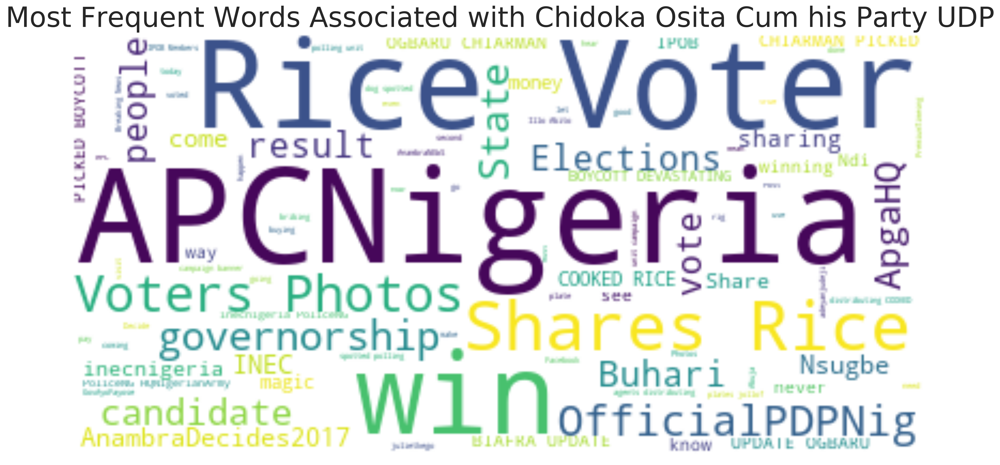

In [206]:
toks = time_series_data_apc_only['tweet_tokens']
apctoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(apctoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(apctoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# nwoye_tony_apc

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'nwoye_tony_apc' mentions"),
 Text(0.5, 0, 'Time Series in UTC')]

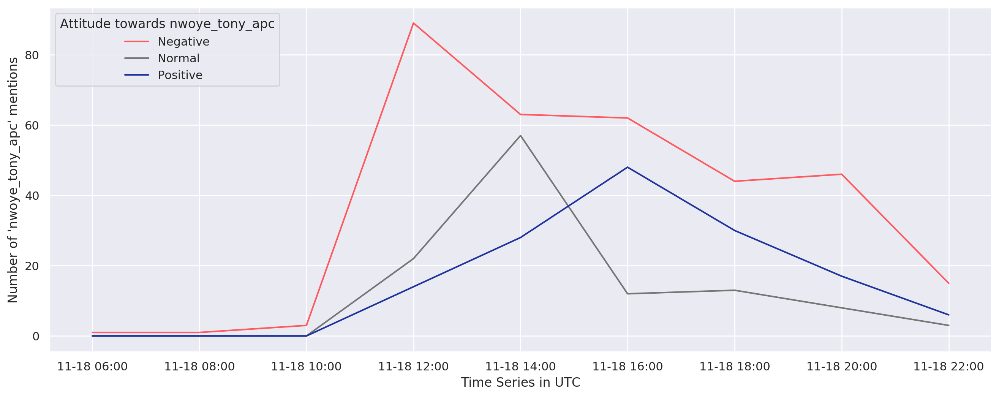

In [207]:
time_series_data_nwoye_tony_apc = data_for_time_series.loc[data_for_time_series['nwoye_tony_apc'] == True]
time_series_data_nwoye_tony_apc = time_series_data_nwoye_tony_apc.copy()

# UTC for date time at default
time_series_data_nwoye_tony_apc['created_at'] = pd.to_datetime(time_series_data_nwoye_tony_apc['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_nwoye_tony_apc[time_series_data_nwoye_tony_apc['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series
result = time_series_data_nwoye_tony_apc.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result['created_at'] = pd.to_datetime(result['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['nwoye_tony_apc']
TABLE_NAME = "nwoye_tony_apc"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards nwoye_tony_apc', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

<Figure size 3200x1200 with 0 Axes>

[Text(0, 0.5, "Number of 'apc' mentions"), Text(0.5, 0, 'Time Series in UTC')]

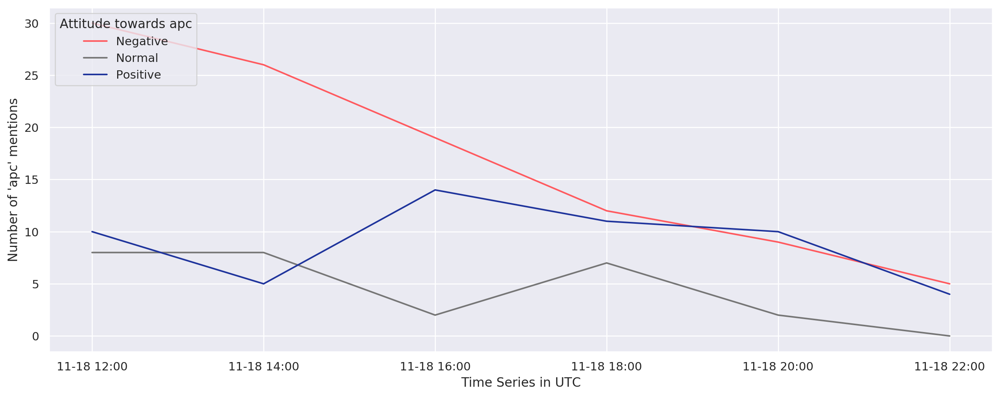

In [208]:
candidates_parties_apc_tony=['willie','obiano','oseloka','obaze','nwoye','tony','godwin','ezeemo', 'osita',
                        'chidoka', 'apga', 'pdp','ppa','udp','officialpdpnig','apgahq']

pre = set()
for tweet in time_series_data_nwoye_tony_apc['text']:
    words = [w.lower() for w in tweet.split()]
    
    for w in words:
        if w.lower() in candidates_parties_apc_tony:
            pre.add(tweet)

time_series_data_apc_tony_only = time_series_data_nwoye_tony_apc[time_series_data_nwoye_tony_apc.text.isin(pre)==False].dropna()

# UTC for date time at default
time_series_data_apc_tony_only['created_at'] = pd.to_datetime(time_series_data_apc_tony_only['created_at'])

# print("Negative Tweets Monitor: ")
# for index, tweets in time_series_data_oseloka_obaze[time_series_data_oseloka_obaze['Sentiment_Polarity_Vals'] == 1].iterrows():
#     print("  " +str(tweets[46]) + "  " + tweets[5])
    
# Clean and transform data to enable time series

result2 = time_series_data_apc_tony_only.groupby([pd.Grouper(key='created_at', freq='2h'), 'Sentiment_Polarity_Vals']).count() \
        .unstack(fill_value=0).stack().reset_index()

result2['created_at'] = pd.to_datetime(result2['created_at']).apply(lambda x: x.strftime('%m-%d %H:%M'))

TRACK_WORDS = ['apc']
TABLE_NAME = "apc"
TABLE_ATTRIBUTES = "id_str VARCHAR(255), created_at DATETIME, text VARCHAR(255), \
            polarity INT, subjectivity INT, user_created_at VARCHAR(255), user_location VARCHAR(255), \
            user_description VARCHAR(255), user_followers_count INT, longitude DOUBLE, latitude DOUBLE, \
            retweet_count INT, favorite_count INT"

# Plot Line Chart for monitoring brand awareness on Twitter
mpl.rcParams['figure.dpi']= 200
plt.figure(figsize=(16, 6))
sns.set(style="darkgrid")
ax = sns.lineplot(x = "created_at" ,y="id", hue='Sentiment_Polarity_Vals', data=result2,\
                  palette=sns.color_palette(["#FF5A5F", "#767676","#1f349c"]))
ax.set(xlabel='Time Series in UTC', ylabel="Number of '{}' mentions".format(TRACK_WORDS[0]))
plt.legend(title='Attitude towards apc', loc='upper left', labels=['Negative', 'Normal', 'Positive'])
sns.set(rc={"lines.linewidth": 1})
plt.show()

There are 20556 words in the combination of all tweets.


<Figure size 4000x2000 with 0 Axes>

Text(0.5, 1.0, 'Most Frequent Words Associated with Chidoka Osita Cum his Party UDP')

(-0.5, 399.5, 199.5, -0.5)

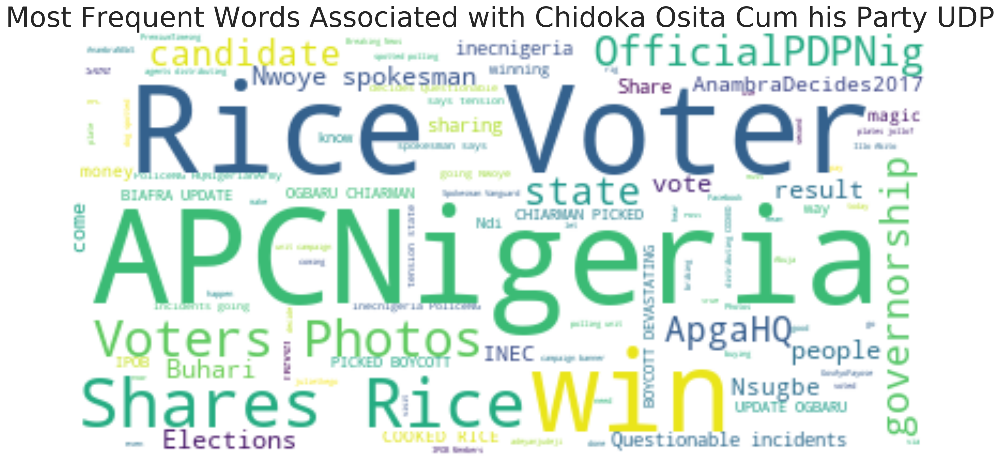

In [209]:
toks = time_series_data_apc_tony_only['tweet_tokens']
tonyapctoks = " ".join(" ".join(t) for t in toks)
print ("There are {} words in the combination of all tweets.".format(len(tonyapctoks)))

stopwords = set(STOPWORDS)
stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita'])

# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(tonyapctoks)

# Display the generated image:
# the matplotlib way:
plt.figure( figsize=(20,10) )
plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

# Topic Tracking with Natural Language Processing using RE & NLTK

#### In order to tracking the hottest words or the most frequency tokens in the tweets, we join all tweet texts, remove the urls, clean the ‘RT’ and ‘&’ (a.k.a. ‘&amp;’ )symbols, and convert all characters into lowercases.

In [210]:
content = ' '.join(originals["text"])
content = re.sub(r"http\S+", "", content)
content = content.replace('RT ', ' ').replace('&amp;', 'and')
content = re.sub('[^A-Za-z0-9]+', ' ', content)
content = content.lower()

In [211]:
from nltk.corpus import stopwords

tokenized_word = word_tokenize(content)
stop_words=set(stopwords.words("english"))
filtered_sent=[]
for w in tokenized_word:
    if w not in stop_words:
        filtered_sent.append(w)
fdist = FreqDist(filtered_sent)
fd = pd.DataFrame(fdist.most_common(15),                    \
    columns = ["Word","Frequency"]).drop([0]).reindex()

In [212]:
fig = px.bar(fd, x="Word", y="Frequency")
fig.update_traces(marker_color='rgb(240,128,128)',          \
    marker_line_color='rgb(8,48,107)',                      \
    marker_line_width=1.5, opacity=0.8)
fig.show()

In [213]:
time_series_data_wo_only

,id,date,query_string,location,user,text,apga,pdp,apc,ppa,...,Sentiment_Subjectivity_Vals,sc_sentiwordnet,pol_sentiwordnet,sc_sentivader,pol_sentivader,contestants_val,partynames_vals,partynames_contestants_vals,pnames,created_at
61,931858046267076608,Sat Nov 18 12:14:05 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:14:05
73,931858293571629057,Sat Nov 18 12:15:04 +0000 2017,anambra,"Aba, Nigeria",Puo Reports,Anambra guber : I ’ ll win with a landslide vi...,False,False,False,False,...,2,2,0.500,2,0.5859,1,0,1,apga,2017-11-18 12:15:04
81,931858440779124737,Sat Nov 18 12:15:40 +0000 2017,anambra,Nigeria,PTCIJ,Anambra Election : Obiano ‘ breaches ’ elector...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 12:15:40
105,931859323076120581,Sat Nov 18 12:19:10 +0000 2017,anambra,"Lagos, Nigeria",NAIJ.com,. @ApgaHQ candidate and gov Obiano cast his vo...,True,False,False,False,...,2,2,0.500,2,0.4939,1,1,1,apga,2017-11-18 12:19:10
128,931859871250690051,Sat Nov 18 12:21:21 +0000 2017,anambra,Nigeria,Dhiqrullah,. ApgaHQ candidate and gov Obiano cast his vot...,True,False,False,False,...,2,2,0.500,2,0.4939,1,1,1,apga,2017-11-18 12:21:21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7401,932019602741014528,Sat Nov 18 22:56:04 +0000 2017,anambra,Nigeria,Daily Nigeria News,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,0,0.000,0,0.0000,1,0,1,apga,2017-11-18 22:56:04
7419,932020357589975040,Sat Nov 18 22:59:04 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7420,932020359397761024,Sat Nov 18 22:59:04 +0000 2017,anambra,LAGOS,TONI KAN,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:04
7421,932020477958111232,Sat Nov 18 22:59:32 +0000 2017,anambra,"Lagos, Nigeria",sabinews,Anambra election : Obiano coasting to victory ...,False,False,False,False,...,0,2,0.375,0,0.0000,1,0,1,apga,2017-11-18 22:59:32


In [214]:
dfs = [(time_series_data_wo_only,'Willie Obiano'),(time_series_data_apga_only,'APGA'),(time_series_data_apga_wo_only,'willie Obiano+APGA'),
       (time_series_data_obaze_only,'Obaze Oseloka'),(time_series_data_pdp_only,'PDP'),(time_series_data_pdp_obaze_only,'Obaze Oseloka+PDP'),
      (time_series_data_tony_only,'Tony Nwoye'),(time_series_data_apc_only,'APC'),(time_series_data_apc_tony_only,'Tony Nwoye+APC')]

list_of_pola_plots = []
list_of_subj_plots = []
# time_range = [
#                 ('2017-11-18 06:00:00','2017-11-18 13:00:00','breakfast'),
#                 ('2017-11-18 13:00:00','2017-11-18 19:00:00','lunch_tea'),
#                 ('2017-11-18 19:00:00','2017-11-18 23:59:59','supper')
#             ]

time_range =  [
                    ('2017-11-18 06:00:00','2017-11-18 08:00:00','6-8'),
                    ('2017-11-18 08:00:00','2017-11-18 10:00:00','8-10'),
                    ('2017-11-18 10:00:00','2017-11-18 12:00:00','10-12'),
                    ('2017-11-18 12:00:00','2017-11-18 14:00:00','12-14'),
                    ('2017-11-18 14:00:00','2017-11-18 16:00:00','14-16'),
                    ('2017-11-18 16:00:00','2017-11-18 18:00:00','16-18'),
                    ('2017-11-18 18:00:00','2017-11-18 20:00:00','18-20'),
                    ('2017-11-18 20:00:00','2017-11-18 23:59:59','20-00')
                ]

# time_range = [
#                 ('2017-11-18 06:00:00','2017-11-18 07:00:00','6-7'),
#                 ('2017-11-18 07:00:00','2017-11-18 08:00:00','7-8'),
#                 ('2017-11-18 08:00:00','2017-11-18 09:00:00','8-9'),
#                 ('2017-11-18 09:00:00','2017-11-18 10:00:00','9-10'),
#                 ('2017-11-18 10:00:00','2017-11-18 11:00:00','10-11'),
#                 ('2017-11-18 11:00:00','2017-11-18 12:00:00','11-12'),
#                 ('2017-11-18 12:00:00','2017-11-18 13:00:00','12-13'),
#                 ('2017-11-18 13:00:00','2017-11-18 14:00:00','13-14'),
#                 ('2017-11-18 14:00:00','2017-11-18 15:00:00','14-15'),
#                 ('2017-11-18 15:00:00','2017-11-18 16:00:00','15-16'),
#                 ('2017-11-18 16:00:00','2017-11-18 17:00:00','16-17'),
#                 ('2017-11-18 17:00:00','2017-11-18 18:00:00','17-18'),
#                 ('2017-11-18 18:00:00','2017-11-18 19:00:00','18-19'),
#                 ('2017-11-18 19:00:00','2017-11-18 20:00:00','19-20'),
#                 ('2017-11-18 20:00:00','2017-11-18 21:00:00','20-21'),
#                 ('2017-11-18 21:00:00','2017-11-18 22:00:00','21-22'),
#                 ('2017-11-18 22:00:00','2017-11-18 23:59:59','22-00')
#             ]

dic_words = defaultdict(list)

def ave(v):
    sumsc = sum(v)
    no_of_tweets = len(v)
    if no_of_tweets != 0:
        avesc = (sumsc/no_of_tweets)*100
    else:
        avesc = 0
    return avesc,sumsc,no_of_tweets


def clean_tok(text):
    content = ' '.join(text)
    content = re.sub(r"http\S+", "", content)
    content = content.replace('RT ', ' ').replace('&amp;', 'and')
    content = re.sub('[^A-Za-z0-9]+', ' ', content)
    content = content.lower()
    tokenized_word = word_tokenize(content)
    return tokenized_word



In [215]:
from nltk.corpus import stopwords

stop_words=set(stopwords.words("english"))
stop_words.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita',
                  'votes','vote','governor','oselokahobaze','officialpdpnig','apcnigeria','anambranews','voters',
                   'polling','poling','unit','ward','apgahq','2','6','anambradecides2017'])

for df,name in dfs:
    for t in time_range:
        start_date = pd.to_datetime(t[0])
        end_date = pd.to_datetime(t[1])
        
        print('=====================================')
        print(start_date,end_date)

        key = name+' '+t[2]
        print(key)

        df_slice = df.loc[(df['created_at'] > start_date) & (df['created_at'] < end_date)]
        print(df_slice["text"])
    
        list_words = clean_tok(df_slice["text"])
        print(list_words)
        for w in list_words:
            w = w.lower()
            if w not in stop_words:
                dic_words[key].append(w)
        
        
        wo_pol = ave(df_slice['Sentiment_Polarity'])
        list_of_pola_plots.append( (wo_pol[0],name,t[2]) )
#         print(list_of_pola_plots,wo_pol[1],wo_pol[2])

        wo_subj = ave(df_slice['Sentiment_Subjectivity'])
        list_of_subj_plots.append( (wo_subj[0],name,t[2]) )
#         print(list_of_subj_plots,wo_subj[1],wo_subj[2])

2017-11-18 06:00:00 2017-11-18 08:00:00
Willie Obiano 6-8
Series([], Name: text, dtype: object)
[]
2017-11-18 08:00:00 2017-11-18 10:00:00
Willie Obiano 8-10
Series([], Name: text, dtype: object)
[]
2017-11-18 10:00:00 2017-11-18 12:00:00
Willie Obiano 10-12
Series([], Name: text, dtype: object)
[]
2017-11-18 12:00:00 2017-11-18 14:00:00
Willie Obiano 12-14
61      Anambra Election : Obiano ‘ breaches ’ elector...
73      Anambra guber : I ’ ll win with a landslide vi...
81      Anambra Election : Obiano ‘ breaches ’ elector...
105     . @ApgaHQ candidate and gov Obiano cast his vo...
128     . ApgaHQ candidate and gov Obiano cast his vot...
                              ...                        
1857    Ndị Anambra is voting 😁 #ReElectObiano https:/...
1872    Anambra Election : Obiano ‘ breaches ’ elector...
1895    Anambra Election : Did Obiano Violate Nigeria'...
1900    Nigeria : Anambra Election – Obiano ' Breaches...
1901    Anambra election : I ’ ll win with a landslide...
Na

['anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'it', 'appears', 'anambra', 'voters', 'don', 't', 'watch', 'debates', 'but', 'know', 'their', 'own', 'debate', 'or', 'no', 'debates', 'willie', 'obiano', 'is', 'coasting', 'to', 'victory', 'anambra', 'election', 'obiano', 'urges', 'voters', 'come', 'out', 'vote', 'decries', 'inec', 's', 'late', 'ar', 'nigeria', 'news', 'newspapers', 'nairanews', 'hisprideblog', 'anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'the', 'all', 'anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'anambra', 'guber', 'poll', 'apga', 'decries', 'malfunctioning', 'card', 'readers', 'continue', 'here', 'anambra', 'decides', 'results', 'nibo', 'ward', '3', 'pu', '008', 'nkwoumuagbobia', 'apga', '95'

6137    Anambra decides : Questionable incidents going...
6146    INTELLIGENT GIST : DR . TONY NWOYE : Biography...
6162    Anambra Election : Nwoye ’ s spokesperson says...
6163    Anambra Election : Nwoye ’ s spokesperson says...
6306    NWOYE ’ S SPOKESMAN ON ANAMBRA POLL : QUESTION...
6486    Congrats in advance to my incoming Governor of...
6605    A yoruba man in Lagos is schooling us on Tony ...
6724    Anambra Guber : How Tony Nwoye and the Chris U...
7053    When a nauseating PMB went to Anambra to campa...
7303    Tony Nwoye should not have brought @MBuhari to...
7392    @bashiryusuf Where did Tony Nwoye get the mill...
Name: text, dtype: object
['anambra', 'decides', 'questionable', 'incidents', 'going', 'on', 'in', 'anambra', 'election', 'nwoye', 's', 'spokesman', 'more', 'trending', 'stor', 'intelligent', 'gist', 'dr', 'tony', 'nwoye', 'biography', 'of', 'anambra', 'state', '2017', 'gu', 'anambra', 'election', 'nwoye', 's', 'spokesperson', 'says', 'questionable', 'incident

In [216]:
list_of_pola_plots

[(0, 'Willie Obiano', '6-8'),
 (0, 'Willie Obiano', '8-10'),
 (0, 'Willie Obiano', '10-12'),
 (7.752808988764044, 'Willie Obiano', '12-14'),
 (8.084415584415586, 'Willie Obiano', '14-16'),
 (9.879084967320258, 'Willie Obiano', '16-18'),
 (9.776252210231085, 'Willie Obiano', '18-20'),
 (2.8108393168634134, 'Willie Obiano', '20-00'),
 (0, 'APGA', '6-8'),
 (0, 'APGA', '8-10'),
 (0, 'APGA', '10-12'),
 (12.896825396825395, 'APGA', '12-14'),
 (16.423400673400675, 'APGA', '14-16'),
 (5.304805871212119, 'APGA', '16-18'),
 (5.686131386861314, 'APGA', '18-20'),
 (11.777371933621929, 'APGA', '20-00'),
 (0, 'willie Obiano+APGA', '6-8'),
 (0, 'willie Obiano+APGA', '8-10'),
 (0, 'willie Obiano+APGA', '10-12'),
 (8.10382916053019, 'willie Obiano+APGA', '12-14'),
 (10.34341347357876, 'willie Obiano+APGA', '14-16'),
 (7.128252635046114, 'willie Obiano+APGA', '16-18'),
 (6.076762678419312, 'willie Obiano+APGA', '18-20'),
 (6.939506857189784, 'willie Obiano+APGA', '20-00'),
 (0, 'Obaze Oseloka', '6-8'),


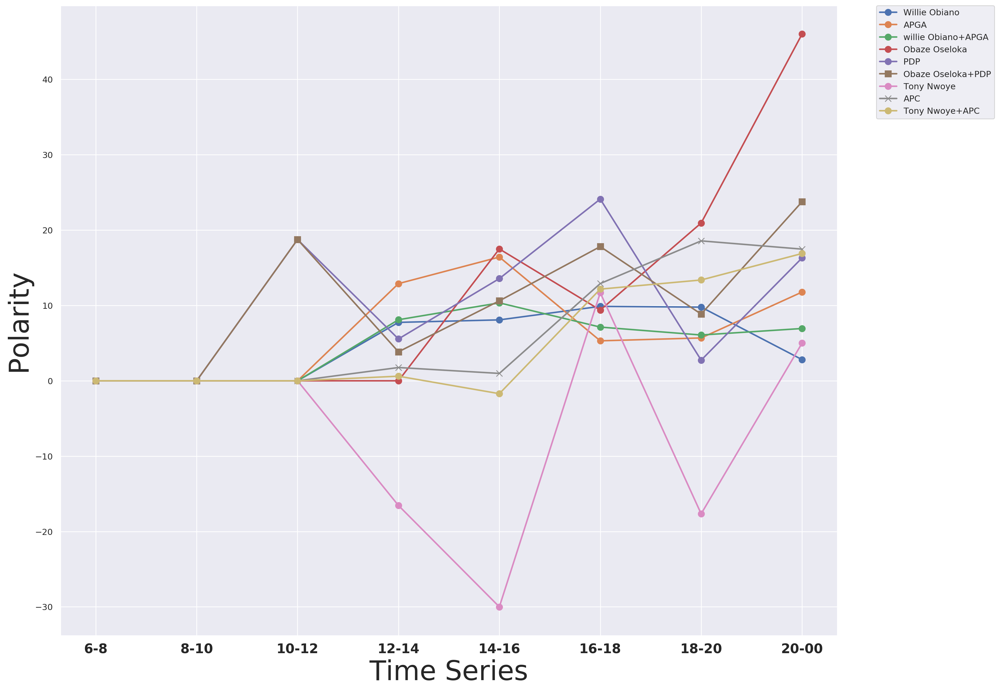

In [217]:
#Plot a line graph
d1 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'Willie Obiano']
d2 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'APGA']
d3 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'willie Obiano+APGA']
d4 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'Obaze Oseloka']
d5 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'PDP']
d6 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'Obaze Oseloka+PDP']
d7 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'Tony Nwoye']
d8 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'APC']
d9 = [sc[0] for sc in list_of_pola_plots if sc[1] == 'Tony Nwoye+APC']

x = ['6-8','8-10','10-12','12-14','14-16','16-18','18-20','20-00']
# x = ['6-7','7-8','8-9','9-10','10-11','11-12','12-13','13-14','14-15','15-16',
#      '16-17','17-18','18-19','19-20','20-21','21-22','22-00']
# Define plot space
fig, ax = plt.subplots(figsize=(18, 15))

# Define x and y axes
ax.plot(x, d1,'-o', label='Willie Obiano',linewidth=2,markersize=8)
ax.plot(x, d2,'-o', label='APGA',linewidth=2,markersize=8)
ax.plot(x, d3,'-o', label='willie Obiano+APGA',linewidth=2,markersize=8)
ax.plot(x, d4,'-o', label='Obaze Oseloka',linewidth=2,markersize=8)
ax.plot(x, d5,'-o', label='PDP',linewidth=2,markersize=8)
ax.plot(x, d6,'-s', label='Obaze Oseloka+PDP',linewidth=2,markersize=8)
ax.plot(x, d7,'-o', label='Tony Nwoye',linewidth=2,markersize=8)
ax.plot(x, d8,'-x', label='APC',linewidth=2,markersize=8)
ax.plot(x, d9,'-o', label='Tony Nwoye+APC',linewidth=2,markersize=8)

ax.set_xticks(x)
ax.set_xticklabels(x,fontsize=17,fontweight='bold')
# plt.title('My title')
plt.xlabel('Time Series',fontsize=35)
plt.ylabel('Polarity',fontsize=35)

leg = ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.);

In [218]:
list_of_subj_plots

[(0, 'Willie Obiano', '6-8'),
 (0, 'Willie Obiano', '8-10'),
 (0, 'Willie Obiano', '10-12'),
 (29.263420724094868, 'Willie Obiano', '12-14'),
 (30.396825396825395, 'Willie Obiano', '14-16'),
 (22.359477124183005, 'Willie Obiano', '16-18'),
 (27.56036217303823, 'Willie Obiano', '18-20'),
 (6.708449961462007, 'Willie Obiano', '20-00'),
 (0, 'APGA', '6-8'),
 (0, 'APGA', '8-10'),
 (0, 'APGA', '10-12'),
 (32.06349206349206, 'APGA', '12-14'),
 (28.17676767676768, 'APGA', '14-16'),
 (13.911153950216443, 'APGA', '16-18'),
 (10.424574209245744, 'APGA', '18-20'),
 (23.17573051948055, 'APGA', '20-00'),
 (0, 'willie Obiano+APGA', '6-8'),
 (0, 'willie Obiano+APGA', '8-10'),
 (0, 'willie Obiano+APGA', '10-12'),
 (29.00016363933889, 'willie Obiano+APGA', '12-14'),
 (28.582728107521486, 'willie Obiano+APGA', '14-16'),
 (17.50824236150323, 'willie Obiano+APGA', '16-18'),
 (14.236756550009563, 'willie Obiano+APGA', '18-20'),
 (13.919818099696158, 'willie Obiano+APGA', '20-00'),
 (0, 'Obaze Oseloka', '6-

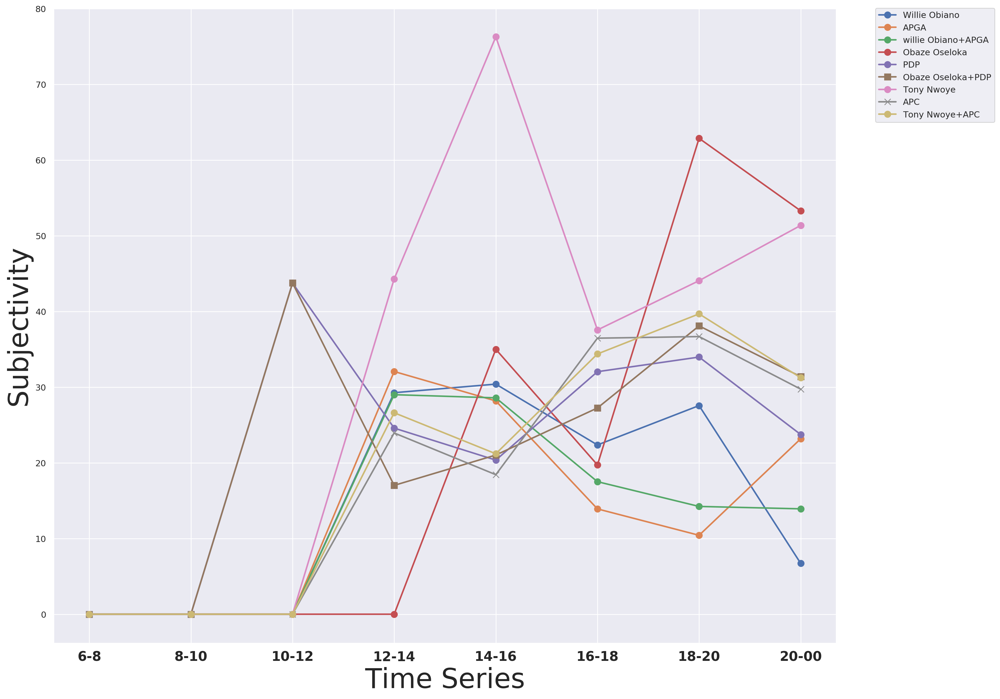

In [219]:
#Plot a line graph
d1 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'Willie Obiano']
d2 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'APGA']
d3 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'willie Obiano+APGA']
d4 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'Obaze Oseloka']
d5 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'PDP']
d6 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'Obaze Oseloka+PDP']
d7 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'Tony Nwoye']
d8 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'APC']
d9 = [sc[0] for sc in list_of_subj_plots if sc[1] == 'Tony Nwoye+APC']
x = ['6-8','8-10','10-12','12-14','14-16','16-18','18-20','20-00']
# x = ['6-7','7-8','8-9','9-10','10-11','11-12','12-13','13-14','14-15','15-16',
#      '16-17','17-18','18-19','19-20','20-21','21-22','22-00']
# Define plot space
fig, ax = plt.subplots(figsize=(18, 15))

# Define x and y axes
ax.plot(x, d1,'-o', label='Willie Obiano',linewidth=2,markersize=8)
ax.plot(x, d2,'-o', label='APGA',linewidth=2,markersize=8)
ax.plot(x, d3,'-o', label='willie Obiano+APGA',linewidth=2,markersize=8)
ax.plot(x, d4,'-o', label='Obaze Oseloka',linewidth=2,markersize=8)
ax.plot(x, d5,'-o', label='PDP',linewidth=2,markersize=8)
ax.plot(x, d6,'-s', label='Obaze Oseloka+PDP',linewidth=2,markersize=8)
ax.plot(x, d7,'-o', label='Tony Nwoye',linewidth=2,markersize=8)
ax.plot(x, d8,'-x', label='APC',linewidth=2,markersize=8)
ax.plot(x, d9,'-o', label='Tony Nwoye+APC',linewidth=2,markersize=8)

ax.set_xticks(x)
ax.set_xticklabels(x,fontsize=17,fontweight='bold')
# plt.title('My title')
plt.xlabel('Time Series',fontsize=35)
plt.ylabel('Subjectivity',fontsize=35)

leg = ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.);

In [220]:
# dfs = [(time_series_data_wo_only,'Willie Obiano'),(time_series_data_apga_only,'APGA'),(time_series_data_apga_wo_only,'willie Obiano+APGA'),
#        (time_series_data_obaze_only,'Obaze Oseloka'),(time_series_data_pdp_only,'PDP'),(time_series_data_pdp_obaze_only,'Obaze Oseloka+PDP'),
#       (time_series_data_tony_only,'Tony Nwoye'),(time_series_data_apc_only,'APC'),(time_series_data_apc_tony_only,'Tony Nwoye+APC')]

# t = [
#         ('2017-11-18 06:00:00','2017-11-18 08:00:00','6-8'),
#         ('2017-11-18 08:00:00','2017-11-18 10:00:00','8-10'),
#         ('2017-11-18 10:00:00','2017-11-18 12:00:00','10-12'),
#         ('2017-11-18 12:00:00','2017-11-18 14:00:00','12-14'),
#         ('2017-11-18 14:00:00','2017-11-18 16:00:00','14-16'),
#         ('2017-11-18 16:00:00','2017-11-18 18:00:00','16-18'),
#         ('2017-11-18 18:00:00','2017-11-18 20:00:00','18-20'),
#         ('2017-11-18 20:00:00','2017-11-18 23:59:59','20-00')
#     ]

# start_date = t[1][0]
# end_date = t[1][1]

# print(start_date,end_date)

In [221]:
# df_slice = dfs[3][0].loc[(dfs[3][0]['created_at'] > start_date) & (dfs[3][0]['created_at'] < end_date)]
# df_slice

In [222]:
# from nltk.corpus import stopwords

# content = ' '.join(df_slice["text"])
# content = re.sub(r"http\S+", "", content)
# content = content.replace('RT ', ' ').replace('&amp;', 'and')
# content = re.sub('[^A-Za-z0-9]+', ' ', content)
# content = content.lower()

# tokenized_word = word_tokenize(content)
# stop_words=set(stopwords.words("english"))
# stop_words.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
#                  'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita',
#                   'votes','vote'])

# filtered_sent=[]
# for w in tokenized_word:
#     if w not in stop_words:
#         filtered_sent.append(w)
# fdist = FreqDist(filtered_sent)
# fd = pd.DataFrame(fdist.most_common(15),                    \
#     columns = ["Word","Frequency"]).drop([0]).reindex()

# fig = px.bar(fd, x="Word", y="Frequency")
# fig.update_traces(marker_color='rgb(240,128,128)',          \
#     marker_line_color='rgb(8,48,107)',                      \
#     marker_line_width=1.5, opacity=0.8)
# fig.show()

In [223]:
# toks = df_slice['tweet_tokens']
# toks = " ".join(" ".join(t) for t in toks)
# print ("There are {} words in the combination of all tweets.".format(len(toks)))

# stopwords = set(STOPWORDS)
# stopwords.update(["https", "co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
#                  'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','peter','obi','chidoka_osita',
#                   'votes','vote','apgahq','anambradecides2017','officialpdpnig'])

# # Generate a word cloud image
# wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(toks)

# # Display the generated image:
# # the matplotlib way:
# plt.figure( figsize=(20,10) )
# # plt.title("Most Frequent Words Associated with Chidoka Osita Cum his Party UDP", fontsize=35)
# plt.imshow(wordcloud, interpolation='bilinear')
# plt.axis("off")
# plt.show()

In [224]:
from collections import Counter

for k,v in dic_words.items():
    key = k.split()
    if key[-1] == '6-8':
        if len(key) > 2:
            print(" ".join(key[:2]))
        else:
            print(key[0])
    

Obaze Oseloka+PDP


In [225]:
dic_words

defaultdict(list,
            {'Willie Obiano 12-14': ['breaches',
              'electoral',
              'law',
              'addresses',
              'centre',
              'guber',
              'win',
              'landslide',
              'victory',
              'breaches',
              'electoral',
              'law',
              'addresses',
              'centre',
              'candidate',
              'gov',
              'cast',
              'around',
              '1',
              '00',
              'pm',
              'confident',
              'remaining',
              'candidate',
              'gov',
              'cast',
              'around',
              '1',
              '00',
              'pm',
              'confident',
              'remaining',
              'news',
              'urges',
              'come',
              'decries',
              'inec',
              'late',
              'arrival',
              'ihiala',
              

In [226]:
wlist = set()
for k,v in dic_words.items():
    vdic = Counter(v)
    vdic = sorted(vdic.items(), key=lambda item: item[1],reverse=True)[:5]
    for w,sc in vdic:
        wlist.add(w)

In [227]:
wordlist = list(wlist)
len(wordlist)
wordlist

83

['going',
 'celebrate',
 'hqnigerianarmy',
 'results',
 'casts',
 'incidents',
 'average',
 'pleads',
 'inec',
 'centre',
 'jonathan',
 'credible',
 'addresses',
 'card',
 'manipulated',
 'win',
 'pics',
 'today',
 'early',
 'ojukwu',
 'questionable',
 'go',
 'photos',
 'police',
 'gt',
 'one',
 'ran',
 'tracking',
 'much',
 'know',
 'news',
 'buying',
 'readers',
 'ipob',
 'nsugbe',
 'nkem',
 'next',
 '1',
 'gubernatorial',
 'result',
 'yet',
 'victory',
 'involved',
 'wins',
 'tampering',
 'decides',
 'electoral',
 'winning',
 'spokesman',
 'refuse',
 'deputy',
 'confident',
 'fyi',
 'breaches',
 'photo',
 'celebrates',
 'pls',
 'williemobiano',
 'anticipated',
 'guber',
 'okeke',
 'agulu',
 'shares',
 'coasting',
 'breaking',
 'rice',
 'law',
 'state',
 'bianca',
 'give',
 'malfunctioning',
 'candidate',
 'governorship',
 'poll',
 'hard',
 'two',
 'elections',
 'policeng',
 'inecnigeria',
 'peacefully',
 'says',
 'people',
 'decries']

In [228]:
df_dic = defaultdict(list)

for k,v in dic_words.items():
    vdic = Counter(v)
#     print(k,'===========')
    for w in wlist:
        if w in vdic:
#             print(w,vdic[w])
            df_dic[k].append(vdic[w])
        else:
#             print(w,0)
           df_dic[k].append(0)
        

In [229]:
df_dic

defaultdict(list,
            {'Willie Obiano 12-14': [0,
              0,
              0,
              0,
              0,
              0,
              0,
              0,
              7,
              16,
              0,
              0,
              19,
              13,
              0,
              10,
              0,
              2,
              0,
              0,
              0,
              0,
              4,
              0,
              0,
              0,
              0,
              0,
              0,
              0,
              4,
              0,
              9,
              2,
              0,
              0,
              0,
              2,
              0,
              0,
              0,
              11,
              0,
              0,
              0,
              10,
              28,
              0,
              0,
              0,
              0,
              6,
              0,
              17,
              0,
              0,

In [230]:
df_dic['Willie Obiano 10-12']

[]

In [231]:
wordlist=list(wlist)

In [232]:
df_heatman = pd.DataFrame.from_dict(df_dic, orient='index',columns=wordlist)
df_heatman

,going,celebrate,hqnigerianarmy,results,casts,incidents,average,pleads,inec,centre,...,poll,hard,two,elections,policeng,inecnigeria,peacefully,says,people,decries
Willie Obiano 12-14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,16.0,...,0.0,0.0,0.0,4.0,1.0,1.0,0.0,4.0,1.0,6.0
Willie Obiano 14-16,0.0,0.0,0.0,7.0,1.0,0.0,0.0,0.0,0.0,20.0,...,4.0,0.0,0.0,0.0,0.0,1.0,0.0,6.0,7.0,0.0
Willie Obiano 16-18,0.0,0.0,0.0,5.0,6.0,0.0,0.0,0.0,2.0,6.0,...,5.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,1.0
Willie Obiano 18-20,0.0,17.0,0.0,17.0,1.0,0.0,0.0,0.0,0.0,1.0,...,4.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,3.0,0.0
Willie Obiano 20-00,1.0,2.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,1.0
APGA 12-14,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0
APGA 14-16,0.0,0.0,1.0,11.0,0.0,0.0,0.0,0.0,5.0,0.0,...,11.0,0.0,0.0,4.0,3.0,4.0,0.0,0.0,1.0,10.0
APGA 16-18,0.0,0.0,0.0,34.0,0.0,0.0,0.0,0.0,0.0,0.0,...,27.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,63.0
APGA 18-20,0.0,1.0,0.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,...,6.0,0.0,0.0,3.0,0.0,1.0,0.0,4.0,0.0,3.0
APGA 20-00,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,2.0


In [233]:
# df1,df2,df3,df4,df5,df6,df7,df8 = np.array_split(df_heatman, 8)
df1,df2,df3 = np.array_split(df_heatman, 3)

In [234]:
dff1=df1.loc[:, (df1 != 0).any()]
dff1wl = []
for col in dff1.columns: 
    dff1wl.append(col) 

In [235]:
dff2=df2.loc[:, (df2 != 0).any()]
dff2wl = []
for col in dff2.columns: 
    dff2wl.append(col)

In [236]:
dff3=df3.loc[:, (df3 != 0).any()]
dff3wl = []
for col in dff3.columns: 
    dff3wl.append(col)

In [237]:
# dff4=df4.loc[:, (df4 != 0).any()]
# dff4wl = []
# for col in dff4.columns: 
#     dff4wl.append(col)

In [238]:
# # Libraries
# import seaborn as sns

# # plot
# sns.clustermap(df_heatman, metric="correlation", method="single", cmap="Blues", linewidths=.1,standard_scale=1)

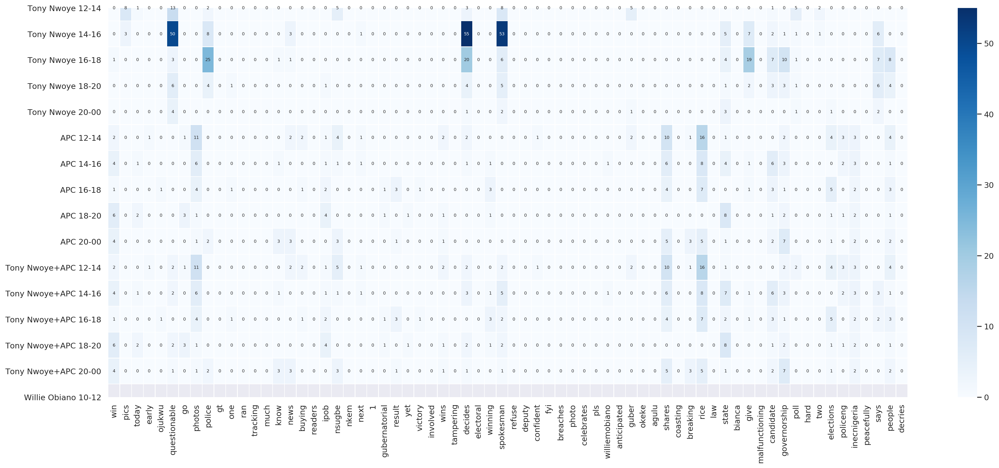

In [239]:
fig, ax = plt.subplots(figsize=(25,10))         # Sample figsize in inches
sns.heatmap(dff3[dff3wl[15:100]],cbar=True, cmap='Blues',linewidths=.5, annot=True,annot_kws={"size": 6},ax=ax)
sns.set(font_scale=1.4)

In [240]:
df=pd.DataFrame(np.random.random((7,7)),columns=['a','b','c','d','e','f','g'])
df

,a,b,c,d,e,f,g
0,0.566482,0.522306,0.526517,0.066308,0.500779,0.643330,0.012138
1,0.685910,0.176784,0.710560,0.777129,0.247435,0.954518,0.559435
2,0.736748,0.477539,0.862775,0.062224,0.754279,0.659075,0.758592
3,0.030701,0.476068,0.612726,0.519275,0.492722,0.533465,0.556017
4,0.910220,0.536552,0.678496,0.190804,0.333866,0.699149,0.059307
5,0.352657,0.514068,0.870251,0.160995,0.246814,0.456856,0.613064
6,0.283689,0.174817,0.255737,0.188422,0.420782,0.529199,0.425170


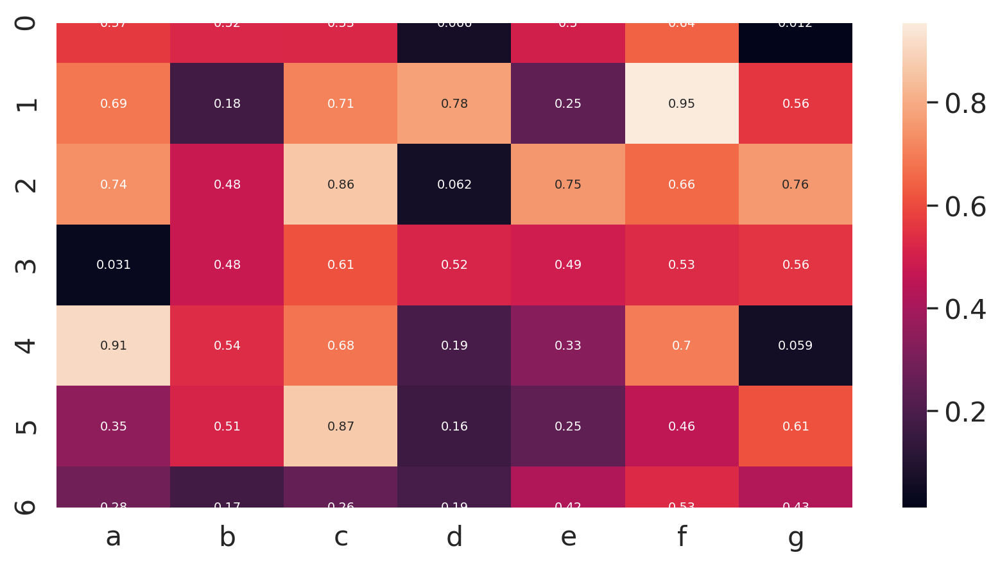

In [241]:
sns.heatmap(df,annot=True,annot_kws={'size':7})

# Topic Modelling with Latent Dirichlet Allocation (LDA)

In [242]:
from nltk.tokenize import RegexpTokenizer
from stop_words import get_stop_words
from nltk.stem.porter import PorterStemmer
from gensim import corpora, models
from gensim import corpora, models

%matplotlib inline
import pyLDAvis
import pyLDAvis.gensim

tokenizer = RegexpTokenizer(r'\w+')

In [243]:
newstops = ["https","co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','chidoka_osita',
                  'votes','voter','voters','vote','governor','oselokahobaze','officialpdpnig','apcnigeria','anambranews','voters',
                   'polling','poling','unit','ward','apgahq','2','6','anambradecides2017','s','t']

In [244]:
# create English stop words list
en_stop = get_stop_words('en')+newstops

# Create p_stemmer of class PorterStemmer
p_stemmer = PorterStemmer()

In [245]:
# dfs = [(time_series_data_wo_only,'Willie Obiano'),(time_series_data_apga_only,'APGA'),(time_series_data_apga_wo_only,'willie Obiano+APGA'),
#        (time_series_data_obaze_only,'Obaze Oseloka'),(time_series_data_pdp_only,'PDP'),(time_series_data_pdp_obaze_only,'Obaze Oseloka+PDP'),
#       (time_series_data_tony_only,'Tony Nwoye'),(time_series_data_apc_only,'APC'),(time_series_data_apc_tony_only,'Tony Nwoye+APC')]

In [246]:
df_lda = time_series_data_apc_only[['id','date','text']]

In [247]:
def strip_links(text):
    link_regex    = re.compile(r'((https?):((//)|(\\\\))+([\w\d:#@%/;$()~_?\+-=\\\.&](#!)?)*)', re.DOTALL)
    links         = re.findall(link_regex, text)
    for link in links:
        text = text.replace(link[0], ', ')    
    return text

def strip_all_entities(text):
    entity_prefixes = ['@','#']
    for separator in  string.punctuation:
        if separator not in entity_prefixes :
            text = text.replace(separator,' ')
    words = []
    for word in text.split():
        word = word.strip()
        if word:
            if word[0] not in entity_prefixes:
                words.append(word)
    return ' '.join(words)

emoji_pattern = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           "]+", flags=re.UNICODE)

In [248]:
tweet_texts = df_lda['text'].tolist()

In [249]:
df_lda['text_strip'] = [emoji_pattern.sub(r'',strip_all_entities(strip_links(t))) for t in tweet_texts]

/home/iykeln/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [250]:
df_lda[['apga','pdp','apc','willie_obiano','oseloka_obaze',
                    'nwoye_tony','willie_obiano_apga','oseloka_obaze_pdp', 'nwoye_tony_apc',
                    'Sentiment_Polarity','Sentiment_Subjectivity', 'Sentiment_Polarity_Vals',
                    'Sentiment_Subjectivity_Vals']] = time_series_data_apc_only[['apga','pdp','apc','willie_obiano','oseloka_obaze',
                    'nwoye_tony','willie_obiano_apga','oseloka_obaze_pdp', 'nwoye_tony_apc',
                    'Sentiment_Polarity','Sentiment_Subjectivity', 'Sentiment_Polarity_Vals',
                    'Sentiment_Subjectivity_Vals']]

/home/iykeln/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:3494: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [251]:
# create sample documents
# compile sample documents into a list

doc_set = df_lda['text_strip'].tolist()

In [252]:
# list for tokenized documents in loop
texts = []

# loop through document list
for i in doc_set:
    
    # clean and tokenize document string
    raw = i.lower()
    tokens = tokenizer.tokenize(raw)

    # remove stop words from tokens
    stopped_tokens = [i for i in tokens if not i in en_stop]
    
    # stem tokens
    stemmed_tokens = [p_stemmer.stem(i) for i in stopped_tokens]
    
    # add tokens to list
    texts.append(stopped_tokens)

# First LDA Experiment ...

In [253]:
# turn our tokenized documents into a id <-> term dictionary
LDA_dictionary = corpora.Dictionary(texts)

# Filter out words that occur less than 20 documents, or more than 50% of the documents.
#We remove rare words and common words based on their document frequency. 
#Below we remove words that appear in less than 20 documents or in more than 50% of the documents. 
#Consider trying to remove words only based on their frequency, or maybe combining that with this approach.
LDA_dictionary.filter_extremes(no_below=1, no_above=0.8)
    
# convert tokenized documents into a document-term matrix
corpus = [LDA_dictionary.doc2bow(text) for text in texts]

In [254]:
# generate LDA model
# num_topics = 20
# %time lda_model = models.LdaModel(corpus, num_topics=num_topics, \
#                                   id2word=LDA_dictionary, \
#                                   passes=4, alpha=[0.01]*num_topics, \
#                                   eta=[0.01]*len(LDA_dictionary.keys()))

# Set training parameters.
num_topics = 10
chunksize = 200
passes = 20
iterations = 100
eval_every = None  # Don't evaluate model perplexity, takes too much time.

%time lda_model = models.LdaModel(corpus=corpus,\
                                    id2word=LDA_dictionary,\
                                    chunksize=chunksize,\
                                    alpha='auto',\
                                    eta='auto',\
                                    iterations=iterations,\
                                    num_topics=num_topics,\
                                    passes=passes,\
                                    eval_every=eval_every)


CPU times: user 605 ms, sys: 109 µs, total: 606 ms
Wall time: 672 ms


In [255]:
for i,topic in lda_model.show_topics(formatted=True, num_topics=num_topics, num_words=10):
    print(str(i)+": "+ topic)
    print()

0: 0.019*"win" + 0.019*"go" + 0.013*"news" + 0.013*"breaking" + 0.013*"results" + 0.013*"never" + 0.013*"rig" + 0.013*"money" + 0.013*"know" + 0.007*"n"

1: 0.117*"rice" + 0.103*"photos" + 0.096*"shares" + 0.041*"elections" + 0.015*"cooked" + 0.014*"result" + 0.013*"sharing" + 0.009*"inec" + 0.009*"can" + 0.009*"coming"

2: 0.025*"cooked" + 0.023*"win" + 0.022*"rice" + 0.020*"just" + 0.020*"abito" + 0.020*"agents" + 0.020*"illo" + 0.020*"distributing" + 0.020*"let" + 0.013*"square"

3: 0.018*"governorship" + 0.018*"candidate" + 0.014*"buhari" + 0.014*"can" + 0.014*"results" + 0.014*"must" + 0.014*"state" + 0.014*"dog" + 0.014*"spotted" + 0.014*"banner"

4: 0.044*"boycott" + 0.037*"update" + 0.037*"devastating" + 0.037*"ogbaru" + 0.037*"picked" + 0.037*"chiarman" + 0.030*"biafra" + 0.015*"declared" + 0.015*"kags" + 0.008*"d"

5: 0.025*"buhari" + 0.017*"won" + 0.017*"people" + 0.017*"eneukwu" + 0.017*"visit" + 0.017*"guber" + 0.017*"chances" + 0.017*"boost" + 0.009*"treatment" + 0.009*"f

In [256]:
doc_set[0]

'Apc is allegedly sharing food and money  to voters to buy their votes they must really want anambra so bad'

In [257]:
lda_model[corpus[0]] # corpus[0] means the first document.

[(2, 0.9533849)]

In [258]:
willie_df = df_lda.loc[df_lda['apga'] == True]
new_text = willie_df['text_strip'].tolist()

In [259]:
for t in new_text:
    tokens = [p_stemmer.stem(token) for token in tokenizer.tokenize(t.lower()) if token not in en_stop]
    lda_model[LDA_dictionary.doc2bow(tokens)]
    t

[(0, 0.01766517),
 (1, 0.031701624),
 (2, 0.8223404),
 (3, 0.021665044),
 (4, 0.01853441),
 (5, 0.016111987),
 (6, 0.020356359),
 (7, 0.019658346),
 (8, 0.015746212),
 (9, 0.016220381)]

'They should collect the mon …'

[(1, 0.014378988), (5, 0.7359827), (7, 0.19097556)]

'Foolish people this was the reason why took power from …'

[(1, 0.014378779), (3, 0.9205623)]

'if like let them share more than 2 k Anambra is and is Anambra Case closed'

[(1, 0.017582526),
 (2, 0.23330471),
 (3, 0.23465768),
 (4, 0.45579875),
 (6, 0.011290154),
 (7, 0.010903018)]

'APC was destined to lose in Anambra all the way Too many cases of vote buying When will Nigerians change'

[(0, 0.012603432),
 (1, 0.022617912),
 (2, 0.013660819),
 (3, 0.015457191),
 (4, 0.8728094),
 (5, 0.011495294),
 (6, 0.014523494),
 (7, 0.014025487),
 (8, 0.011234327),
 (9, 0.01157263)]

'kags Boycott is not d same with Disruption IPOB declared …'

[(0, 0.08975896),
 (1, 0.16107996),
 (2, 0.09728945),
 (3, 0.11008282),
 (4, 0.09417568),
 (5, 0.08186704),
 (6, 0.10343324),
 (7, 0.09988654),
 (8, 0.080008484),
 (9, 0.08241781)]

'kags is as the he Declared was …'

[(0, 0.9006541),
 (1, 0.017580668),
 (2, 0.010618413),
 (3, 0.012014714),
 (4, 0.010278568),
 (6, 0.01128896),
 (7, 0.010901866)]

'is wining go to hell and die and owns Anambra State'

[(1, 0.017580591),
 (2, 0.010618326),
 (3, 0.012014615),
 (4, 0.010278484),
 (5, 0.8997934),
 (6, 0.011288868),
 (7, 0.010901776)]

'I have the feeling that both and won t mind if wins Anambra What they won t to …'

[(0, 0.012603315),
 (1, 0.0226177),
 (2, 0.013660692),
 (3, 0.015457045),
 (4, 0.013223478),
 (5, 0.011495186),
 (6, 0.014523358),
 (7, 0.87361246),
 (8, 0.011234222),
 (9, 0.011572522)]

'No way for in Anambra State or But no way'

[(0, 0.029520113),
 (1, 0.052977655),
 (2, 0.031996757),
 (3, 0.7073208),
 (4, 0.030972691),
 (5, 0.0269246),
 (6, 0.034017336),
 (7, 0.032850888),
 (8, 0.026313355),
 (9, 0.02710574)]

'Can someone authenticate this …'

[(0, 0.0176653),
 (1, 0.03170186),
 (2, 0.019147363),
 (3, 0.021665204),
 (4, 0.42010096),
 (5, 0.016112106),
 (6, 0.020356512),
 (7, 0.42128384),
 (8, 0.015746327),
 (9, 0.016220503)]

'It s better than in Anambra State'

[(0, 0.7306711), (1, 0.20245606)]

'Base on the available results hardly to win the Anambra Election against we still await the to announce'

In [260]:
# vis = pyLDAvis.gensim.prepare(topic_model=lda_model, corpus=corpus, dictionary=LDA_dictionary)
# pyLDAvis.enable_notebook()
# pyLDAvis.display(vis)

# Second LDA Experiment ...

In [261]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer,TfidfTransformer
from nltk.stem.snowball import SnowballStemmer
from nltk import PorterStemmer as pstemmer
import Stemmer
import lda as LDA
from sklearn import decomposition
from time import time

In [262]:
df_lda

,id,date,text,text_strip,apga,pdp,apc,willie_obiano,oseloka_obaze,nwoye_tony,willie_obiano_apga,oseloka_obaze_pdp,nwoye_tony_apc,Sentiment_Polarity,Sentiment_Subjectivity,Sentiment_Polarity_Vals,Sentiment_Subjectivity_Vals
18,931857140326846464,Sat Nov 18 12:10:29 +0000 2017,Apc is allegedly sharing food and money 💰 to v...,Apc is allegedly sharing food and money to vo...,False,False,True,False,False,False,False,False,True,-0.20,0.322222,1,2
95,931859019152707584,Sat Nov 18 12:17:57 +0000 2017,APC = Anambra People's Cook . @nnekei @NGRWail...,APC Anambra People s Cook chidoka …,False,True,True,False,True,False,False,True,True,0.00,0.000000,0,0
148,931860304870350848,Sat Nov 18 12:23:04 +0000 2017,Anambra Election : APC Shares Rice To Voters (...,Anambra Election APC Shares Rice To Voters Photos,False,False,True,False,False,False,False,False,True,0.00,0.000000,0,0
164,931860310113206273,Sat Nov 18 12:23:05 +0000 2017,BIAFRA : ANAMBRA ELECTION UPDATE : OGBARU APC ...,BIAFRA ANAMBRA ELECTION UPDATE OGBARU APC CHIA...,False,False,True,False,False,False,False,False,True,-1.00,1.000000,1,2
173,931860305998577665,Sat Nov 18 12:23:04 +0000 2017,BIAFRA : ANAMBRA ELECTION UPDATE : OGBARU APC ...,BIAFRA ANAMBRA ELECTION UPDATE OGBARU APC CHIA...,False,False,True,False,False,False,False,False,True,-1.00,1.000000,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7213,932010327138385921,Sat Nov 18 22:19:12 +0000 2017,"Breaking News : Police DIG , INEC , APC Begins...",Breaking News Police DIG INEC APC Begins Re Wr...,False,False,True,False,False,False,False,False,True,0.75,1.000000,2,2
7317,932014952365338624,Sat Nov 18 22:37:35 +0000 2017,"Breaking News : Police DIG , INEC APC Begins R...",Breaking News Police DIG INEC APC Begins Re Wr...,False,False,True,False,False,False,False,False,True,0.00,0.000000,0,0
7336,932015862378389505,Sat Nov 18 22:41:12 +0000 2017,"Erection with No Lefelendum , meanwhile where ...",Erection with No Lefelendum meanwhile where di...,False,False,True,False,False,False,False,False,True,0.00,0.000000,0,0
7359,932016881355116544,Sat Nov 18 22:45:15 +0000 2017,APC is a no no https://t.co/KU4ZvvM6Bz,APC is a no no,False,False,True,False,False,False,False,False,True,0.00,0.000000,0,0


In [263]:
newstops = ["https","co",'will','anambra','election','nwoye','tony','obiano','willie','obaze','oseloka',
                 'godwin','ezeemo','chidoka','osita','apga','apc','pdp','ppa','udp','chidoka_osita',
                  'votes','voter','voters','vote','governor','oselokahobaze','officialpdpnig','apcnigeria','anambranews','voters',
                   'polling','poling','unit','ward','apgahq','2','6','anambradecides2017','s','t','inec','ipob',
           'biafra','biafran','poll']

punc = list("!\"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~£€«»–—’…")
stopwords = nltk.corpus.stopwords.words('english')+punc+['anambra']

#stemming technologies
stemmer = SnowballStemmer("english")
english_stemmer = Stemmer.Stemmer('en')
pstemmer = PorterStemmer()

In [264]:
tot_w = []
for thread in df_lda.text_strip:
    for w in thread.split():
        if w not in punc:
            tot_w.append(w.lower())
tot_count = len(tot_w)
w_count = Counter(tot_w)

In [265]:
len(tot_w)

2304

In [266]:
len(w_count)

671

In [267]:
#Feature Selection for LDA.
n_features = 320000
class StemmedTfidfVectorizer(TfidfVectorizer):
     def build_analyzer(self):
        analyzer = super(TfidfVectorizer, self).build_analyzer()
        return lambda doc: english_stemmer.stemWords(analyzer(doc))

In [268]:
#tvec = TfidfVectorizer(min_df=3, max_df=0.90, stop_words='english')
tvec = StemmedTfidfVectorizer(min_df=3, max_df=0.90, stop_words=stopwords, analyzer='word')

In [269]:
dtm_tfidf = tvec.fit_transform(df_lda.text_strip)

In [270]:
vocabs = np.array(tvec.get_feature_names())    #This is a vocabulary

In [271]:
dtm_tfidf.shape

(168, 82)

In [272]:
len(vocabs)

82

In [273]:
# class StemmedCountVectorizer(CountVectorizer):
#      def build_analyzer(self):
#         analyzer = super(CountVectorizer, self).build_analyzer()
#         return lambda doc: english_stemmer.stemWords(analyzer(doc))

In [274]:
#vectorizer = CountVectorizer(min_df=3, max_df=99.8, max_features=n_features,stop_words='english')
# vectorizer = StemmedCountVectorizer(min_df=5, max_df=70, max_features=n_features,stop_words=stopwords, analyzer='word')

In [275]:
# dtm_tf = vectorizer.fit_transform(df_lda.text_strip)

In [276]:
# vocabs = np.array(vectorizer.get_feature_names())

In [277]:
# dtm_tf.shape

In [278]:
# len(vocabs)

In [279]:
#fitting the models
n_topics = 10
n_top_words = 10

In [280]:
print("Fitting LDA models with tf-idf/tf features")

lda = decomposition.LatentDirichletAllocation(n_components=n_topics, 
#                                                 max_iter=20,
                                                verbose=1, 
                                                evaluate_every=1,
                                                learning_method='online',
                                                learning_offset=50.,
                                                random_state=1)

# lda = LDA.LDA(n_topics=n_topics,n_iter=100,random_state=1)

t0 = time()
lda_model = lda.fit(dtm_tfidf)

print("done in %0.3fs." % (time() - t0))

Fitting LDA models with tf-idf/tf features
iteration: 1 of max_iter: 10, perplexity: 5920.0609
iteration: 2 of max_iter: 10, perplexity: 4155.8744
iteration: 3 of max_iter: 10, perplexity: 3176.3254
iteration: 4 of max_iter: 10, perplexity: 2568.8134
iteration: 5 of max_iter: 10, perplexity: 2139.2734
iteration: 6 of max_iter: 10, perplexity: 1809.6787
iteration: 7 of max_iter: 10, perplexity: 1555.8198
iteration: 8 of max_iter: 10, perplexity: 1358.7697
iteration: 9 of max_iter: 10, perplexity: 1197.7918
iteration: 10 of max_iter: 10, perplexity: 1064.2838
done in 0.494s.


In [281]:
doctopic_lda = lda.transform(dtm_tfidf)

##### To make the analysis and visualization of models components - topic proportions, we will scale the document-component matrix such that the component values associated with each document sum to one.¶

In [282]:
# print words associated with topics
topic_words = []  
for topic in lda_model.components_:
    word_idx = np.argsort(topic)[::-1][0:n_top_words]
    topic_words.append([vocabs[i] for i in word_idx])

In [283]:
#Printing topic ids and list of associated words
for t in range(len(topic_words)):
    print("{} & {} & \\\\".format(t, ' '.join(topic_words[t][:13])))

0 & know let money state apc member facebook abuja boycott inec & \\
1 & apc elect win share voter rice photo vote governorship candid & \\
2 & peopl bribe voter cook apc happen obvious agent done money & \\
3 & abito agent illo distribut cook nsugb rice spot apc money & \\
4 & inec result break news apc rig write go must never & \\
5 & good result campaign spot banner apc dog poll unit state & \\
6 & state visit decid vote go inec apc buhari way true & \\
7 & plate take elect nsugb apc jollof boycott ndi governorship declar & \\
8 & candid governorship make true like peopl cook rice peac share & \\
9 & second apc way buhari illo jollof like candid write spot & \\


In [284]:
sum(doctopic_lda[9])

1.0000000000000002

#### Analysis and Visualization

In [285]:
#scale the document-component matrix such that the component values associated with each document sum to one
doctopic_lda = doctopic_lda / np.sum(doctopic_lda, axis=1, keepdims=True)

In [286]:
#display scores of each topic per post. rows are posts and cols are topics
doctopic_orig = doctopic_lda.copy() #copy the array to keep original

In [287]:
doctopic_orig[0,:]

array([0.02716044, 0.75555742, 0.02715974, 0.02715848, 0.02717565,
       0.02715708, 0.02715732, 0.02715818, 0.02715796, 0.02715771])

In [288]:
doctopic_orig.shape #gives total number of posts and number of topics

(168, 10)

In [289]:
doc_names = [pid for pid in df_lda.index] #list of all the posts.

In [290]:
len(doc_names) #total number of posts

168

In [291]:
df_tweets_topics = pd.DataFrame(doctopic_lda, index=doc_names)

In [292]:
df_tweets_topics

,0,1,2,3,4,5,6,7,8,9
18,0.027160,0.755557,0.027160,0.027158,0.027176,0.027157,0.027157,0.027158,0.027158,0.027158
95,0.038422,0.038442,0.654180,0.038425,0.038424,0.038421,0.038421,0.038424,0.038421,0.038422
148,0.029609,0.733509,0.029610,0.029610,0.029610,0.029610,0.029609,0.029614,0.029610,0.029609
164,0.025899,0.025901,0.025899,0.025899,0.025899,0.025899,0.025899,0.766907,0.025899,0.025899
173,0.025899,0.025901,0.025899,0.025899,0.025899,0.025899,0.025899,0.766907,0.025899,0.025899
...,...,...,...,...,...,...,...,...,...,...
7213,0.031884,0.031886,0.031884,0.031884,0.713040,0.031885,0.031884,0.031884,0.031884,0.031884
7317,0.029982,0.029985,0.029982,0.029982,0.730158,0.029983,0.029982,0.029982,0.029982,0.029982
7336,0.038305,0.655255,0.038304,0.038304,0.038310,0.038304,0.038307,0.038304,0.038304,0.038304
7359,0.050003,0.549976,0.050003,0.050001,0.050006,0.050002,0.050002,0.050006,0.050000,0.050002
